# Brain Tumor Classification from Mutli Sequence Structural MRI and Multimodal CT, MRI using EfficientNetV2B0 and Multi-Head Self Attention

- Authored by Satrajit Kar, MESE JU'25

## Preprocessing of MRI Scans

In [4]:
!pip install imutils

import numpy as np
from tqdm import tqdm
import cv2
import os
import imutils

def crop_img(img):
    """
    Finds the extreme points on the image and crops the rectangular out of them
    """
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    gray = cv2.GaussianBlur(gray, (3, 3), 0)

    # find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(gray.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)

    # find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    ADD_PIXELS = 0
    new_img = img[extTop[1]-ADD_PIXELS:extBot[1]+ADD_PIXELS, extLeft[0]-ADD_PIXELS:extRight[0]+ADD_PIXELS].copy()

    return new_img

if __name__ == "__main__":
    training = "/kaggle/input/brain-tumor-mri-images-44c"
    training_dir = os.listdir(training)
    IMG_SIZE = 224

    for dir in training_dir:
        save_path = '/kaggle/working/cleaned/'+ dir
        path = os.path.join(training,dir)
        image_dir = os.listdir(path)
        for img in image_dir:
            image = cv2.imread(os.path.join(path,img))
            new_img = crop_img(image)
            new_img = cv2.resize(new_img,(IMG_SIZE,IMG_SIZE))
            if not os.path.exists(save_path):
                os.makedirs(save_path)
            cv2.imwrite(save_path+'/'+img, new_img)

  Preparing metadata (setup.py) ... done
  Created wheel for imutils: filename=imutils-0.5.4-py3-none-any.whl size=25834 sha256=17b2e5e09c2fee5e142f3e692e36e7bcc21d0acb83dea4444334e771336a4bea
  Stored in directory: /root/.cache/pip/wheels/85/cf/3a/e265e975a1e7c7e54eb3692d6aa4e2e7d6a3945d29da46f2d7
Successfully built imutils


## Dataset 1 : 15 Class

In [2]:
import os
from PIL import Image
import itertools
from tqdm import tqdm
import cv2
import numpy as np 
import pandas as pd 
import seaborn as sn
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import regularizers
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam, Adamax
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import Dense, Flatten, Conv2D, MaxPooling2D, Activation, Dropout,BatchNormalization

import warnings
warnings.filterwarnings('ignore')

print('Modules Successfully Loaded')

Modules Successfully Loaded


In [3]:
data_dir ="/kaggle/working/cleaned"
paths = []
labels = []
folds = os.listdir(data_dir)
for fold in folds :
    condition_path = os.path.join(data_dir,fold)
    all_pic = os.listdir(condition_path)
    for each_pic in all_pic:
        each_pic_path = os.path.join(condition_path,each_pic)
        paths.append(each_pic_path)
        labels.append(fold.split(' ')[0])
        
pseries = pd.Series(paths, name='Picture Path')
lseries = pd.Series(labels, name='Label')

df = pd.concat([pseries, lseries], axis =1)

train_df, ts_df = train_test_split(df,test_size= 0.2,shuffle=True,random_state=42,stratify= df['Label'])
test_df, valid_df = train_test_split(ts_df,test_size= 0.5,shuffle=True,random_state=42,
                                          stratify= ts_df['Label'])

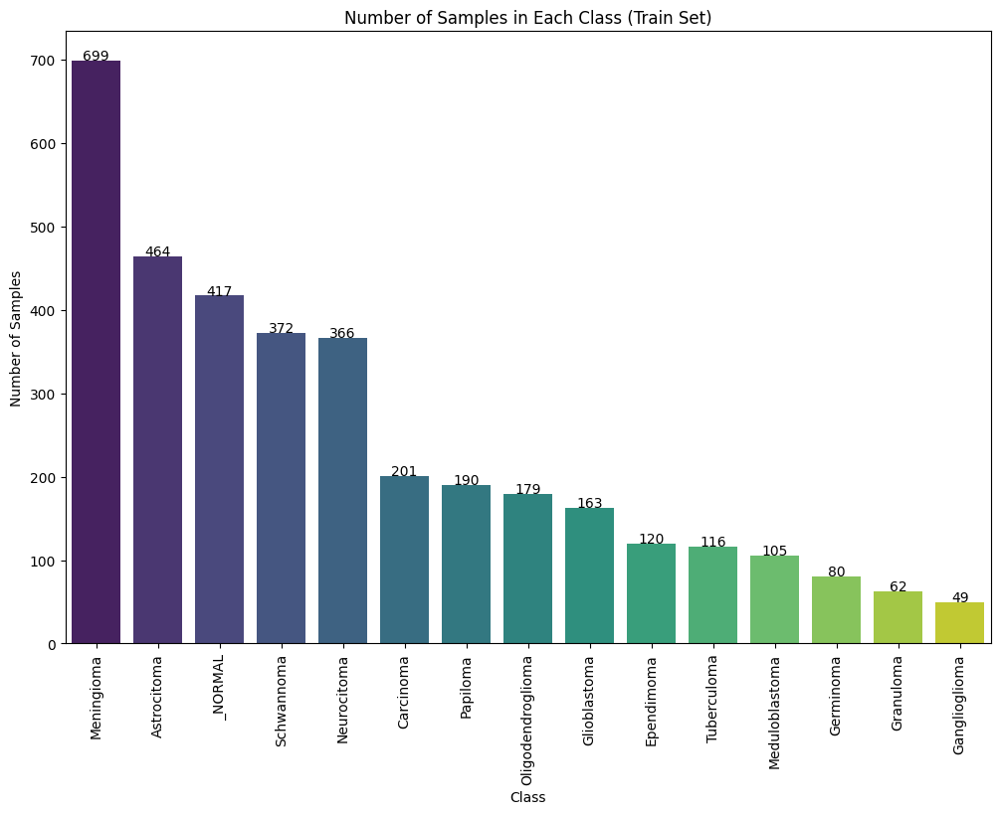

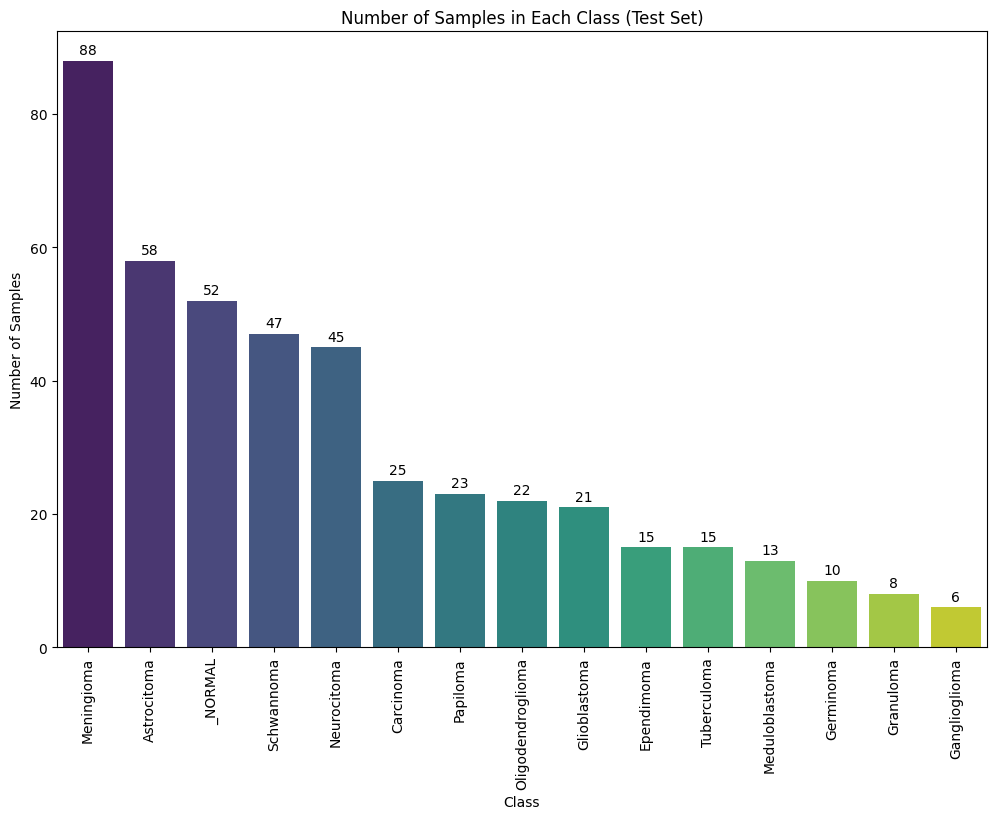

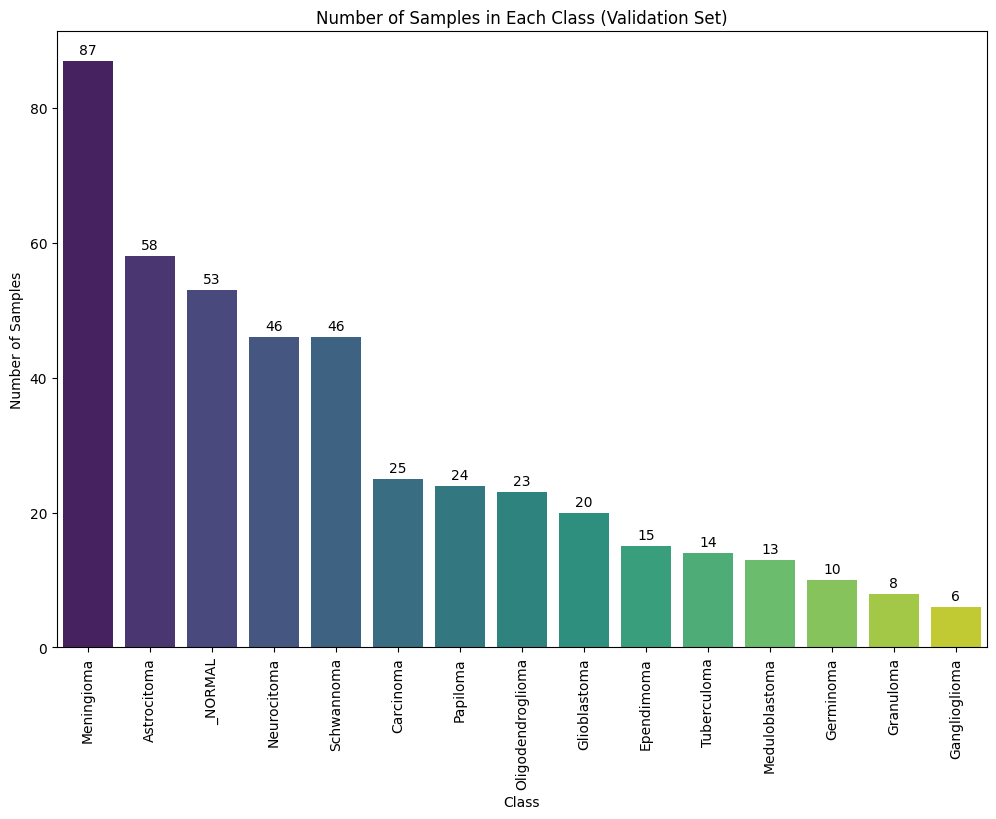

In [6]:
import matplotlib.pyplot as plt
import seaborn as sns

# Function to plot class distribution with numbers on top of the bars and vertical labels
def plot_class_distribution(df, title):
    class_counts = df['Label'].value_counts()
    plt.figure(figsize=(12, 8))
    
    sns.barplot(x=class_counts.index, y=class_counts.values, palette="viridis")
    plt.title(title)
    plt.xlabel('Class')
    plt.ylabel('Number of Samples')
    
    # Rotate class labels vertically
    plt.xticks(rotation=90)
    
    # Add number labels on top of bars
    for i in range(len(class_counts)):
        plt.text(i, class_counts.values[i] + 1, str(class_counts.values[i]), ha='center')
    
    plt.show()

# Plot class distributions for train_df, test_df, and valid_df
plot_class_distribution(train_df, 'Number of Samples in Each Class (Train Set)')
plot_class_distribution(test_df, 'Number of Samples in Each Class (Test Set)')
plot_class_distribution(valid_df, 'Number of Samples in Each Class (Validation Set)')

In [4]:
train_df

,Picture Path,Label
4375,/kaggle/working/cleaned/Tuberculoma T1C+/57._b...,Tuberculoma
4133,/kaggle/working/cleaned/Meduloblastoma T1C+/4a...,Meduloblastoma
869,/kaggle/working/cleaned/Astrocitoma T2/29_big_...,Astrocitoma
339,/kaggle/working/cleaned/Carcinoma T1/73._big_g...,Carcinoma
2585,/kaggle/working/cleaned/Neurocitoma T1C+/2022-...,Neurocitoma
...,...,...
792,/kaggle/working/cleaned/Oligodendroglioma T1/c...,Oligodendroglioma
1313,/kaggle/working/cleaned/Ependimoma T2/c43b54b4...,Ependimoma
73,/kaggle/working/cleaned/Neurocitoma T1/278cab9...,Neurocitoma
1276,/kaggle/working/cleaned/Ependimoma T2/57b14e12...,Ependimoma


In [5]:
valid_df

,Picture Path,Label
3742,/kaggle/working/cleaned/Schwannoma T1C+/d5e68b...,Schwannoma
3835,/kaggle/working/cleaned/Meningioma T1/2022-05-...,Meningioma
2418,/kaggle/working/cleaned/Oligodendroglioma T2/1...,Oligodendroglioma
2248,/kaggle/working/cleaned/Meningioma T1C+/3b56b2...,Meningioma
3817,/kaggle/working/cleaned/Meningioma T1/2022-05-...,Meningioma
...,...,...
3134,/kaggle/working/cleaned/Neurocitoma T2/035adcb...,Neurocitoma
1493,/kaggle/working/cleaned/Papiloma T1C+/2022-06-...,Papiloma
3537,/kaggle/working/cleaned/Astrocitoma T1C+/008_b...,Astrocitoma
3636,/kaggle/working/cleaned/Schwannoma T1C+/ce7d0b...,Schwannoma


In [6]:
test_df

,Picture Path,Label
485,/kaggle/working/cleaned/_NORMAL T1/961dd24d2ff...,_NORMAL
4166,/kaggle/working/cleaned/Meduloblastoma T1C+/90...,Meduloblastoma
2966,/kaggle/working/cleaned/_NORMAL T2/e9ce938c54c...,_NORMAL
3361,/kaggle/working/cleaned/Astrocitoma T1C+/9d6e6...,Astrocitoma
1773,/kaggle/working/cleaned/Astrocitoma T1/2022-06...,Astrocitoma
...,...,...
3428,/kaggle/working/cleaned/Astrocitoma T1C+/108_b...,Astrocitoma
4174,/kaggle/working/cleaned/Meduloblastoma T1C+/a2...,Meduloblastoma
1887,/kaggle/working/cleaned/Schwannoma T1/da6efc5b...,Schwannoma
1464,/kaggle/working/cleaned/Tuberculoma T1/cad38bd...,Tuberculoma


Found 3582 validated image filenames belonging to 15 classes.
Found 448 validated image filenames belonging to 15 classes.
Found 448 validated image filenames belonging to 15 classes.


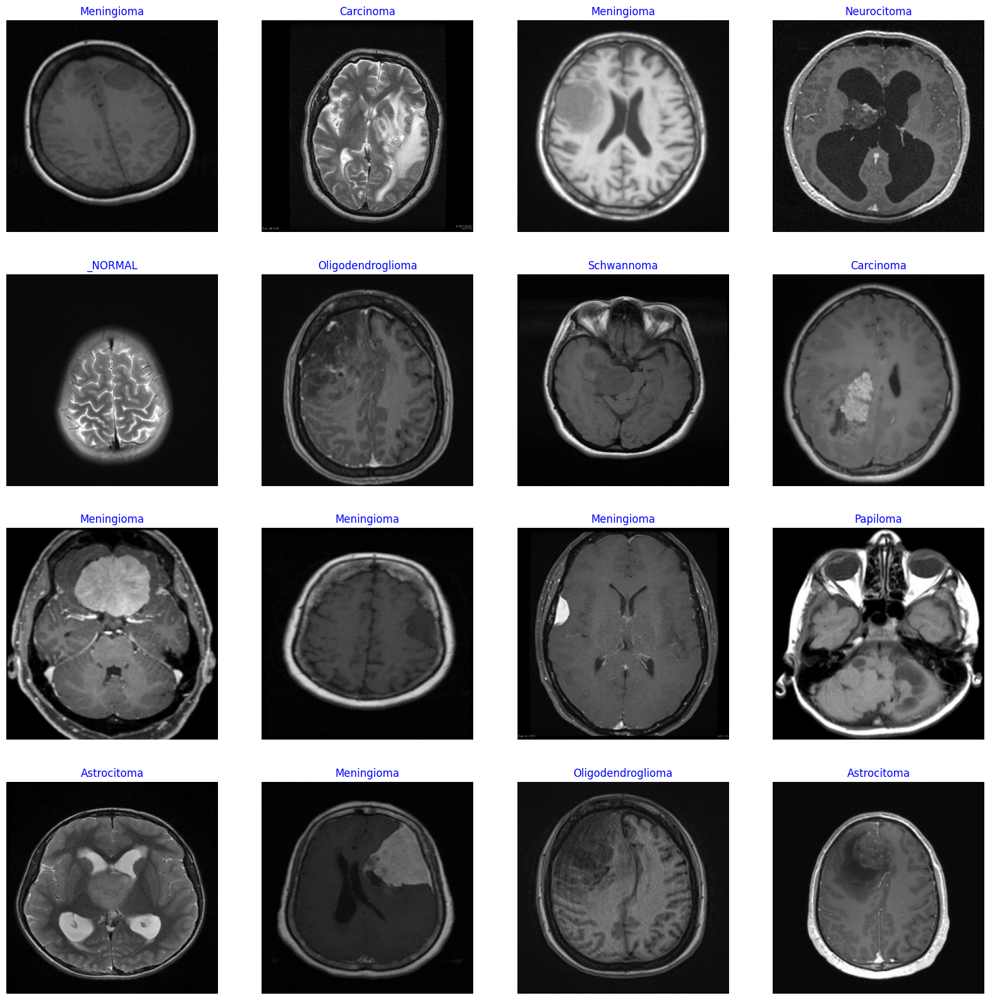

In [7]:
batch_size = 16
img_size = (224,224)

gen = ImageDataGenerator()

train_gen = gen.flow_from_dataframe(train_df, x_col='Picture Path', y_col='Label',target_size= img_size, 
                                   class_mode= 'categorical', color_mode='rgb', shuffle = True,
                                   batch_size= batch_size)

valid_gen = gen.flow_from_dataframe(valid_df, x_col='Picture Path', y_col='Label',target_size= img_size, 
                                   class_mode= 'categorical', color_mode='rgb', shuffle = True,
                                   batch_size= batch_size)

test_gen = gen.flow_from_dataframe(test_df, x_col='Picture Path', y_col='Label',target_size= img_size, 
                                   class_mode= 'categorical', color_mode='rgb', shuffle = False,
                                   batch_size= batch_size)
g_dict = train_gen.class_indices
classes= list(g_dict.keys())

images, labels = next(train_gen)

plt.figure(figsize= (20,20))

for i in range (16):
    plt.subplot(4,4,i+1)
    image = images[i] / 255
    plt.imshow(image)
    index= np.argmax(labels[i]) #[0,0,0,1,0]
    class_name = classes[index]
    plt.title(class_name,c='b', fontsize=12)
    plt.axis('off')
plt.show()

In [8]:
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.applications import EfficientNetV2B0
from tensorflow.keras.models import Model
from tensorflow.keras.layers import (
    GlobalAveragePooling2D, Dense, Dropout,
    BatchNormalization, GaussianNoise, Input,
    MultiHeadAttention, Reshape
)
from tensorflow.keras.optimizers import Adamax

# Check if GPU is availablere
physical_devices = tf.config.list_physical_devices('GPU')
if physical_devices:
    print("Using GPU")
else:
    print("Using CPU")

# Early stopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)

def create_model(input_shape, num_classes=15, learning_rate=0.0001):
    inputs = Input(shape=input_shape, name="Input_Layer")
    
    base_model = EfficientNetV2B0(weights='imagenet', input_tensor=inputs, include_top=False)
    
    x = base_model.output
    height, width, channels = x.shape[1], x.shape[2], x.shape[3]
    
    x = Reshape((height * width, channels), name="Reshape_to_Sequence")(x)
    
    attention_output = MultiHeadAttention(num_heads=8, key_dim=channels, name="Multi_Head_Attention")(x, x)
    
    attention_output = Reshape((height, width, channels), name="Reshape_to_Spatial")(attention_output)
    
    x = GlobalAveragePooling2D(name="Global_Avg_Pooling")(attention_output)
    x = Dense(512, activation='relu', name="FC_512")(x)
    x = BatchNormalization(axis = -1, momentum = 0.99, epsilon = 0.001, name="Batch_Normalization")(x)
    x = Dense(256,kernel_regularizer= regularizers.l2(0.016), activity_regularizer= regularizers.l1(0.006),
              bias_regularizer= regularizers.l1(0.006), activation= 'relu', name = "FC_256")(x)
    x = Dropout(0.45, seed = 123, name="Dropout")(x)
    
    outputs = Dense(num_classes, activation='softmax', name="Output_Layer")(x)
    
    model = Model(inputs=inputs, outputs=outputs, name="Model_with_Attention")
    model.compile(optimizer=Adamax(learning_rate=learning_rate), loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model

input_shape = (224, 224, 3)
model = create_model(input_shape, num_classes=15, learning_rate=0.0001)

Using GPU
24274472/24274472 [==============================] - 1s 0us/step


In [9]:
model.summary()

Model: "Model_with_Attention"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 Input_Layer (InputLayer)    [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 rescaling (Rescaling)       (None, 224, 224, 3)          0         ['Input_Layer[0][0]']         
                                                                                                  
 normalization (Normalizati  (None, 224, 224, 3)          0         ['rescaling[0][0]']           
 on)                                                                                              
                                                                                                  
 stem_conv (Conv2D)          (None, 112, 112, 32)         864       ['normaliza

In [10]:
hist= model.fit(train_gen, epochs= 50, callbacks = [early_stopping],
                verbose= 1, validation_data= valid_gen, shuffle= False)

Epoch 1/50


2024-12-12 17:18:48.341814: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inModel_with_Attention/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer
I0000 00:00:1734023934.345207     100 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


224/224 [==============================] - 68s 134ms/step - loss: 7.2806 - accuracy: 0.5366 - val_loss: 7.1927 - val_accuracy: 0.7277
Epoch 2/50
224/224 [==============================] - 27s 120ms/step - loss: 6.3071 - accuracy: 0.7395 - val_loss: 6.0472 - val_accuracy: 0.7812
Epoch 3/50
224/224 [==============================] - 27s 120ms/step - loss: 5.7691 - accuracy: 0.8283 - val_loss: 5.4908 - val_accuracy: 0.8817
Epoch 4/50
224/224 [==============================] - 27s 120ms/step - loss: 5.3489 - accuracy: 0.8800 - val_loss: 5.1936 - val_accuracy: 0.8929
Epoch 5/50
224/224 [==============================] - 27s 120ms/step - loss: 4.9678 - accuracy: 0.9224 - val_loss: 4.8627 - val_accuracy: 0.9263
Epoch 6/50
224/224 [==============================] - 27s 120ms/step - loss: 4.6360 - accuracy: 0.9439 - val_loss: 4.5607 - val_accuracy: 0.9330
Epoch 7/50
224/224 [==============================] - 27s 120ms/step - loss: 4.3064 - accuracy: 0.9595 - val_loss: 4.2511 - val_accuracy: 0.9

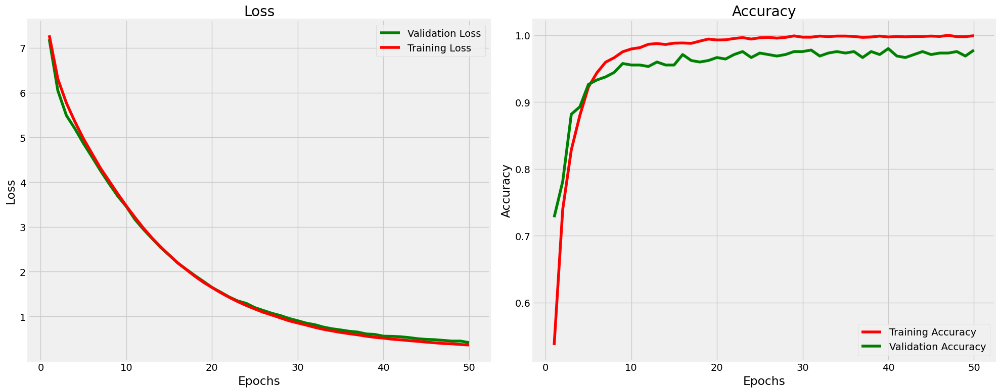

In [11]:
tr_acc = hist.history['accuracy']
tr_loss = hist.history['loss']
val_acc = hist.history['val_accuracy']
val_loss = hist.history['val_loss']

index_acc = np.argmax(val_acc) 
index_loss = np.argmin(val_loss)

val_lowest=val_loss[index_loss]
acc_highest=val_acc[index_acc]

epochs = [i+1 for i in range(len(tr_acc))]

loss_label = f'best epoch = {str(index_loss+1)}'
acc_label =  f'best epoch = {str(index_acc+1)} '

plt.figure(figsize= (20,8))
plt.style.use('fivethirtyeight')

plt.subplot(1,2,1)
plt.plot(epochs,val_loss,c='g',label= 'Validation Loss')
plt.plot(epochs,tr_loss,c='r',label= 'Training Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.title('Loss')

plt.subplot(1,2,2)
plt.plot(epochs, tr_acc, c='r', label= 'Training Accuracy')
plt.plot(epochs, val_acc, c='g', label= 'Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.title('Accuracy')

plt.tight_layout()
plt.show()

28/28 [==============================] - 1s 35ms/step - loss: 0.4344 - accuracy: 0.9754
Train Loss:  0.3444594442844391
Train Accuracy:  1.0
--------------------
Valid Loss:  0.4156551957130432
Valid Accuracy:  0.9776785969734192
--------------------
Test Loss:  0.43436238169670105
Test Accuracy:  0.9754464030265808


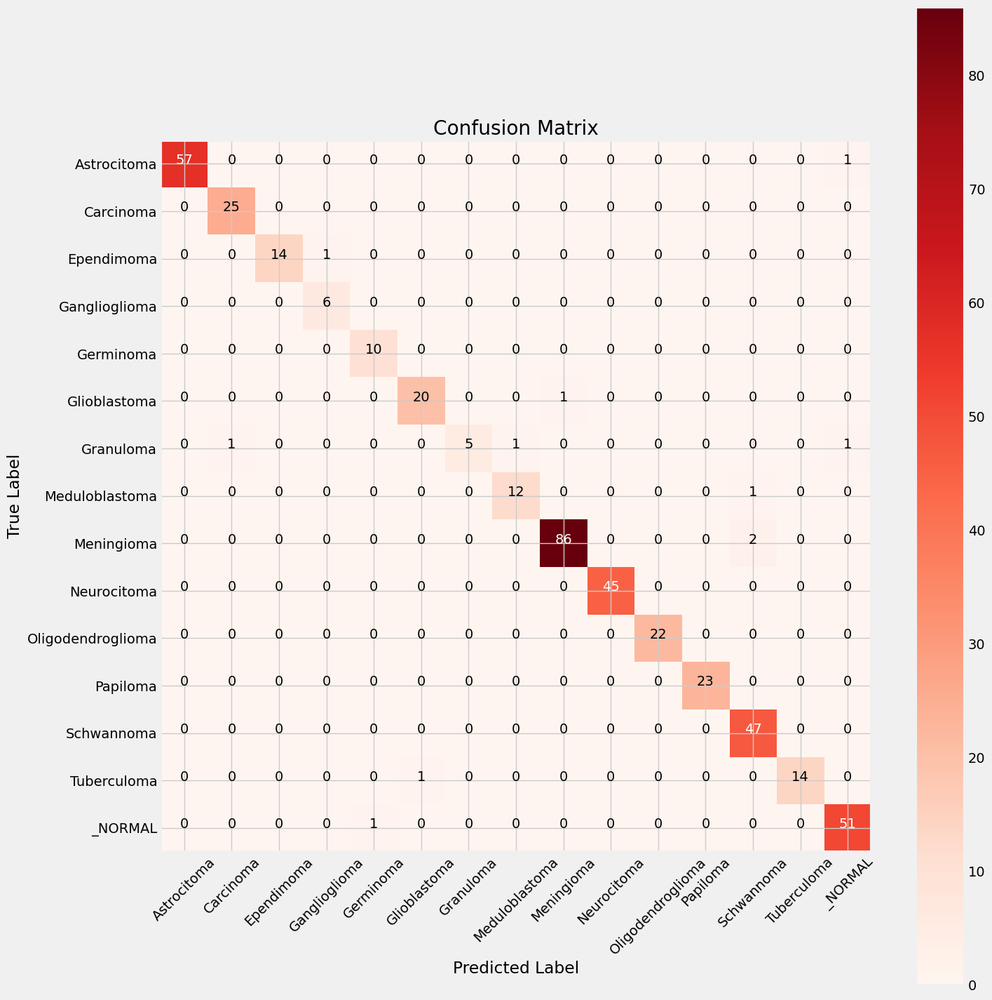

                   precision    recall  f1-score   support

      Astrocitoma       1.00      0.98      0.99        58
        Carcinoma       0.96      1.00      0.98        25
       Ependimoma       1.00      0.93      0.97        15
    Ganglioglioma       0.86      1.00      0.92         6
        Germinoma       0.91      1.00      0.95        10
     Glioblastoma       0.95      0.95      0.95        21
        Granuloma       1.00      0.62      0.77         8
   Meduloblastoma       0.92      0.92      0.92        13
       Meningioma       0.99      0.98      0.98        88
      Neurocitoma       1.00      1.00      1.00        45
Oligodendroglioma       1.00      1.00      1.00        22
         Papiloma       1.00      1.00      1.00        23
       Schwannoma       0.94      1.00      0.97        47
      Tuberculoma       1.00      0.93      0.97        15
          _NORMAL       0.96      0.98      0.97        52

         accuracy                           0.98      

In [12]:
train_score= model.evaluate(train_gen)
valid_score= model.evaluate(valid_gen)
test_score=  model.evaluate(test_gen)

print("Train Loss: ", train_score[0])
print("Train Accuracy: ", train_score[1])
print('-' * 20)
print("Valid Loss: ", valid_score[0])
print("Valid Accuracy: ", valid_score[1])
print('-' * 20)
print("Test Loss: ", test_score[0])
print("Test Accuracy: ", test_score[1])

preds = model.predict_generator(test_gen)
y_pred= np.argmax(preds,axis=1)

g_dict = test_gen.class_indices
classes = list(g_dict.keys())

# Confusion matrix
cm = confusion_matrix(test_gen.classes, y_pred)

plt.figure(figsize= (15, 15))
plt.imshow(cm, interpolation= 'nearest', cmap= plt.cm.Reds)
plt.title('Confusion Matrix')
plt.colorbar()

tick_marks = np.arange(len(classes))
plt.xticks(tick_marks, classes, rotation= 45)
plt.yticks(tick_marks, classes)


thresh = cm.max() / 2.
for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])): #(5,5)
    plt.text(j, i, cm[i, j], horizontalalignment= 'center', color= 'white' if cm[i, j] > thresh else 'black')
    
plt.tight_layout()
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.show()

from sklearn.metrics import classification_report
# Display classification report
print(classification_report(test_gen.classes, y_pred, target_names=classes))

In [22]:
model.save('effnetv2b0_multi_head_attention_dataset1.h5')

## Dataset 2: 5 Class

In [13]:
import os
from PIL import Image
import itertools

import cv2
import numpy as np 
import pandas as pd 
import seaborn as sn
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import regularizers
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam, Adamax
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import Dense, Flatten, Conv2D, MaxPooling2D, Activation, Dropout,BatchNormalization

import warnings
warnings.filterwarnings('ignore')

print('Modules Successfully Loaded')

Modules Successfully Loaded


In [2]:
# Define the path for the new folder
folder_path = '/kaggle/working/cleaned_2'

# Check if the folder already exists; if not, create it
if not os.path.exists(folder_path):
    os.makedirs(folder_path)
    print(f"Folder '{folder_path}' created successfully.")
else:
    print(f"Folder '{folder_path}' already exists.")

Folder '/kaggle/working/cleaned_2' created successfully.


In [5]:
!pip install imutils

import numpy as np
from tqdm import tqdm
import cv2
import os
import imutils

def crop_img(img):
    """
    Finds the extreme points on the image and crops the rectangular out of them
    """
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    gray = cv2.GaussianBlur(gray, (3, 3), 0)

    # find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(gray.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)

    # find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    ADD_PIXELS = 0
    new_img = img[extTop[1]-ADD_PIXELS:extBot[1]+ADD_PIXELS, extLeft[0]-ADD_PIXELS:extRight[0]+ADD_PIXELS].copy()

    return new_img

if __name__ == "__main__":
    training = "/kaggle/input/brain-tumor-mri-images-17-classes"
    training_dir = os.listdir(training)
    IMG_SIZE = 224

    for dir in training_dir:
        save_path = '/kaggle/working/cleaned_2/'+ dir
        path = os.path.join(training,dir)
        image_dir = os.listdir(path)
        for img in image_dir:
            image = cv2.imread(os.path.join(path,img))
            new_img = crop_img(image)
            new_img = cv2.resize(new_img,(IMG_SIZE,IMG_SIZE))
            if not os.path.exists(save_path):
                os.makedirs(save_path)
            cv2.imwrite(save_path+'/'+img, new_img)

In [7]:
data_dir ="/kaggle/working/cleaned_2"
paths = []
labels = []
folds = os.listdir(data_dir)
for fold in folds :
    condition_path = os.path.join(data_dir,fold)
    all_pic = os.listdir(condition_path)
    for each_pic in all_pic:
        each_pic_path = os.path.join(condition_path,each_pic)
        paths.append(each_pic_path)
        labels.append(fold.split(' ')[0])
        
pseries = pd.Series(paths, name='Picture Path')
lseries = pd.Series(labels, name='Label')

df = pd.concat([pseries, lseries], axis =1)

train_df, ts_df = train_test_split(df,test_size= 0.2,shuffle=True,random_state=42,stratify= df['Label'])
test_df, valid_df = train_test_split(ts_df,test_size= 0.5,shuffle=True,random_state=42,
                                          stratify= ts_df['Label'])

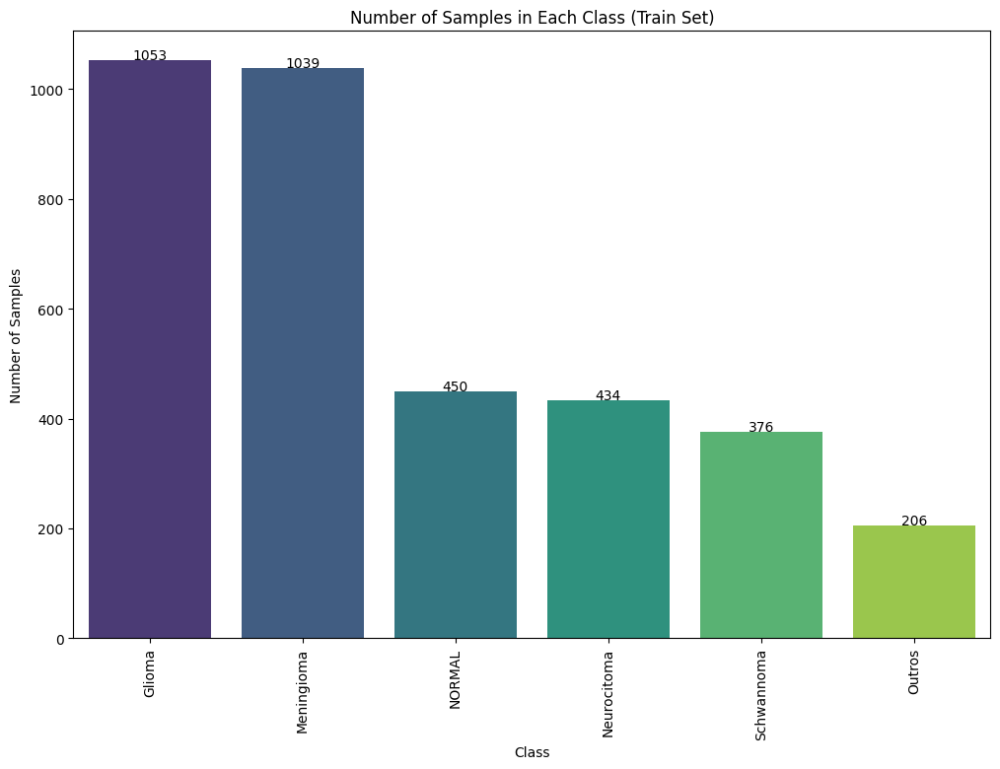

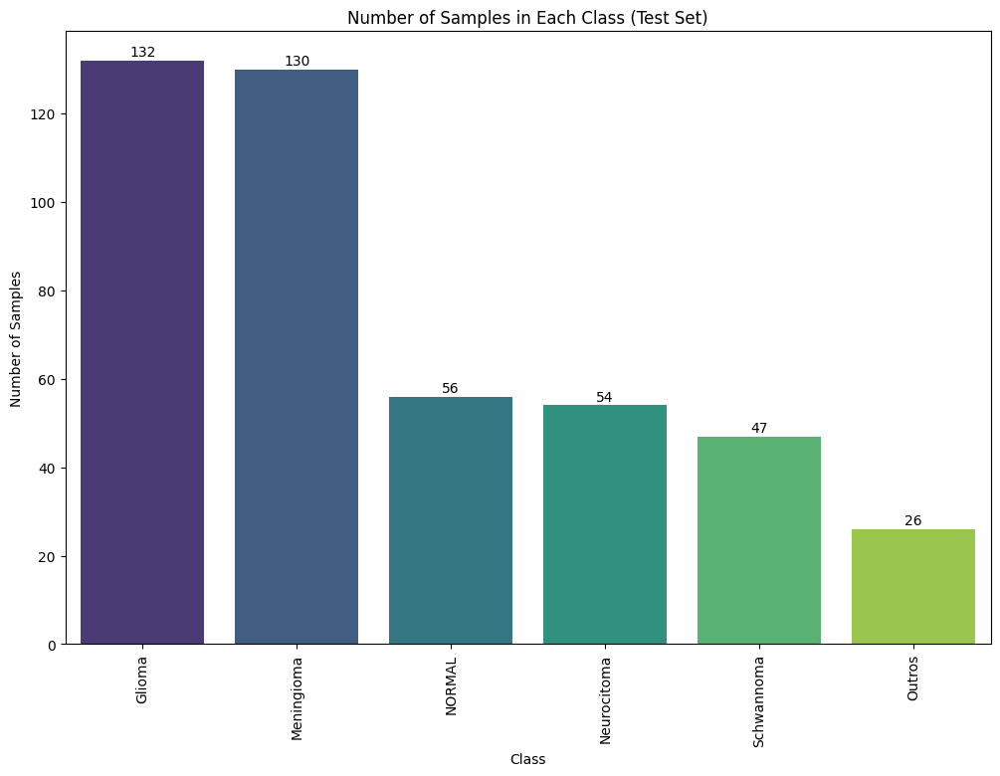

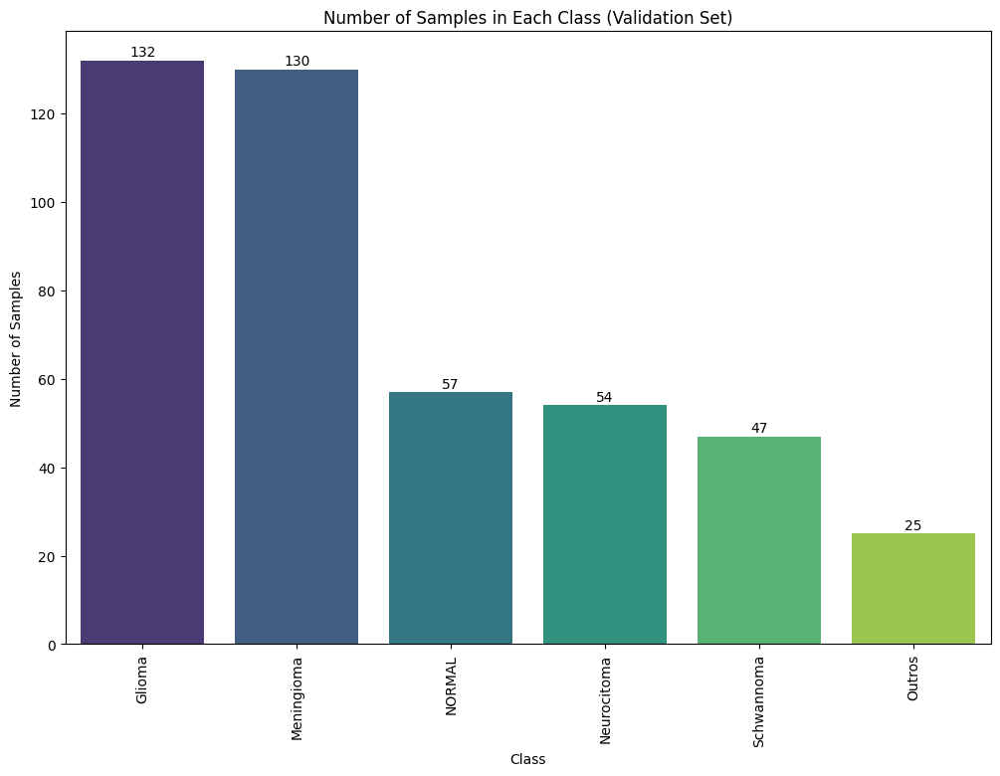

In [8]:
import pandas as pd
import os
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import seaborn as sns

# Function to plot class distribution with numbers on top of the bars and vertical labels
def plot_class_distribution(df, title):
    class_counts = df['Label'].value_counts()
    plt.figure(figsize=(12, 8))
    
    sns.barplot(x=class_counts.index, y=class_counts.values, palette="viridis")
    plt.title(title)
    plt.xlabel('Class')
    plt.ylabel('Number of Samples')
    
    # Rotate class labels vertically
    plt.xticks(rotation=90)
    
    # Add number labels on top of bars
    for i in range(len(class_counts)):
        plt.text(i, class_counts.values[i] + 1, str(class_counts.values[i]), ha='center')
    
    plt.show()

# Plot class distributions for train_df, test_df, and valid_df
plot_class_distribution(train_df, 'Number of Samples in Each Class (Train Set)')
plot_class_distribution(test_df, 'Number of Samples in Each Class (Test Set)')
plot_class_distribution(valid_df, 'Number of Samples in Each Class (Validation Set)')

Found 3529 validated image filenames belonging to 6 classes.
Found 441 validated image filenames belonging to 6 classes.
Found 445 validated image filenames belonging to 6 classes.


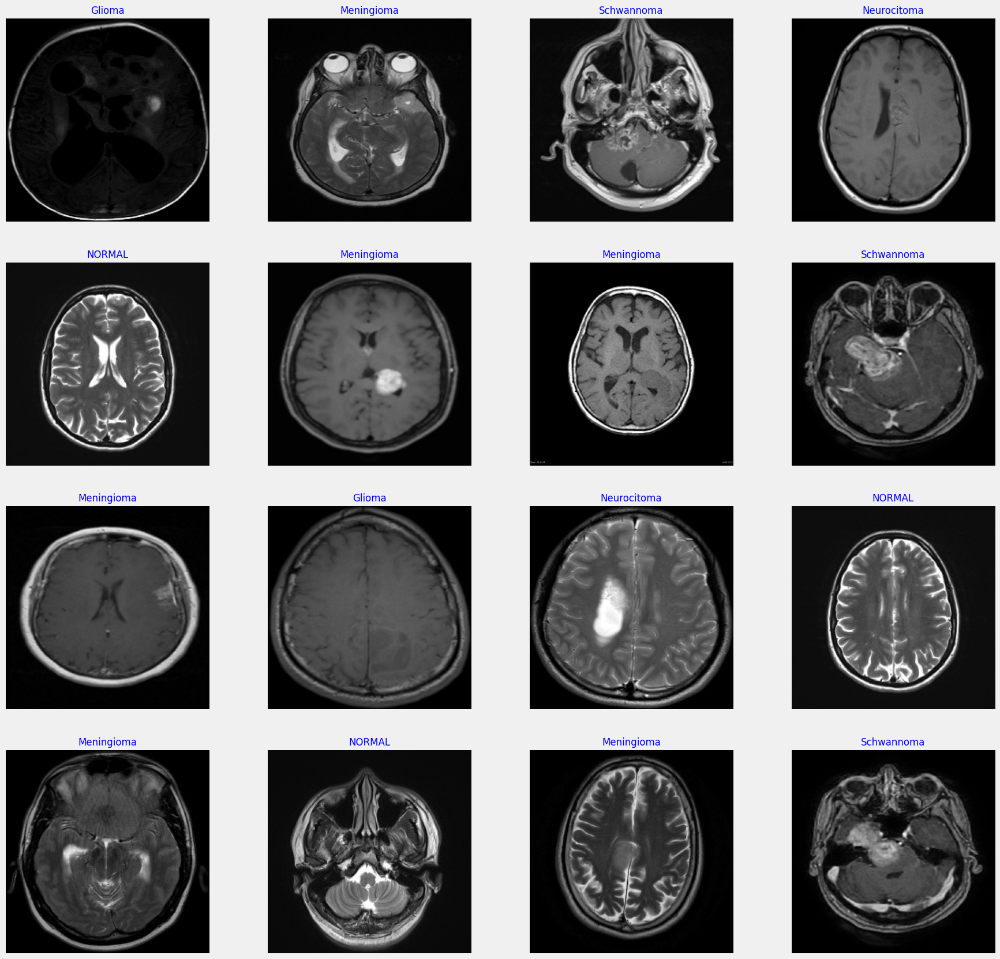

In [15]:
batch_size = 16
img_size = (224,224)

gen = ImageDataGenerator()

train_gen = gen.flow_from_dataframe(train_df, x_col='Picture Path', y_col='Label',target_size= img_size, 
                                   class_mode= 'categorical', color_mode='rgb', shuffle = True,
                                   batch_size= batch_size)

valid_gen = gen.flow_from_dataframe(valid_df, x_col='Picture Path', y_col='Label',target_size= img_size, 
                                   class_mode= 'categorical', color_mode='rgb', shuffle = True,
                                   batch_size= batch_size)

test_gen = gen.flow_from_dataframe(test_df, x_col='Picture Path', y_col='Label',target_size= img_size, 
                                   class_mode= 'categorical', color_mode='rgb', shuffle = False,
                                   batch_size= batch_size)
g_dict = train_gen.class_indices
classes= list(g_dict.keys())

images, labels = next(train_gen)

plt.figure(figsize= (20,20))

for i in range (16):
    plt.subplot(4,4,i+1)
    image = images[i] / 255
    plt.imshow(image)
    index= np.argmax(labels[i]) #[0,0,0,1,0]
    class_name = classes[index]
    plt.title(class_name,c='b', fontsize=12)
    plt.axis('off')
plt.show()

In [16]:
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.applications import EfficientNetV2B0
from tensorflow.keras.models import Model
from tensorflow.keras.layers import (
    GlobalAveragePooling2D, Dense, Dropout,
    BatchNormalization, GaussianNoise, Input,
    MultiHeadAttention, Reshape
)
from tensorflow.keras.optimizers import Adamax

# Check if GPU is availablere
physical_devices = tf.config.list_physical_devices('GPU')
if physical_devices:
    print("Using GPU")
else:
    print("Using CPU")

# Early stopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)

def create_model(input_shape, num_classes=6, learning_rate=0.0001):
    inputs = Input(shape=input_shape, name="Input_Layer")
    
    base_model = EfficientNetV2B0(weights='imagenet', input_tensor=inputs, include_top=False)
    
    x = base_model.output
    height, width, channels = x.shape[1], x.shape[2], x.shape[3]
    
    x = Reshape((height * width, channels), name="Reshape_to_Sequence")(x)
    
    attention_output = MultiHeadAttention(num_heads=8, key_dim=channels, name="Multi_Head_Attention")(x, x)
    
    attention_output = Reshape((height, width, channels), name="Reshape_to_Spatial")(attention_output)
    
    x = GlobalAveragePooling2D(name="Global_Avg_Pooling")(attention_output)
    x = Dense(512, activation='relu', name="FC_512")(x)
    x = BatchNormalization(axis = -1, momentum = 0.99, epsilon = 0.001, name="Batch_Normalization")(x)
    x = Dense(256,kernel_regularizer= regularizers.l2(0.016), activity_regularizer= regularizers.l1(0.006),
              bias_regularizer= regularizers.l1(0.006), activation= 'relu', name = "FC_256")(x)
    x = Dropout(0.45, seed = 123, name="Dropout")(x)
    
    outputs = Dense(num_classes, activation='softmax', name="Output_Layer")(x)
    
    model = Model(inputs=inputs, outputs=outputs, name="Model_with_Attention")
    model.compile(optimizer=Adamax(learning_rate=learning_rate), loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model

input_shape = (224, 224, 3)
model = create_model(input_shape, num_classes=6, learning_rate=0.0001)

Using GPU


In [17]:
model.summary()

Model: "Model_with_Attention"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 Input_Layer (InputLayer)    [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 rescaling_1 (Rescaling)     (None, 224, 224, 3)          0         ['Input_Layer[0][0]']         
                                                                                                  
 normalization_1 (Normaliza  (None, 224, 224, 3)          0         ['rescaling_1[0][0]']         
 tion)                                                                                            
                                                                                                  
 stem_conv (Conv2D)          (None, 112, 112, 32)         864       ['normaliza

In [18]:
hist= model.fit(train_gen, epochs= 50, callbacks = [early_stopping],
                verbose= 1, validation_data= valid_gen, shuffle= False)

Epoch 1/50


2024-12-12 17:46:47.464438: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inModel_with_Attention/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


221/221 [==============================] - 59s 132ms/step - loss: 6.5787 - accuracy: 0.6455 - val_loss: 6.3314 - val_accuracy: 0.8186
Epoch 2/50
221/221 [==============================] - 26s 119ms/step - loss: 5.7305 - accuracy: 0.8288 - val_loss: 5.4162 - val_accuracy: 0.8776
Epoch 3/50
221/221 [==============================] - 26s 119ms/step - loss: 5.1982 - accuracy: 0.9025 - val_loss: 4.9516 - val_accuracy: 0.9116
Epoch 4/50
221/221 [==============================] - 26s 119ms/step - loss: 4.7547 - accuracy: 0.9317 - val_loss: 4.6035 - val_accuracy: 0.9252
Epoch 5/50
221/221 [==============================] - 26s 119ms/step - loss: 4.3506 - accuracy: 0.9445 - val_loss: 4.2050 - val_accuracy: 0.9478
Epoch 6/50
221/221 [==============================] - 26s 119ms/step - loss: 3.9664 - accuracy: 0.9555 - val_loss: 3.8341 - val_accuracy: 0.9478
Epoch 7/50
221/221 [==============================] - 26s 119ms/step - loss: 3.5855 - accuracy: 0.9680 - val_loss: 3.4645 - val_accuracy: 0.9

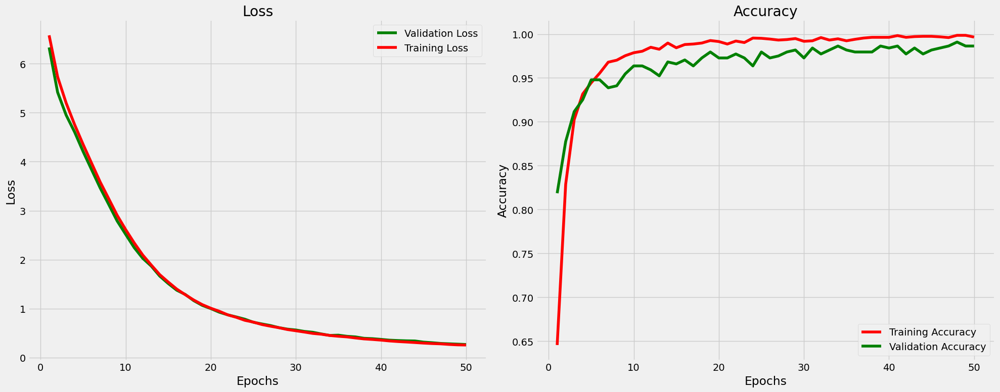

In [19]:
tr_acc = hist.history['accuracy']
tr_loss = hist.history['loss']
val_acc = hist.history['val_accuracy']
val_loss = hist.history['val_loss']

index_acc = np.argmax(val_acc) 
index_loss = np.argmin(val_loss)

val_lowest=val_loss[index_loss]
acc_highest=val_acc[index_acc]

epochs = [i+1 for i in range(len(tr_acc))]

loss_label = f'best epoch = {str(index_loss+1)}'
acc_label =  f'best epoch = {str(index_acc+1)} '

plt.figure(figsize= (20,8))
plt.style.use('fivethirtyeight')

plt.subplot(1,2,1)
plt.plot(epochs,val_loss,c='g',label= 'Validation Loss')
plt.plot(epochs,tr_loss,c='r',label= 'Training Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.title('Loss')

plt.subplot(1,2,2)
plt.plot(epochs, tr_acc, c='r', label= 'Training Accuracy')
plt.plot(epochs, val_acc, c='g', label= 'Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.title('Accuracy')

plt.tight_layout()
plt.show()

28/28 [==============================] - 2s 66ms/step - loss: 0.2803 - accuracy: 0.9798
Train Loss:  0.23056429624557495
Train Accuracy:  1.0
--------------------
Valid Loss:  0.26861023902893066
Valid Accuracy:  0.9863945841789246
--------------------
Test Loss:  0.2803025245666504
Test Accuracy:  0.9797753095626831


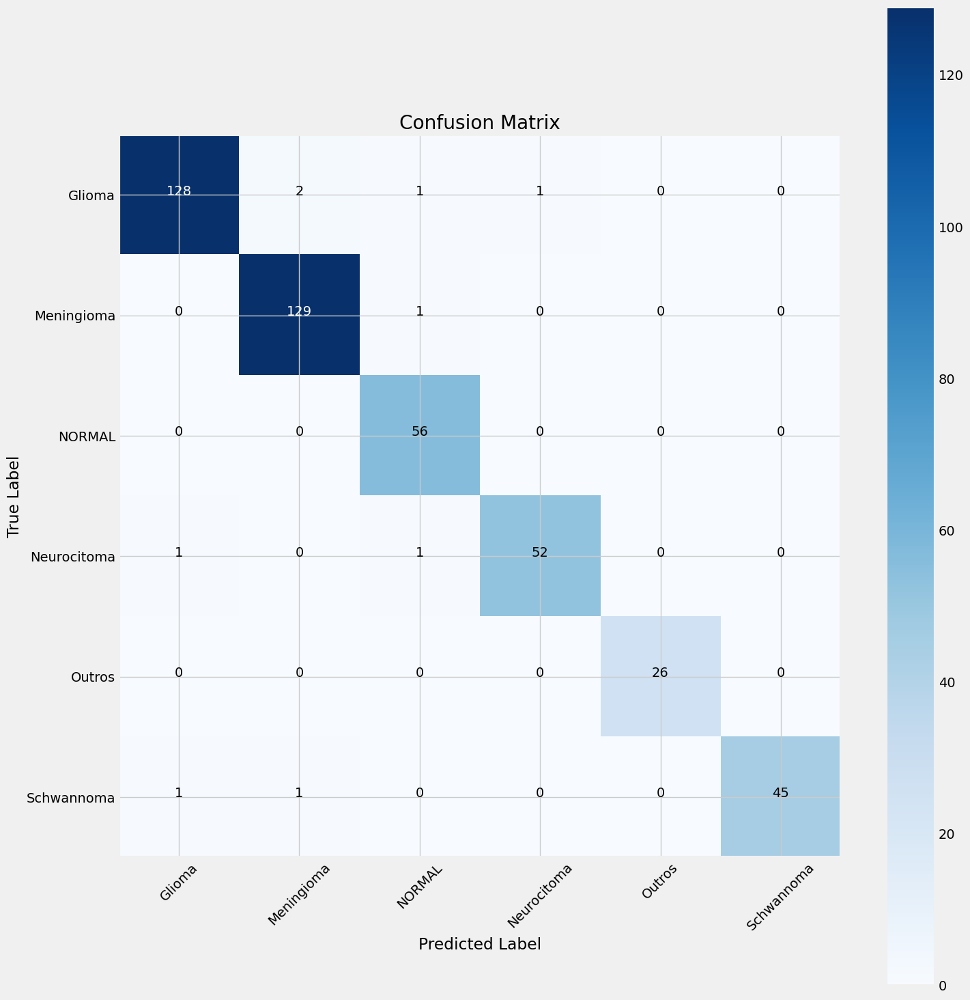

              precision    recall  f1-score   support

      Glioma       0.98      0.97      0.98       132
  Meningioma       0.98      0.99      0.98       130
      NORMAL       0.95      1.00      0.97        56
 Neurocitoma       0.98      0.96      0.97        54
      Outros       1.00      1.00      1.00        26
  Schwannoma       1.00      0.96      0.98        47

    accuracy                           0.98       445
   macro avg       0.98      0.98      0.98       445
weighted avg       0.98      0.98      0.98       445



In [20]:
train_score= model.evaluate(train_gen)
valid_score= model.evaluate(valid_gen)
test_score=  model.evaluate(test_gen)

print("Train Loss: ", train_score[0])
print("Train Accuracy: ", train_score[1])
print('-' * 20)
print("Valid Loss: ", valid_score[0])
print("Valid Accuracy: ", valid_score[1])
print('-' * 20)
print("Test Loss: ", test_score[0])
print("Test Accuracy: ", test_score[1])

preds = model.predict_generator(test_gen)
y_pred= np.argmax(preds,axis=1)

g_dict = test_gen.class_indices
classes = list(g_dict.keys())

# Confusion matrix
cm = confusion_matrix(test_gen.classes, y_pred)

plt.figure(figsize= (15, 15))
plt.imshow(cm, interpolation= 'nearest', cmap= plt.cm.Blues)
plt.title('Confusion Matrix')
plt.colorbar()

tick_marks = np.arange(len(classes))
plt.xticks(tick_marks, classes, rotation= 45)
plt.yticks(tick_marks, classes)


thresh = cm.max() / 2.
for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])): #(5,5)
    plt.text(j, i, cm[i, j], horizontalalignment= 'center', color= 'white' if cm[i, j] > thresh else 'black')
    
plt.tight_layout()
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.show()

from sklearn.metrics import classification_report
# Display classification report
print(classification_report(test_gen.classes, y_pred, target_names=classes))

In [21]:
model.save('effnetv2b0_multi_head_attention_dataset2.h5')

## Dataset 1: 5 fold cross validation

In [6]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import KFold, train_test_split
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.applications import EfficientNetV2B0
from tensorflow.keras.models import Model
from tensorflow.keras.layers import (
    GlobalAveragePooling2D, Dense, Dropout,
    BatchNormalization, GaussianNoise, Input,
    MultiHeadAttention, Reshape
)
from tensorflow.keras.optimizers import Adamax
from sklearn.metrics import classification_report, confusion_matrix
import itertools

print('Modules loaded successfully.')

Modules loaded successfully.


In [7]:
# Data preparation
data_dir = "/kaggle/working/cleaned"
paths = []
labels = []
folds = os.listdir(data_dir)
for fold in folds:
    condition_path = os.path.join(data_dir, fold)
    all_pic = os.listdir(condition_path)
    for each_pic in all_pic:
        each_pic_path = os.path.join(condition_path, each_pic)
        paths.append(each_pic_path)
        labels.append(fold.split(' ')[0])

# Create DataFrame
pseries = pd.Series(paths, name='Picture Path')
lseries = pd.Series(labels, name='Label')
df = pd.concat([pseries, lseries], axis=1)

In [8]:
# Image generator
batch_size = 16
img_size = (224, 224)
gen = ImageDataGenerator()

# Initialize variables to store results
val_accuracies = []
test_accuracies = []

# Set up KFold cross-validation
kf = KFold(n_splits=10, shuffle=True, random_state=42)

# Start KFold Cross-validation
for train_index, val_index in kf.split(df):
    train_df, val_df = df.iloc[train_index], df.iloc[val_index]

    # Further split val_df into validation and test sets
    test_df, valid_df = train_test_split(val_df, test_size=0.5, shuffle=True, random_state=42, stratify=val_df['Label'])

    # Create generators for train, validation, and test
    train_gen = gen.flow_from_dataframe(train_df, x_col='Picture Path', y_col='Label', target_size=img_size, 
                                       class_mode='categorical', color_mode='rgb', shuffle=True, batch_size=batch_size)

    valid_gen = gen.flow_from_dataframe(valid_df, x_col='Picture Path', y_col='Label', target_size=img_size, 
                                       class_mode='categorical', color_mode='rgb', shuffle=True, batch_size=batch_size)

    test_gen = gen.flow_from_dataframe(test_df, x_col='Picture Path', y_col='Label', target_size=img_size, 
                                      class_mode='categorical', color_mode='rgb', shuffle=False, batch_size=batch_size)

    # Define the model
    def create_model(input_shape, num_classes=15, learning_rate=0.0001):
        inputs = Input(shape=input_shape, name="Input_Layer")
        
        base_model = EfficientNetV2B0(weights='imagenet', input_tensor=inputs, include_top=False)
        
        x = base_model.output
        height, width, channels = x.shape[1], x.shape[2], x.shape[3]
        
        x = Reshape((height * width, channels), name="Reshape_to_Sequence")(x)
        
        attention_output = MultiHeadAttention(num_heads=8, key_dim=channels, name="Multi_Head_Attention")(x, x)
        
        attention_output = Reshape((height, width, channels), name="Reshape_to_Spatial")(attention_output)
        
        x = GlobalAveragePooling2D(name="Global_Avg_Pooling")(attention_output)
        x = Dense(512, activation='relu', name="FC_512")(x)
        x = BatchNormalization(axis=-1, momentum=0.99, epsilon=0.001, name="Batch_Normalization")(x)
        x = Dense(256, kernel_regularizer=tf.keras.regularizers.l2(0.016),
                  activity_regularizer=tf.keras.regularizers.l1(0.006),
                  bias_regularizer=tf.keras.regularizers.l1(0.006),
                  activation='relu', name="FC_256")(x)
        x = Dropout(0.45, seed=123, name="Dropout")(x)
        
        outputs = Dense(num_classes, activation='softmax', name="Output_Layer")(x)
        
        model = Model(inputs=inputs, outputs=outputs, name="Model_with_Attention")
        model.compile(optimizer=Adamax(learning_rate=learning_rate), loss='categorical_crossentropy', metrics=['accuracy'])
        
        return model

    input_shape = (224, 224, 3)
    model = create_model(input_shape, num_classes=15, learning_rate=0.0001)

    # Early stopping callback
    early_stopping = EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)

    # Train the model
    hist = model.fit(train_gen, epochs=50, callbacks=[early_stopping],
                     validation_data=valid_gen, verbose=1, shuffle=False)

    # Evaluate model
    val_score = model.evaluate(valid_gen)
    test_score = model.evaluate(test_gen)

    val_accuracies.append(val_score[1])  # validation accuracy
    test_accuracies.append(test_score[1])  # test accuracy

Found 4030 validated image filenames belonging to 15 classes.
Found 224 validated image filenames belonging to 15 classes.
Found 224 validated image filenames belonging to 15 classes.


/opt/conda/lib/python3.10/site-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 1 invalid image filename(s) in x_col="Picture Path". These filename(s) will be ignored.
  warnings.warn(


Epoch 1/50


2024-12-10 06:10:51.929478: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inModel_with_Attention/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


252/252 [==============================] - 63s 127ms/step - loss: 7.1847 - accuracy: 0.5553 - val_loss: 7.0736 - val_accuracy: 0.7098
Epoch 2/50
252/252 [==============================] - 30s 117ms/step - loss: 6.1798 - accuracy: 0.7511 - val_loss: 5.8643 - val_accuracy: 0.7991
Epoch 3/50
252/252 [==============================] - 30s 118ms/step - loss: 5.5998 - accuracy: 0.8412 - val_loss: 5.3664 - val_accuracy: 0.8616
Epoch 4/50
252/252 [==============================] - 30s 118ms/step - loss: 5.1206 - accuracy: 0.8916 - val_loss: 4.9561 - val_accuracy: 0.8973
Epoch 5/50
252/252 [==============================] - 30s 117ms/step - loss: 4.7413 - accuracy: 0.9223 - val_loss: 4.6419 - val_accuracy: 0.8884
Epoch 6/50
252/252 [==============================] - 30s 117ms/step - loss: 4.3737 - accuracy: 0.9449 - val_loss: 4.3184 - val_accuracy: 0.9241
Epoch 7/50
252/252 [==============================] - 29s 117ms/step - loss: 4.0544 - accuracy: 0.9591 - val_loss: 4.0268 - val_accuracy: 0.9

/opt/conda/lib/python3.10/site-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 1 invalid image filename(s) in x_col="Picture Path". These filename(s) will be ignored.
  warnings.warn(


Epoch 1/50


2024-12-10 06:36:06.847182: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inModel_with_Attention/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


252/252 [==============================] - 62s 125ms/step - loss: 7.2385 - accuracy: 0.5310 - val_loss: 7.0423 - val_accuracy: 0.7500
Epoch 2/50
252/252 [==============================] - 30s 118ms/step - loss: 6.2082 - accuracy: 0.7489 - val_loss: 5.8254 - val_accuracy: 0.8170
Epoch 3/50
252/252 [==============================] - 30s 117ms/step - loss: 5.6204 - accuracy: 0.8392 - val_loss: 5.3537 - val_accuracy: 0.8661
Epoch 4/50
252/252 [==============================] - 30s 117ms/step - loss: 5.1279 - accuracy: 0.8965 - val_loss: 4.9021 - val_accuracy: 0.9375
Epoch 5/50
252/252 [==============================] - 30s 117ms/step - loss: 4.7216 - accuracy: 0.9241 - val_loss: 4.5692 - val_accuracy: 0.9420
Epoch 6/50
252/252 [==============================] - 30s 117ms/step - loss: 4.3631 - accuracy: 0.9439 - val_loss: 4.2215 - val_accuracy: 0.9375
Epoch 7/50
252/252 [==============================] - 30s 118ms/step - loss: 3.9887 - accuracy: 0.9640 - val_loss: 3.8818 - val_accuracy: 0.9

/opt/conda/lib/python3.10/site-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 1 invalid image filename(s) in x_col="Picture Path". These filename(s) will be ignored.
  warnings.warn(


Epoch 1/50


2024-12-10 07:01:19.975027: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inModel_with_Attention/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


252/252 [==============================] - 61s 124ms/step - loss: 7.2457 - accuracy: 0.5422 - val_loss: 7.1559 - val_accuracy: 0.7545
Epoch 2/50
252/252 [==============================] - 29s 117ms/step - loss: 6.3057 - accuracy: 0.7385 - val_loss: 5.9768 - val_accuracy: 0.8259
Epoch 3/50
252/252 [==============================] - 30s 117ms/step - loss: 5.7209 - accuracy: 0.8375 - val_loss: 5.4724 - val_accuracy: 0.8750
Epoch 4/50
252/252 [==============================] - 30s 117ms/step - loss: 5.2945 - accuracy: 0.8777 - val_loss: 5.1302 - val_accuracy: 0.8973
Epoch 5/50
252/252 [==============================] - 30s 117ms/step - loss: 4.8884 - accuracy: 0.9228 - val_loss: 4.7790 - val_accuracy: 0.9375
Epoch 6/50
252/252 [==============================] - 30s 117ms/step - loss: 4.5298 - accuracy: 0.9452 - val_loss: 4.4554 - val_accuracy: 0.9286
Epoch 7/50
252/252 [==============================] - 30s 117ms/step - loss: 4.2045 - accuracy: 0.9568 - val_loss: 4.1117 - val_accuracy: 0.9

/opt/conda/lib/python3.10/site-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 1 invalid image filename(s) in x_col="Picture Path". These filename(s) will be ignored.
  warnings.warn(


Epoch 1/50


2024-12-10 07:26:26.476971: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inModel_with_Attention/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


252/252 [==============================] - 62s 124ms/step - loss: 7.2400 - accuracy: 0.5345 - val_loss: 7.0308 - val_accuracy: 0.7321
Epoch 2/50
252/252 [==============================] - 29s 117ms/step - loss: 6.2225 - accuracy: 0.7397 - val_loss: 5.8258 - val_accuracy: 0.7946
Epoch 3/50
252/252 [==============================] - 29s 117ms/step - loss: 5.6255 - accuracy: 0.8370 - val_loss: 5.3580 - val_accuracy: 0.8750
Epoch 4/50
252/252 [==============================] - 30s 117ms/step - loss: 5.1558 - accuracy: 0.8901 - val_loss: 4.9904 - val_accuracy: 0.8884
Epoch 5/50
252/252 [==============================] - 30s 117ms/step - loss: 4.7532 - accuracy: 0.9270 - val_loss: 4.6677 - val_accuracy: 0.8839
Epoch 6/50
252/252 [==============================] - 29s 116ms/step - loss: 4.4007 - accuracy: 0.9467 - val_loss: 4.3120 - val_accuracy: 0.9286
Epoch 7/50
252/252 [==============================] - 29s 117ms/step - loss: 4.0642 - accuracy: 0.9551 - val_loss: 4.0144 - val_accuracy: 0.9

/opt/conda/lib/python3.10/site-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 1 invalid image filename(s) in x_col="Picture Path". These filename(s) will be ignored.
  warnings.warn(


Epoch 1/50


2024-12-10 07:51:35.050083: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inModel_with_Attention/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


252/252 [==============================] - 61s 124ms/step - loss: 7.2066 - accuracy: 0.5400 - val_loss: 7.1233 - val_accuracy: 0.7054
Epoch 2/50
252/252 [==============================] - 30s 117ms/step - loss: 6.2245 - accuracy: 0.7546 - val_loss: 5.9080 - val_accuracy: 0.8125
Epoch 3/50
252/252 [==============================] - 29s 117ms/step - loss: 5.6656 - accuracy: 0.8382 - val_loss: 5.4093 - val_accuracy: 0.8839
Epoch 4/50
252/252 [==============================] - 30s 117ms/step - loss: 5.1977 - accuracy: 0.8940 - val_loss: 5.0575 - val_accuracy: 0.9018
Epoch 5/50
252/252 [==============================] - 30s 118ms/step - loss: 4.7998 - accuracy: 0.9223 - val_loss: 4.6846 - val_accuracy: 0.9241
Epoch 6/50
252/252 [==============================] - 30s 118ms/step - loss: 4.4376 - accuracy: 0.9442 - val_loss: 4.3611 - val_accuracy: 0.9241
Epoch 7/50
252/252 [==============================] - 30s 118ms/step - loss: 4.1024 - accuracy: 0.9568 - val_loss: 4.0028 - val_accuracy: 0.9

/opt/conda/lib/python3.10/site-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 1 invalid image filename(s) in x_col="Picture Path". These filename(s) will be ignored.
  warnings.warn(


Epoch 1/50


2024-12-10 08:16:56.784602: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inModel_with_Attention/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


252/252 [==============================] - 63s 125ms/step - loss: 7.2171 - accuracy: 0.5310 - val_loss: 7.0607 - val_accuracy: 0.7009
Epoch 2/50
252/252 [==============================] - 30s 117ms/step - loss: 6.1860 - accuracy: 0.7442 - val_loss: 5.8626 - val_accuracy: 0.7634
Epoch 3/50
252/252 [==============================] - 30s 117ms/step - loss: 5.6373 - accuracy: 0.8325 - val_loss: 5.3251 - val_accuracy: 0.8616
Epoch 4/50
252/252 [==============================] - 30s 117ms/step - loss: 5.1595 - accuracy: 0.8896 - val_loss: 4.9664 - val_accuracy: 0.8884
Epoch 5/50
252/252 [==============================] - 30s 118ms/step - loss: 4.7450 - accuracy: 0.9298 - val_loss: 4.6258 - val_accuracy: 0.9286
Epoch 6/50
252/252 [==============================] - 30s 119ms/step - loss: 4.3805 - accuracy: 0.9484 - val_loss: 4.2621 - val_accuracy: 0.9286
Epoch 7/50
252/252 [==============================] - 30s 118ms/step - loss: 4.0420 - accuracy: 0.9598 - val_loss: 3.9629 - val_accuracy: 0.9

/opt/conda/lib/python3.10/site-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 1 invalid image filename(s) in x_col="Picture Path". These filename(s) will be ignored.
  warnings.warn(


Epoch 1/50


2024-12-10 08:42:14.866648: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inModel_with_Attention/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


252/252 [==============================] - 63s 130ms/step - loss: 7.2416 - accuracy: 0.5207 - val_loss: 6.9784 - val_accuracy: 0.7937
Epoch 2/50
252/252 [==============================] - 30s 117ms/step - loss: 6.1796 - accuracy: 0.7447 - val_loss: 5.7039 - val_accuracy: 0.8655
Epoch 3/50
252/252 [==============================] - 30s 117ms/step - loss: 5.6075 - accuracy: 0.8288 - val_loss: 5.2066 - val_accuracy: 0.9103
Epoch 4/50
252/252 [==============================] - 30s 117ms/step - loss: 5.1445 - accuracy: 0.8908 - val_loss: 4.8904 - val_accuracy: 0.9193
Epoch 5/50
252/252 [==============================] - 30s 117ms/step - loss: 4.7425 - accuracy: 0.9253 - val_loss: 4.5330 - val_accuracy: 0.9372
Epoch 6/50
252/252 [==============================] - 30s 117ms/step - loss: 4.3930 - accuracy: 0.9410 - val_loss: 4.2170 - val_accuracy: 0.9283
Epoch 7/50
252/252 [==============================] - 30s 117ms/step - loss: 4.0475 - accuracy: 0.9591 - val_loss: 3.8947 - val_accuracy: 0.9

/opt/conda/lib/python3.10/site-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 1 invalid image filename(s) in x_col="Picture Path". These filename(s) will be ignored.
  warnings.warn(


Epoch 1/50


2024-12-10 09:07:30.653942: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inModel_with_Attention/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


252/252 [==============================] - 63s 125ms/step - loss: 7.2098 - accuracy: 0.5320 - val_loss: 7.0157 - val_accuracy: 0.7589
Epoch 2/50
252/252 [==============================] - 30s 117ms/step - loss: 6.2317 - accuracy: 0.7454 - val_loss: 5.7898 - val_accuracy: 0.8348
Epoch 3/50
252/252 [==============================] - 29s 117ms/step - loss: 5.6534 - accuracy: 0.8313 - val_loss: 5.3368 - val_accuracy: 0.8973
Epoch 4/50
252/252 [==============================] - 29s 117ms/step - loss: 5.1694 - accuracy: 0.8953 - val_loss: 4.9771 - val_accuracy: 0.9062
Epoch 5/50
252/252 [==============================] - 29s 117ms/step - loss: 4.7780 - accuracy: 0.9238 - val_loss: 4.6279 - val_accuracy: 0.9196
Epoch 6/50
252/252 [==============================] - 30s 117ms/step - loss: 4.4170 - accuracy: 0.9449 - val_loss: 4.2918 - val_accuracy: 0.9330
Epoch 7/50
252/252 [==============================] - 30s 118ms/step - loss: 4.0887 - accuracy: 0.9568 - val_loss: 3.9831 - val_accuracy: 0.9

/opt/conda/lib/python3.10/site-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 1 invalid image filename(s) in x_col="Picture Path". These filename(s) will be ignored.
  warnings.warn(


Epoch 1/50


2024-12-10 09:32:41.787857: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inModel_with_Attention/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


252/252 [==============================] - 60s 124ms/step - loss: 7.2036 - accuracy: 0.5275 - val_loss: 7.0128 - val_accuracy: 0.7500
Epoch 2/50
252/252 [==============================] - 29s 117ms/step - loss: 6.1899 - accuracy: 0.7390 - val_loss: 5.7595 - val_accuracy: 0.8527
Epoch 3/50
252/252 [==============================] - 29s 117ms/step - loss: 5.5666 - accuracy: 0.8427 - val_loss: 5.2708 - val_accuracy: 0.8705
Epoch 4/50
252/252 [==============================] - 29s 116ms/step - loss: 5.1254 - accuracy: 0.8868 - val_loss: 4.8639 - val_accuracy: 0.9018
Epoch 5/50
252/252 [==============================] - 29s 117ms/step - loss: 4.7258 - accuracy: 0.9169 - val_loss: 4.5822 - val_accuracy: 0.9107
Epoch 6/50
252/252 [==============================] - 29s 117ms/step - loss: 4.3553 - accuracy: 0.9439 - val_loss: 4.2168 - val_accuracy: 0.9286
Epoch 7/50
252/252 [==============================] - 29s 117ms/step - loss: 4.0107 - accuracy: 0.9553 - val_loss: 3.8837 - val_accuracy: 0.9

/opt/conda/lib/python3.10/site-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 1 invalid image filename(s) in x_col="Picture Path". These filename(s) will be ignored.
  warnings.warn(


Epoch 1/50


2024-12-10 09:57:51.333781: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inModel_with_Attention/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


252/252 [==============================] - 61s 125ms/step - loss: 7.2203 - accuracy: 0.5277 - val_loss: 6.9960 - val_accuracy: 0.7634
Epoch 2/50
252/252 [==============================] - 29s 117ms/step - loss: 6.1777 - accuracy: 0.7437 - val_loss: 5.7314 - val_accuracy: 0.8348
Epoch 3/50
252/252 [==============================] - 30s 117ms/step - loss: 5.6108 - accuracy: 0.8353 - val_loss: 5.2279 - val_accuracy: 0.9062
Epoch 4/50
252/252 [==============================] - 30s 118ms/step - loss: 5.1228 - accuracy: 0.8931 - val_loss: 4.8768 - val_accuracy: 0.9330
Epoch 5/50
252/252 [==============================] - 30s 117ms/step - loss: 4.7236 - accuracy: 0.9221 - val_loss: 4.5349 - val_accuracy: 0.9330
Epoch 6/50
252/252 [==============================] - 29s 117ms/step - loss: 4.3453 - accuracy: 0.9439 - val_loss: 4.1794 - val_accuracy: 0.9509
Epoch 7/50
252/252 [==============================] - 29s 117ms/step - loss: 4.0145 - accuracy: 0.9606 - val_loss: 3.8798 - val_accuracy: 0.9

Average validation accuracy: 0.9772281408309936
Average test accuracy: 0.9754324138164521


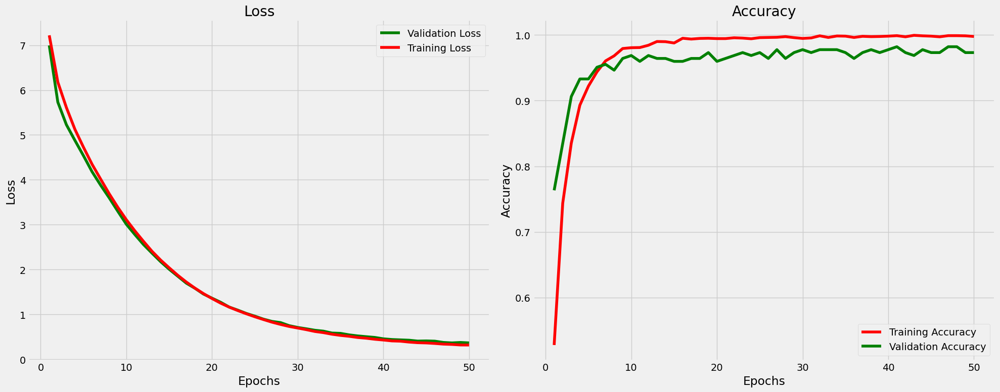

14/14 [==============================] - 1s 35ms/step - loss: 0.4181 - accuracy: 0.9686
Train Loss:  0.30043455958366394
Train Accuracy:  1.0
--------------------
Valid Loss:  0.36493363976478577
Valid Accuracy:  0.9732142686843872
--------------------
Test Loss:  0.4181123971939087
Test Accuracy:  0.9686098694801331
14/14 [==============================] - 2s 32ms/step


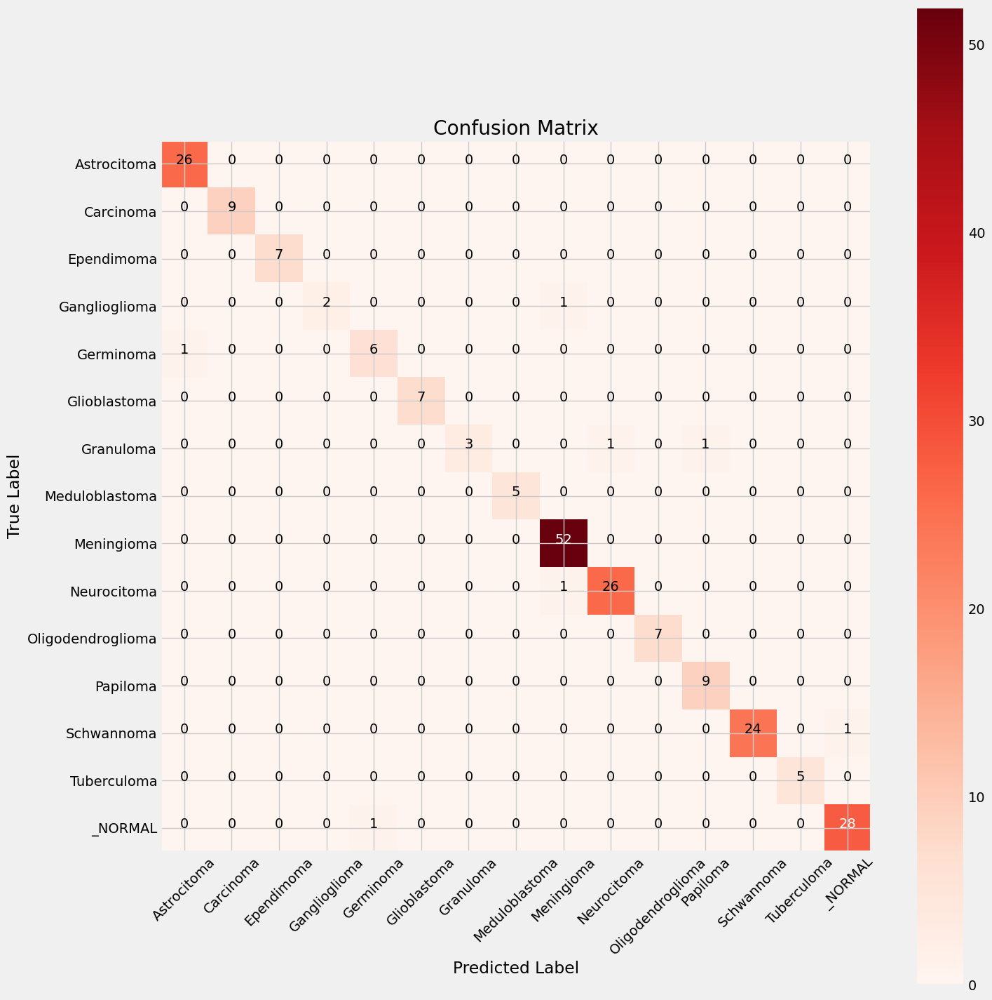

                   precision    recall  f1-score   support

      Astrocitoma       0.96      1.00      0.98        26
        Carcinoma       1.00      1.00      1.00         9
       Ependimoma       1.00      1.00      1.00         7
    Ganglioglioma       1.00      0.67      0.80         3
        Germinoma       0.86      0.86      0.86         7
     Glioblastoma       1.00      1.00      1.00         7
        Granuloma       1.00      0.60      0.75         5
   Meduloblastoma       1.00      1.00      1.00         5
       Meningioma       0.96      1.00      0.98        52
      Neurocitoma       0.96      0.96      0.96        27
Oligodendroglioma       1.00      1.00      1.00         7
         Papiloma       0.90      1.00      0.95         9
       Schwannoma       1.00      0.96      0.98        25
      Tuberculoma       1.00      1.00      1.00         5
          _NORMAL       0.97      0.97      0.97        29

         accuracy                           0.97      

In [9]:
# Print average accuracies over all folds
print(f"Average validation accuracy: {np.mean(val_accuracies)}")
print(f"Average test accuracy: {np.mean(test_accuracies)}")

# Optionally, you can visualize the results of the last fold
# Training accuracy and loss 
tr_acc = hist.history['accuracy']
tr_loss = hist.history['loss']
val_acc = hist.history['val_accuracy']
val_loss = hist.history['val_loss']

index_acc = np.argmax(val_acc)
index_loss = np.argmin(val_loss)

val_lowest = val_loss[index_loss]
acc_highest = val_acc[index_acc]

epochs = [i + 1 for i in range(len(tr_acc))]

plt.figure(figsize=(20, 8))
plt.style.use('fivethirtyeight')

plt.subplot(1, 2, 1)
plt.plot(epochs, val_loss, c='g', label='Validation Loss')
plt.plot(epochs, tr_loss, c='r', label='Training Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.title('Loss')

plt.subplot(1, 2, 2)
plt.plot(epochs, tr_acc, c='r', label='Training Accuracy')
plt.plot(epochs, val_acc, c='g', label='Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.title('Accuracy')

plt.tight_layout()
plt.show()

# Evaluate on train, validation, and test data
train_score = model.evaluate(train_gen)
valid_score = model.evaluate(valid_gen)
test_score = model.evaluate(test_gen)

print("Train Loss: ", train_score[0])
print("Train Accuracy: ", train_score[1])
print('-' * 20)
print("Valid Loss: ", valid_score[0])
print("Valid Accuracy: ", valid_score[1])
print('-' * 20)
print("Test Loss: ", test_score[0])
print("Test Accuracy: ", test_score[1])

# Predictions and Confusion Matrix
preds = model.predict(test_gen)
y_pred = np.argmax(preds, axis=1)

g_dict = test_gen.class_indices
classes = list(g_dict.keys())

# Confusion matrix
cm = confusion_matrix(test_gen.classes, y_pred)

plt.figure(figsize=(15, 15))
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Reds)
plt.title('Confusion Matrix')
plt.colorbar()

tick_marks = np.arange(len(classes))
plt.xticks(tick_marks, classes, rotation=45)
plt.yticks(tick_marks, classes)

thresh = cm.max() / 2.
for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
    plt.text(j, i, cm[i, j], horizontalalignment='center', color='white' if cm[i, j] > thresh else 'black')

plt.tight_layout()
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.show()

# Classification report
print(classification_report(test_gen.classes, y_pred, target_names=classes))

## Dataset 2: 5 fold cross validation

In [7]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import KFold, train_test_split
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.applications import EfficientNetV2B0
from tensorflow.keras.models import Model
from tensorflow.keras.layers import (
    GlobalAveragePooling2D, Dense, Dropout,
    BatchNormalization, GaussianNoise, Input,
    MultiHeadAttention, Reshape
)
from tensorflow.keras.optimizers import Adamax
from sklearn.metrics import classification_report, confusion_matrix
import itertools

print('Modules loaded successfully.')

Modules loaded successfully.


In [8]:
# Data preparation
data_dir = "/kaggle/working/cleaned_2"
paths = []
labels = []
folds = os.listdir(data_dir)
for fold in folds:
    condition_path = os.path.join(data_dir, fold)
    all_pic = os.listdir(condition_path)
    for each_pic in all_pic:
        each_pic_path = os.path.join(condition_path, each_pic)
        paths.append(each_pic_path)
        labels.append(fold.split(' ')[0])

# Create DataFrame
pseries = pd.Series(paths, name='Picture Path')
lseries = pd.Series(labels, name='Label')
df = pd.concat([pseries, lseries], axis=1)

In [9]:
# Image generator
batch_size = 16
img_size = (224, 224)
gen = ImageDataGenerator()

# Initialize variables to store results
val_accuracies = []
test_accuracies = []

# Set up KFold cross-validation
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Start KFold Cross-validation
for train_index, val_index in kf.split(df):
    train_df, val_df = df.iloc[train_index], df.iloc[val_index]

    # Further split val_df into validation and test sets
    test_df, valid_df = train_test_split(val_df, test_size=0.5, shuffle=True, random_state=42, stratify=val_df['Label'])

    # Create generators for train, validation, and test
    train_gen = gen.flow_from_dataframe(train_df, x_col='Picture Path', y_col='Label', target_size=img_size, 
                                       class_mode='categorical', color_mode='rgb', shuffle=True, batch_size=batch_size)

    valid_gen = gen.flow_from_dataframe(valid_df, x_col='Picture Path', y_col='Label', target_size=img_size, 
                                       class_mode='categorical', color_mode='rgb', shuffle=True, batch_size=batch_size)

    test_gen = gen.flow_from_dataframe(test_df, x_col='Picture Path', y_col='Label', target_size=img_size, 
                                      class_mode='categorical', color_mode='rgb', shuffle=False, batch_size=batch_size)

    # Define the model
    def create_model(input_shape, num_classes=6, learning_rate=0.0001):
        inputs = Input(shape=input_shape, name="Input_Layer")
        
        base_model = EfficientNetV2B0(weights='imagenet', input_tensor=inputs, include_top=False)
        
        x = base_model.output
        height, width, channels = x.shape[1], x.shape[2], x.shape[3]
        
        x = Reshape((height * width, channels), name="Reshape_to_Sequence")(x)
        
        attention_output = MultiHeadAttention(num_heads=8, key_dim=channels, name="Multi_Head_Attention")(x, x)
        
        attention_output = Reshape((height, width, channels), name="Reshape_to_Spatial")(attention_output)
        
        x = GlobalAveragePooling2D(name="Global_Avg_Pooling")(attention_output)
        x = Dense(512, activation='relu', name="FC_512")(x)
        x = BatchNormalization(axis=-1, momentum=0.99, epsilon=0.001, name="Batch_Normalization")(x)
        x = Dense(256, kernel_regularizer=tf.keras.regularizers.l2(0.016),
                  activity_regularizer=tf.keras.regularizers.l1(0.006),
                  bias_regularizer=tf.keras.regularizers.l1(0.006),
                  activation='relu', name="FC_256")(x)
        x = Dropout(0.45, seed=123, name="Dropout")(x)
        
        outputs = Dense(num_classes, activation='softmax', name="Output_Layer")(x)
        
        model = Model(inputs=inputs, outputs=outputs, name="Model_with_Attention")
        model.compile(optimizer=Adamax(learning_rate=learning_rate), loss='categorical_crossentropy', metrics=['accuracy'])
        
        return model

    input_shape = (224, 224, 3)
    model = create_model(input_shape, num_classes=6, learning_rate=0.0001)

    # Early stopping callback
    early_stopping = EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)

    # Train the model
    hist = model.fit(train_gen, epochs=50, callbacks=[early_stopping],
                     validation_data=valid_gen, verbose=1, shuffle=False)

    # Evaluate model
    val_score = model.evaluate(valid_gen)
    test_score = model.evaluate(test_gen)

    val_accuracies.append(val_score[1])  # validation accuracy
    test_accuracies.append(test_score[1])  # test accuracy

Found 3534 validated image filenames belonging to 6 classes.
Found 443 validated image filenames belonging to 6 classes.
Found 438 validated image filenames belonging to 6 classes.


/opt/conda/lib/python3.10/site-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 24 invalid image filename(s) in x_col="Picture Path". These filename(s) will be ignored.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 2 invalid image filename(s) in x_col="Picture Path". These filename(s) will be ignored.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 7 invalid image filename(s) in x_col="Picture Path". These filename(s) will be ignored.
  warnings.warn(


24274472/24274472 [==============================] - 0s 0us/step
Epoch 1/50


2024-12-10 13:30:28.198873: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inModel_with_Attention/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer
I0000 00:00:1733837434.034599     146 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


221/221 [==============================] - 68s 138ms/step - loss: 6.5732 - accuracy: 0.6409 - val_loss: 6.2912 - val_accuracy: 0.8194
Epoch 2/50
221/221 [==============================] - 26s 119ms/step - loss: 5.7022 - accuracy: 0.8231 - val_loss: 5.3842 - val_accuracy: 0.8691
Epoch 3/50
221/221 [==============================] - 26s 119ms/step - loss: 5.1528 - accuracy: 0.8933 - val_loss: 4.8835 - val_accuracy: 0.9007
Epoch 4/50
221/221 [==============================] - 26s 119ms/step - loss: 4.6685 - accuracy: 0.9281 - val_loss: 4.4728 - val_accuracy: 0.9323
Epoch 5/50
221/221 [==============================] - 26s 119ms/step - loss: 4.2564 - accuracy: 0.9426 - val_loss: 4.0977 - val_accuracy: 0.9323
Epoch 6/50
221/221 [==============================] - 26s 119ms/step - loss: 3.8562 - accuracy: 0.9581 - val_loss: 3.7393 - val_accuracy: 0.9300
Epoch 7/50
221/221 [==============================] - 26s 119ms/step - loss: 3.4861 - accuracy: 0.9646 - val_loss: 3.3679 - val_accuracy: 0.9

/opt/conda/lib/python3.10/site-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 29 invalid image filename(s) in x_col="Picture Path". These filename(s) will be ignored.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 2 invalid image filename(s) in x_col="Picture Path". These filename(s) will be ignored.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 2 invalid image filename(s) in x_col="Picture Path". These filename(s) will be ignored.
  warnings.warn(


Epoch 1/50


2024-12-10 13:53:09.819247: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inModel_with_Attention/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


221/221 [==============================] - 59s 130ms/step - loss: 6.6223 - accuracy: 0.6472 - val_loss: 6.3553 - val_accuracy: 0.8623
Epoch 2/50
221/221 [==============================] - 26s 119ms/step - loss: 5.7523 - accuracy: 0.8277 - val_loss: 5.3848 - val_accuracy: 0.9278
Epoch 3/50
221/221 [==============================] - 26s 119ms/step - loss: 5.2206 - accuracy: 0.8935 - val_loss: 4.8773 - val_accuracy: 0.9549
Epoch 4/50
221/221 [==============================] - 26s 120ms/step - loss: 4.7739 - accuracy: 0.9249 - val_loss: 4.5233 - val_accuracy: 0.9616
Epoch 5/50
221/221 [==============================] - 26s 119ms/step - loss: 4.3515 - accuracy: 0.9428 - val_loss: 4.1357 - val_accuracy: 0.9752
Epoch 6/50
221/221 [==============================] - 26s 118ms/step - loss: 3.9593 - accuracy: 0.9595 - val_loss: 3.7649 - val_accuracy: 0.9729
Epoch 7/50
221/221 [==============================] - 26s 119ms/step - loss: 3.5840 - accuracy: 0.9671 - val_loss: 3.4038 - val_accuracy: 0.9

/opt/conda/lib/python3.10/site-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 21 invalid image filename(s) in x_col="Picture Path". These filename(s) will be ignored.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 8 invalid image filename(s) in x_col="Picture Path". These filename(s) will be ignored.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 4 invalid image filename(s) in x_col="Picture Path". These filename(s) will be ignored.
  warnings.warn(


Epoch 1/50


2024-12-10 14:15:39.378122: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inModel_with_Attention/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


222/222 [==============================] - 59s 132ms/step - loss: 6.5982 - accuracy: 0.6407 - val_loss: 6.3289 - val_accuracy: 0.8238
Epoch 2/50
222/222 [==============================] - 26s 119ms/step - loss: 5.7314 - accuracy: 0.8264 - val_loss: 5.4424 - val_accuracy: 0.8787
Epoch 3/50
222/222 [==============================] - 26s 119ms/step - loss: 5.1966 - accuracy: 0.8982 - val_loss: 4.9323 - val_accuracy: 0.9199
Epoch 4/50
222/222 [==============================] - 26s 119ms/step - loss: 4.7370 - accuracy: 0.9319 - val_loss: 4.5937 - val_accuracy: 0.9222
Epoch 5/50
222/222 [==============================] - 26s 119ms/step - loss: 4.3215 - accuracy: 0.9502 - val_loss: 4.1468 - val_accuracy: 0.9474
Epoch 6/50
222/222 [==============================] - 26s 119ms/step - loss: 3.9381 - accuracy: 0.9610 - val_loss: 3.7885 - val_accuracy: 0.9382
Epoch 7/50
222/222 [==============================] - 26s 119ms/step - loss: 3.5826 - accuracy: 0.9624 - val_loss: 3.4378 - val_accuracy: 0.9

/opt/conda/lib/python3.10/site-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 30 invalid image filename(s) in x_col="Picture Path". These filename(s) will be ignored.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 1 invalid image filename(s) in x_col="Picture Path". These filename(s) will be ignored.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 2 invalid image filename(s) in x_col="Picture Path". These filename(s) will be ignored.
  warnings.warn(


Epoch 1/50


2024-12-10 14:38:21.445235: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inModel_with_Attention/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


221/221 [==============================] - 60s 132ms/step - loss: 6.5705 - accuracy: 0.6478 - val_loss: 6.2562 - val_accuracy: 0.8153
Epoch 2/50
221/221 [==============================] - 27s 120ms/step - loss: 5.6681 - accuracy: 0.8351 - val_loss: 5.3246 - val_accuracy: 0.8964
Epoch 3/50
221/221 [==============================] - 27s 120ms/step - loss: 5.1349 - accuracy: 0.8912 - val_loss: 4.8863 - val_accuracy: 0.9167
Epoch 4/50
221/221 [==============================] - 27s 120ms/step - loss: 4.6837 - accuracy: 0.9311 - val_loss: 4.4880 - val_accuracy: 0.9392
Epoch 5/50
221/221 [==============================] - 27s 120ms/step - loss: 4.2611 - accuracy: 0.9464 - val_loss: 4.1657 - val_accuracy: 0.9212
Epoch 6/50
221/221 [==============================] - 27s 121ms/step - loss: 3.8686 - accuracy: 0.9632 - val_loss: 3.7613 - val_accuracy: 0.9459
Epoch 7/50
221/221 [==============================] - 27s 120ms/step - loss: 3.5142 - accuracy: 0.9651 - val_loss: 3.4119 - val_accuracy: 0.9

/opt/conda/lib/python3.10/site-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 28 invalid image filename(s) in x_col="Picture Path". These filename(s) will be ignored.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 3 invalid image filename(s) in x_col="Picture Path". These filename(s) will be ignored.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/keras/src/preprocessing/image.py:1137: UserWarning: Found 2 invalid image filename(s) in x_col="Picture Path". These filename(s) will be ignored.
  warnings.warn(


Epoch 1/50


2024-12-10 15:01:05.545448: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inModel_with_Attention/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


221/221 [==============================] - 59s 130ms/step - loss: 6.5843 - accuracy: 0.6423 - val_loss: 6.2638 - val_accuracy: 0.8213
Epoch 2/50
221/221 [==============================] - 27s 120ms/step - loss: 5.6756 - accuracy: 0.8284 - val_loss: 5.3360 - val_accuracy: 0.8982
Epoch 3/50
221/221 [==============================] - 27s 120ms/step - loss: 5.1212 - accuracy: 0.8884 - val_loss: 4.8729 - val_accuracy: 0.9299
Epoch 4/50
221/221 [==============================] - 27s 120ms/step - loss: 4.6593 - accuracy: 0.9179 - val_loss: 4.4789 - val_accuracy: 0.9321
Epoch 5/50
221/221 [==============================] - 26s 120ms/step - loss: 4.2100 - accuracy: 0.9493 - val_loss: 4.0987 - val_accuracy: 0.9321
Epoch 6/50
221/221 [==============================] - 27s 120ms/step - loss: 3.8255 - accuracy: 0.9606 - val_loss: 3.7087 - val_accuracy: 0.9480
Epoch 7/50
221/221 [==============================] - 27s 120ms/step - loss: 3.4387 - accuracy: 0.9734 - val_loss: 3.3394 - val_accuracy: 0.9

Average validation accuracy: 0.9850643396377563
Average test accuracy: 0.9800491690635681


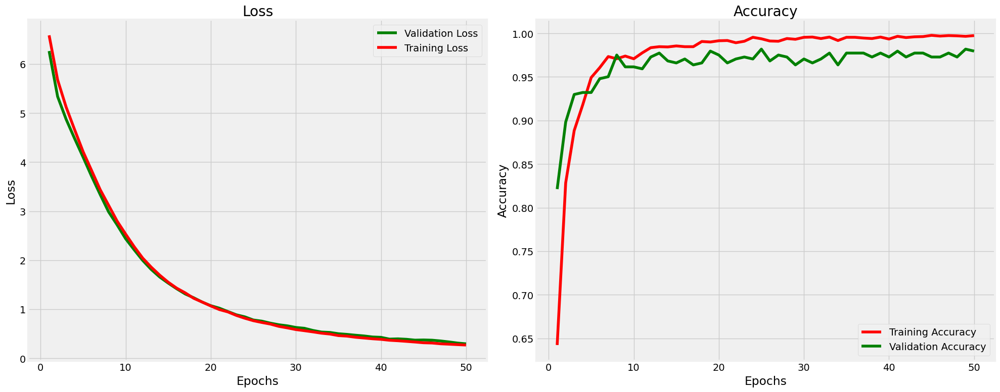

28/28 [==============================] - 1s 35ms/step - loss: 0.2826 - accuracy: 0.9842
Train Loss:  0.24265576899051666
Train Accuracy:  1.0
--------------------
Valid Loss:  0.2949348986148834
Valid Accuracy:  0.9796379804611206
--------------------
Test Loss:  0.28264549374580383
Test Accuracy:  0.9841628670692444
28/28 [==============================] - 2s 33ms/step


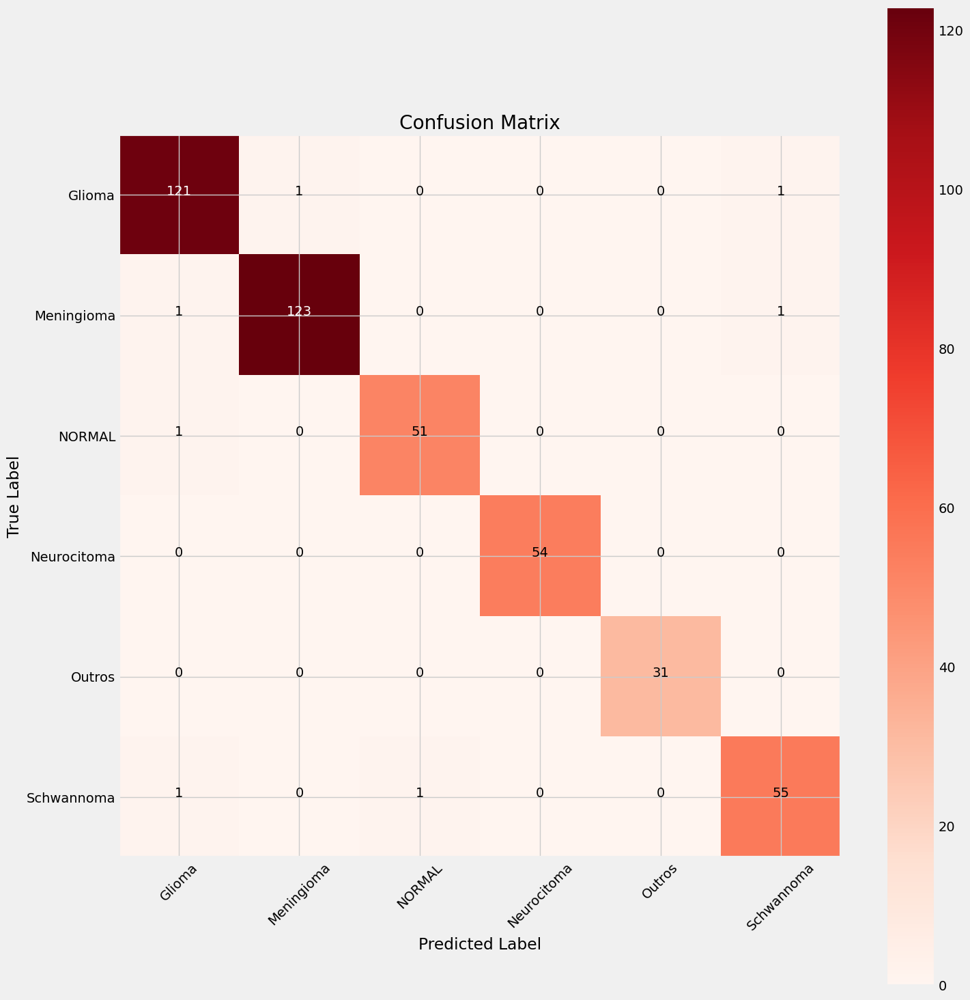

              precision    recall  f1-score   support

      Glioma       0.98      0.98      0.98       123
  Meningioma       0.99      0.98      0.99       125
      NORMAL       0.98      0.98      0.98        52
 Neurocitoma       1.00      1.00      1.00        54
      Outros       1.00      1.00      1.00        31
  Schwannoma       0.96      0.96      0.96        57

    accuracy                           0.98       442
   macro avg       0.99      0.99      0.99       442
weighted avg       0.98      0.98      0.98       442



In [10]:
# Print average accuracies over all folds
print(f"Average validation accuracy: {np.mean(val_accuracies)}")
print(f"Average test accuracy: {np.mean(test_accuracies)}")

# Optionally, you can visualize the results of the last fold
# Training accuracy and loss
tr_acc = hist.history['accuracy']
tr_loss = hist.history['loss']
val_acc = hist.history['val_accuracy']
val_loss = hist.history['val_loss']

index_acc = np.argmax(val_acc)
index_loss = np.argmin(val_loss)

val_lowest = val_loss[index_loss]
acc_highest = val_acc[index_acc]

epochs = [i + 1 for i in range(len(tr_acc))]

plt.figure(figsize=(20, 8))
plt.style.use('fivethirtyeight')

plt.subplot(1, 2, 1)
plt.plot(epochs, val_loss, c='g', label='Validation Loss')
plt.plot(epochs, tr_loss, c='r', label='Training Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.title('Loss')

plt.subplot(1, 2, 2)
plt.plot(epochs, tr_acc, c='r', label='Training Accuracy')
plt.plot(epochs, val_acc, c='g', label='Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.title('Accuracy')

plt.tight_layout()
plt.show()

# Evaluate on train, validation, and test data
train_score = model.evaluate(train_gen)
valid_score = model.evaluate(valid_gen)
test_score = model.evaluate(test_gen)

print("Train Loss: ", train_score[0])
print("Train Accuracy: ", train_score[1])
print('-' * 20)
print("Valid Loss: ", valid_score[0])
print("Valid Accuracy: ", valid_score[1])
print('-' * 20)
print("Test Loss: ", test_score[0])
print("Test Accuracy: ", test_score[1])

# Predictions and Confusion Matrix
preds = model.predict(test_gen)
y_pred = np.argmax(preds, axis=1)

g_dict = test_gen.class_indices
classes = list(g_dict.keys())

# Confusion matrix
cm = confusion_matrix(test_gen.classes, y_pred)

plt.figure(figsize=(15, 15))
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Reds)
plt.title('Confusion Matrix')
plt.colorbar()

tick_marks = np.arange(len(classes))
plt.xticks(tick_marks, classes, rotation=45)
plt.yticks(tick_marks, classes)

thresh = cm.max() / 2.
for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
    plt.text(j, i, cm[i, j], horizontalalignment='center', color='white' if cm[i, j] > thresh else 'black')

plt.tight_layout()
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.show()

# Classification report
print(classification_report(test_gen.classes, y_pred, target_names=classes))

## Dataset 3: CT and MRI (2 Class)

In [8]:
import os
import shutil

# Paths to the original folders
ct_healthy = "/kaggle/input/brain-tumor-multimodal-image-ct-and-mri/Dataset/Brain Tumor CT scan Images/Healthy"
mri_healthy = "/kaggle/input/brain-tumor-multimodal-image-ct-and-mri/Dataset/Brain Tumor MRI images/Healthy"
ct_tumor = "/kaggle/input/brain-tumor-multimodal-image-ct-and-mri/Dataset/Brain Tumor CT scan Images/Tumor"
mri_tumor = "/kaggle/input/brain-tumor-multimodal-image-ct-and-mri/Dataset/Brain Tumor MRI images/Tumor"

# New directories
base_dir = "/kaggle/working/CT_MRI_Dataset"
healthy_dir = os.path.join(base_dir, "Healthy")
tumor_dir = os.path.join(base_dir, "Tumor")

# Create directories
os.makedirs(healthy_dir, exist_ok=True)
os.makedirs(tumor_dir, exist_ok=True)

# Function to copy files
def copy_files(src_dir, dst_dir):
    for filename in os.listdir(src_dir):
        src_file = os.path.join(src_dir, filename)
        dst_file = os.path.join(dst_dir, filename)
        if os.path.isfile(src_file):
            shutil.copy(src_file, dst_file)

# Copy files to the new directories
copy_files(ct_healthy, healthy_dir)
copy_files(mri_healthy, healthy_dir)
copy_files(ct_tumor, tumor_dir)
copy_files(mri_tumor, tumor_dir)

print("Files have been organized into CT_MRI_Dataset/Healthy and CT_MRI_Dataset/Tumor directories successfully!")

Files have been organized into CT_MRI_Dataset/Healthy and CT_MRI_Dataset/Tumor directories successfully!


In [10]:
!pip install imutils

import numpy as np
from tqdm import tqdm
import cv2
import os
import imutils

def crop_img(img):
    """
    Finds the extreme points on the image and crops the rectangular out of them
    """
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    gray = cv2.GaussianBlur(gray, (3, 3), 0)

    # find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(gray.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)

    # find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    ADD_PIXELS = 0
    new_img = img[extTop[1]-ADD_PIXELS:extBot[1]+ADD_PIXELS, extLeft[0]-ADD_PIXELS:extRight[0]+ADD_PIXELS].copy()

    return new_img

if __name__ == "__main__":
    training = "/kaggle/working/CT_MRI_Dataset"
    training_dir = os.listdir(training)
    IMG_SIZE = 224

    for dir in training_dir:
        save_path = '/kaggle/working/cleaned_3/'+ dir
        path = os.path.join(training,dir)
        image_dir = os.listdir(path)
        for img in image_dir:
            image = cv2.imread(os.path.join(path,img))
            new_img = crop_img(image)
            new_img = cv2.resize(new_img,(IMG_SIZE,IMG_SIZE))
            if not os.path.exists(save_path):
                os.makedirs(save_path)
            cv2.imwrite(save_path+'/'+img, new_img)

In [12]:
import os
from PIL import Image
import itertools
from tqdm import tqdm
import cv2
import numpy as np 
import pandas as pd 
import seaborn as sn
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import regularizers
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam, Adamax
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import Dense, Flatten, Conv2D, MaxPooling2D, Activation, Dropout,BatchNormalization

import warnings
warnings.filterwarnings('ignore')

print('Modules Successfully Loaded')

Modules Successfully Loaded


In [13]:
data_dir ="/kaggle/working/cleaned_3"
paths = []
labels = []
folds = os.listdir(data_dir)
for fold in folds :
    condition_path = os.path.join(data_dir,fold)
    all_pic = os.listdir(condition_path)
    for each_pic in all_pic:
        each_pic_path = os.path.join(condition_path,each_pic)
        paths.append(each_pic_path)
        labels.append(fold.split(' ')[0])
        
pseries = pd.Series(paths, name='Picture Path')
lseries = pd.Series(labels, name='Label')

df = pd.concat([pseries, lseries], axis =1)

In [14]:
train_df, ts_df = train_test_split(df,test_size= 0.2,shuffle=True,random_state=42,stratify= df['Label'])
test_df, valid_df = train_test_split(ts_df,test_size= 0.5,shuffle=True,random_state=42,
                                          stratify= ts_df['Label'])

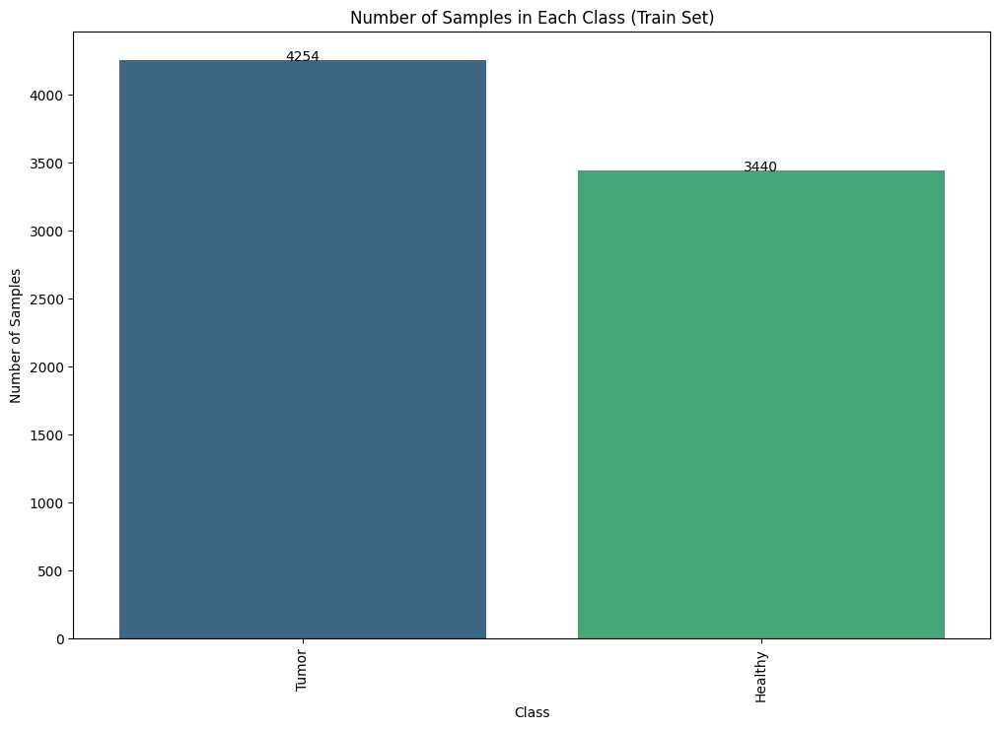

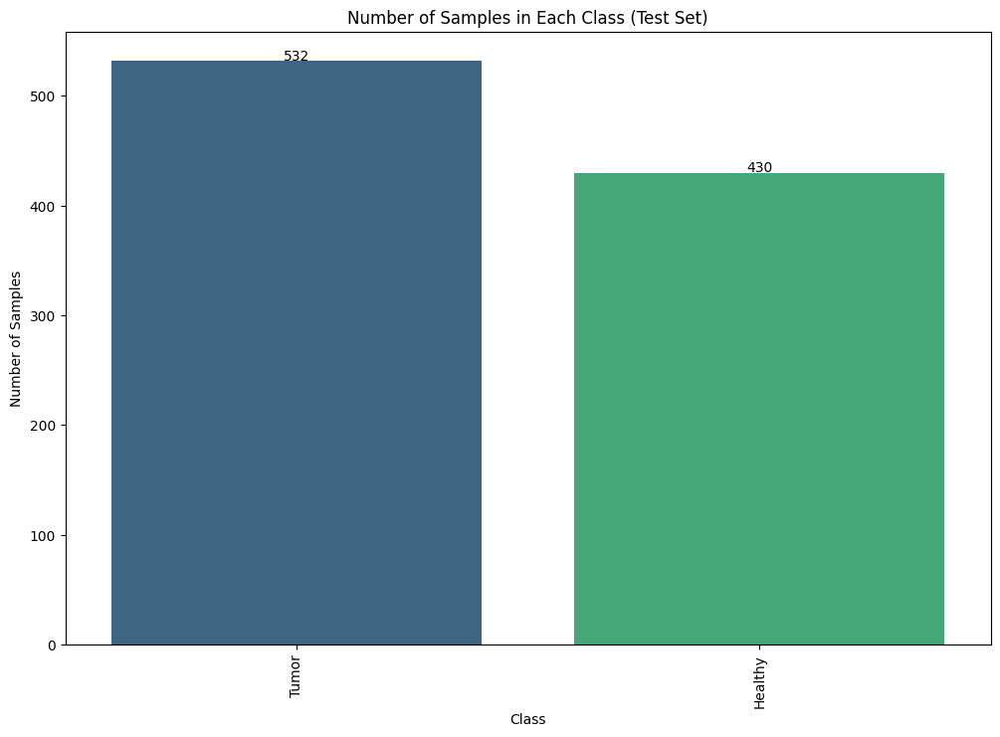

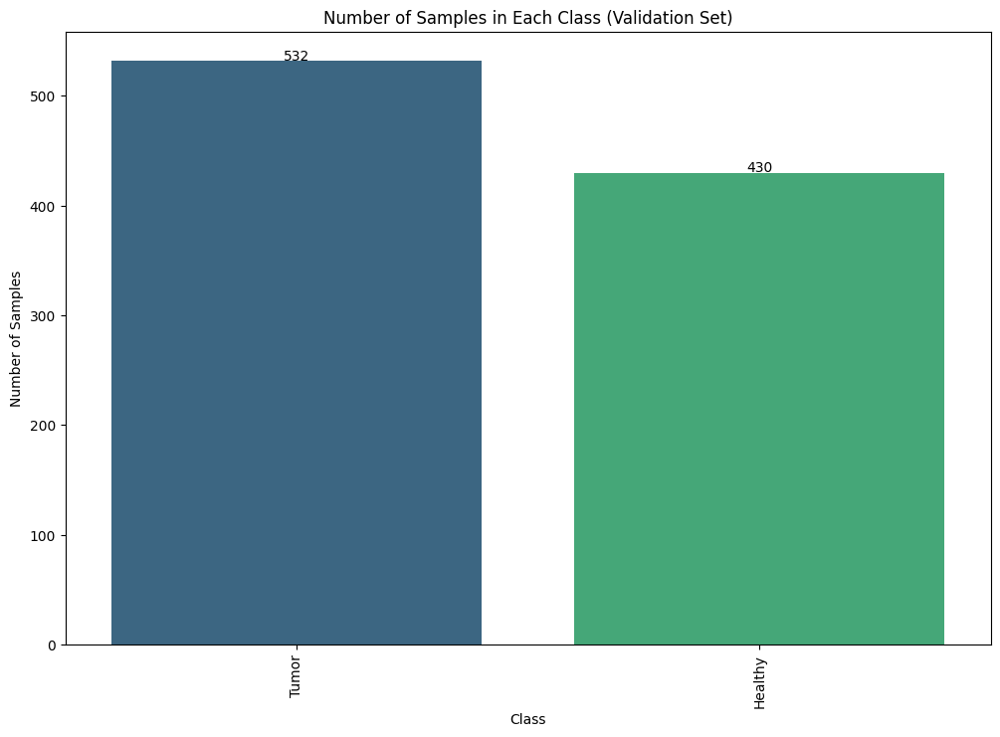

In [15]:
import matplotlib.pyplot as plt
import seaborn as sns

# Function to plot class distribution with numbers on top of the bars and vertical labels
def plot_class_distribution(df, title):
    class_counts = df['Label'].value_counts()
    plt.figure(figsize=(12, 8))
    
    sns.barplot(x=class_counts.index, y=class_counts.values, palette="viridis")
    plt.title(title)
    plt.xlabel('Class')
    plt.ylabel('Number of Samples')
    
    # Rotate class labels vertically
    plt.xticks(rotation=90)
    
    # Add number labels on top of bars
    for i in range(len(class_counts)):
        plt.text(i, class_counts.values[i] + 1, str(class_counts.values[i]), ha='center')
    
    plt.show()

# Plot class distributions for train_df, test_df, and valid_df
plot_class_distribution(train_df, 'Number of Samples in Each Class (Train Set)')
plot_class_distribution(test_df, 'Number of Samples in Each Class (Test Set)')
plot_class_distribution(valid_df, 'Number of Samples in Each Class (Validation Set)')

In [16]:
train_df

,Picture Path,Label
6080,/kaggle/working/cleaned_3/Tumor/pituitary (607...,Tumor
101,/kaggle/working/cleaned_3/Healthy/mri_healthy ...,Healthy
9283,/kaggle/working/cleaned_3/Tumor/ct_tumor (639)...,Tumor
7383,/kaggle/working/cleaned_3/Tumor/ct_tumor (1731...,Tumor
5228,/kaggle/working/cleaned_3/Tumor/ct_tumor (1465...,Tumor
...,...,...
8852,/kaggle/working/cleaned_3/Tumor/ct_tumor (1452...,Tumor
5967,/kaggle/working/cleaned_3/Tumor/meningioma (11...,Tumor
3754,/kaggle/working/cleaned_3/Healthy/ct_healthy (...,Healthy
747,/kaggle/working/cleaned_3/Healthy/ct_healthy (...,Healthy


In [17]:
valid_df

,Picture Path,Label
2839,/kaggle/working/cleaned_3/Healthy/ct_healthy (...,Healthy
1267,/kaggle/working/cleaned_3/Healthy/ct_healthy (...,Healthy
673,/kaggle/working/cleaned_3/Healthy/ct_healthy (...,Healthy
4409,/kaggle/working/cleaned_3/Tumor/meningioma (11...,Tumor
2724,/kaggle/working/cleaned_3/Healthy/mri_healthy ...,Healthy
...,...,...
5261,/kaggle/working/cleaned_3/Tumor/ct_tumor (47).jpg,Tumor
7223,/kaggle/working/cleaned_3/Tumor/pituitary (288...,Tumor
5032,/kaggle/working/cleaned_3/Tumor/ct_tumor (983)...,Tumor
7457,/kaggle/working/cleaned_3/Tumor/meningioma (10...,Tumor


In [18]:
test_df

,Picture Path,Label
4492,/kaggle/working/cleaned_3/Tumor/ct_tumor (951)...,Tumor
7075,/kaggle/working/cleaned_3/Tumor/ct_tumor (373)...,Tumor
9080,/kaggle/working/cleaned_3/Tumor/meningioma (81...,Tumor
3465,/kaggle/working/cleaned_3/Healthy/mri_healthy ...,Healthy
4936,/kaggle/working/cleaned_3/Tumor/pituitary (9).jpg,Tumor
...,...,...
9180,/kaggle/working/cleaned_3/Tumor/meningioma (90...,Tumor
7004,/kaggle/working/cleaned_3/Tumor/ct_tumor (1959...,Tumor
895,/kaggle/working/cleaned_3/Healthy/mri_healthy ...,Healthy
9464,/kaggle/working/cleaned_3/Tumor/tumor (239).jpg,Tumor


In [19]:
batch_size = 16
img_size = (224,224)

gen = ImageDataGenerator()

train_gen = gen.flow_from_dataframe(train_df, x_col='Picture Path', y_col='Label',target_size= img_size, 
                                   class_mode= 'categorical', color_mode='rgb', shuffle = True,
                                   batch_size= batch_size)

valid_gen = gen.flow_from_dataframe(valid_df, x_col='Picture Path', y_col='Label',target_size= img_size, 
                                   class_mode= 'categorical', color_mode='rgb', shuffle = True,
                                   batch_size= batch_size)

test_gen = gen.flow_from_dataframe(test_df, x_col='Picture Path', y_col='Label',target_size= img_size, 
                                   class_mode= 'categorical', color_mode='rgb', shuffle = False,
                                   batch_size= batch_size)
g_dict = train_gen.class_indices
classes= list(g_dict.keys())

images, labels = next(train_gen)

Found 7694 validated image filenames belonging to 2 classes.
Found 962 validated image filenames belonging to 2 classes.
Found 962 validated image filenames belonging to 2 classes.


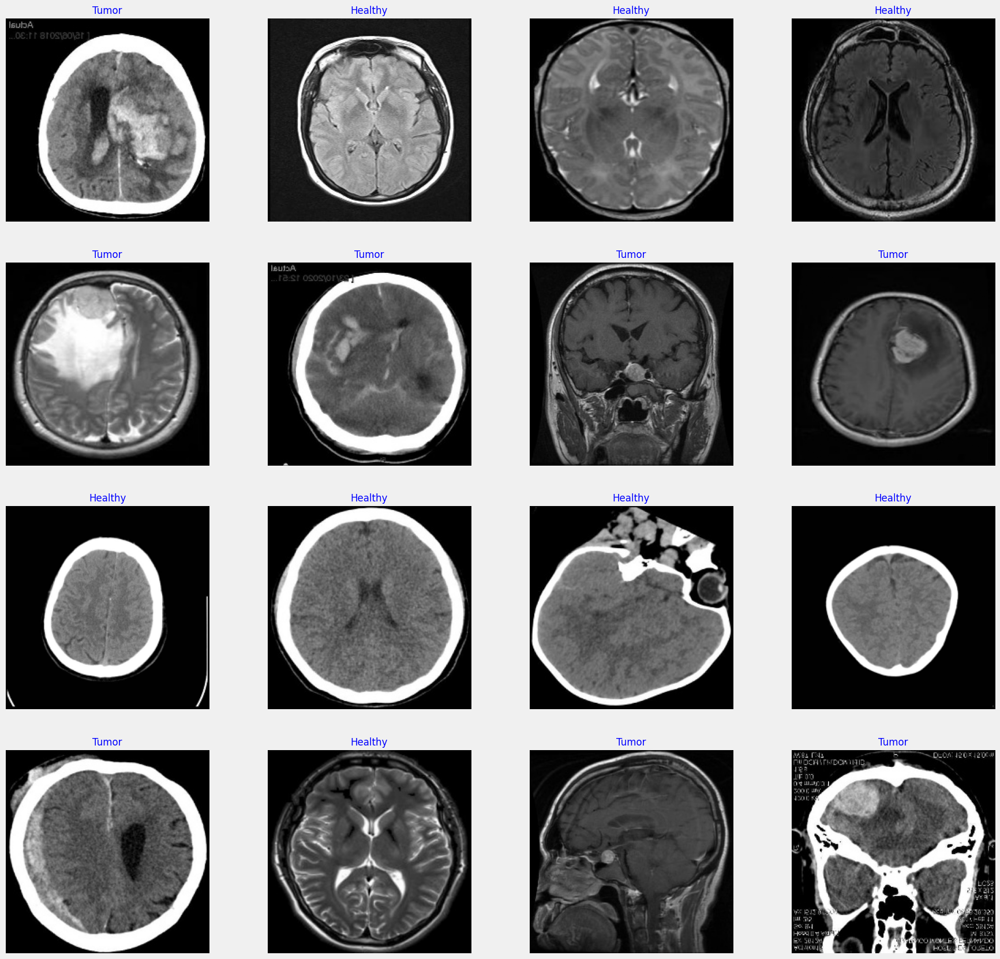

In [37]:
plt.figure(figsize= (20,20))

for i in range (16):
    plt.subplot(4,4,i+1)
    image = images[i] / 255
    plt.imshow(image)
    index= np.argmax(labels[i]) #[0,0,0,1,0]
    class_name = classes[index]
    plt.title(class_name,c='b', fontsize=12)
    plt.axis('off')
plt.show()

In [31]:
import tensorflow as tf
from tensorflow.keras import layers, models, regularizers
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.applications import EfficientNetV2B0
from tensorflow.keras.models import Model
from tensorflow.keras.layers import (
    GlobalAveragePooling2D, Dense, Dropout,
    BatchNormalization, GaussianNoise, Input,
    MultiHeadAttention, Reshape
)
from tensorflow.keras.optimizers import Adamax

# Check if GPU is available
physical_devices = tf.config.list_physical_devices('GPU')
if physical_devices:
    print("Using GPU")
else:
    print("Using CPU")

# Early stopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

def create_model(input_shape, num_classes=2, learning_rate=0.0001):
    inputs = Input(shape=input_shape, name="Input_Layer")
    
    base_model = EfficientNetV2B0(weights='imagenet', input_tensor=inputs, include_top=False)
    
    x = base_model.output
    height, width, channels = x.shape[1], x.shape[2], x.shape[3]
    
    x = Reshape((height * width, channels), name="Reshape_to_Sequence")(x)
    
    attention_output = MultiHeadAttention(num_heads=8, key_dim=channels, name="Multi_Head_Attention")(x, x)
    
    attention_output = Reshape((height, width, channels), name="Reshape_to_Spatial")(attention_output)
    
    x = GlobalAveragePooling2D(name="Global_Avg_Pooling")(attention_output)
    x = Dense(512, activation='relu', name="FC_512")(x)
    x = BatchNormalization(axis=-1, momentum=0.99, epsilon=0.001, name="Batch_Normalization")(x)
    x = Dense(256, kernel_regularizer=regularizers.l2(0.016), activity_regularizer=regularizers.l1(0.006),
              bias_regularizer=regularizers.l1(0.006), activation='relu', name="FC_256")(x)
    x = Dropout(0.45, seed=123, name="Dropout")(x)
    
    outputs = Dense(num_classes, activation='sigmoid', name="Output_Layer")(x)
    
    model = Model(inputs=inputs, outputs=outputs, name="Model_with_Attention")
    model.compile(optimizer=Adamax(learning_rate=learning_rate), loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

input_shape = (224, 224, 3)
model = create_model(input_shape, num_classes=2, learning_rate=0.0001)

Using GPU


In [32]:
model.summary()

Model: "Model_with_Attention"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 Input_Layer (InputLayer)    [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 rescaling_3 (Rescaling)     (None, 224, 224, 3)          0         ['Input_Layer[0][0]']         
                                                                                                  
 normalization_3 (Normaliza  (None, 224, 224, 3)          0         ['rescaling_3[0][0]']         
 tion)                                                                                            
                                                                                                  
 stem_conv (Conv2D)          (None, 112, 112, 32)         864       ['normaliza

In [33]:
hist= model.fit(train_gen, epochs= 10, callbacks = [early_stopping],
                verbose= 1, validation_data= valid_gen, shuffle= False)

Epoch 1/10


2025-01-29 17:57:00.704782: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inModel_with_Attention/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


481/481 [==============================] - 90s 123ms/step - loss: 4.5530 - accuracy: 0.9299 - val_loss: 3.3166 - val_accuracy: 0.9678
Epoch 2/10
481/481 [==============================] - 57s 119ms/step - loss: 2.5174 - accuracy: 0.9656 - val_loss: 1.8419 - val_accuracy: 0.9719
Epoch 3/10
481/481 [==============================] - 57s 119ms/step - loss: 1.4001 - accuracy: 0.9741 - val_loss: 1.0567 - val_accuracy: 0.9730
Epoch 4/10
481/481 [==============================] - 58s 120ms/step - loss: 0.8291 - accuracy: 0.9805 - val_loss: 0.6557 - val_accuracy: 0.9782
Epoch 5/10
481/481 [==============================] - 57s 119ms/step - loss: 0.5501 - accuracy: 0.9845 - val_loss: 0.4621 - val_accuracy: 0.9854
Epoch 6/10
481/481 [==============================] - 57s 119ms/step - loss: 0.4206 - accuracy: 0.9828 - val_loss: 0.3760 - val_accuracy: 0.9875
Epoch 7/10
481/481 [==============================] - 58s 120ms/step - loss: 0.3429 - accuracy: 0.9909 - val_loss: 0.3096 - val_accuracy: 0.9

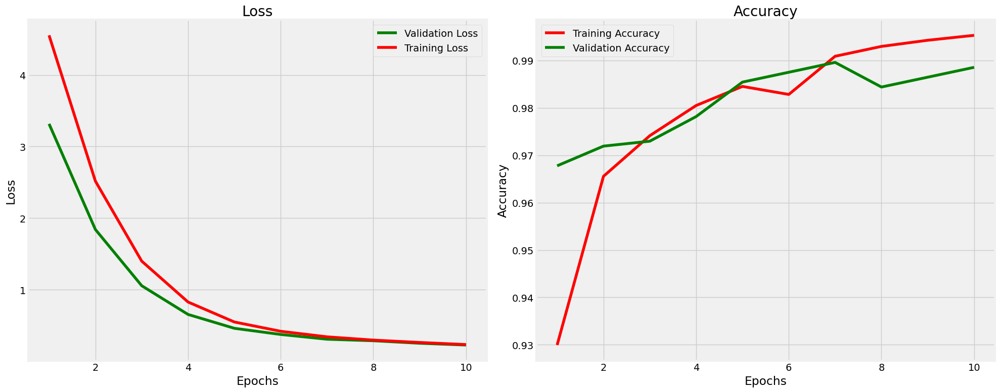

61/61 [==============================] - 2s 34ms/step - loss: 0.2180 - accuracy: 0.9938
Train Loss:  0.2002938985824585
Train Accuracy:  0.9997400641441345
--------------------
Valid Loss:  0.228506937623024
Valid Accuracy:  0.9885655045509338
--------------------
Test Loss:  0.21797333657741547
Test Accuracy:  0.9937629699707031


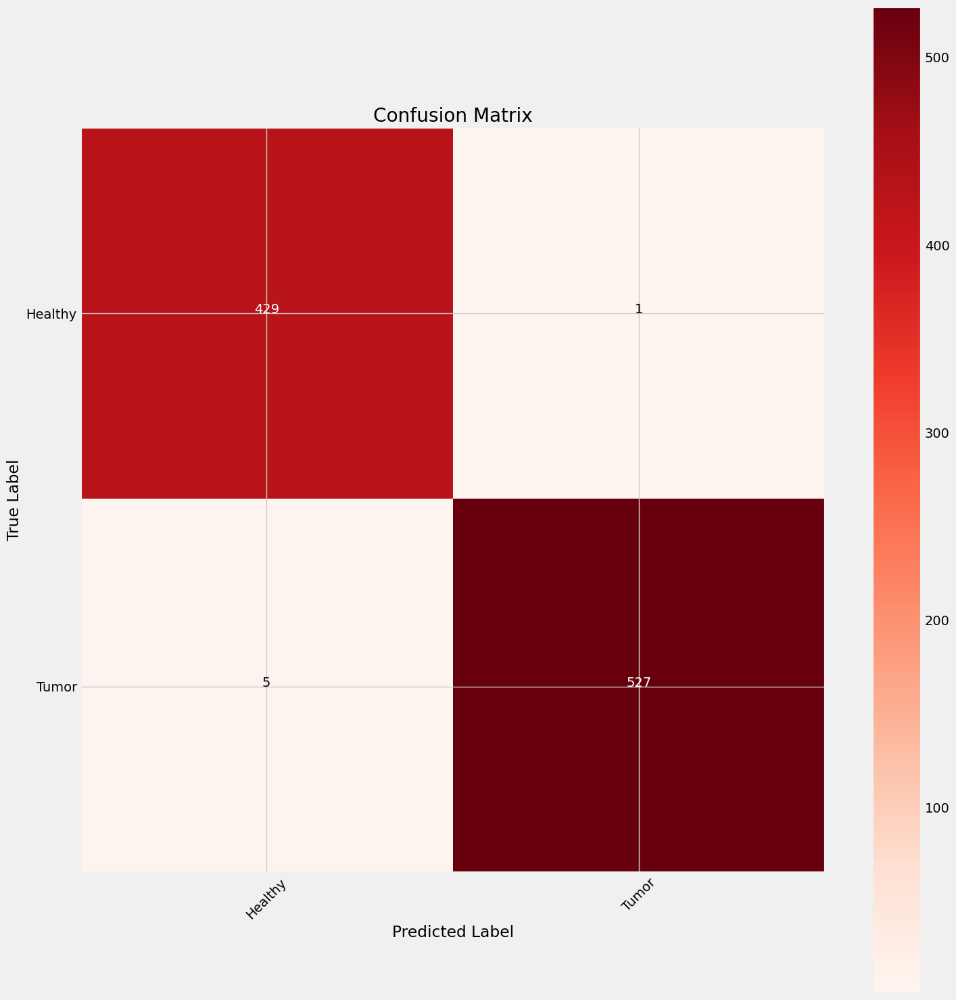

              precision    recall  f1-score   support

     Healthy       0.99      1.00      0.99       430
       Tumor       1.00      0.99      0.99       532

    accuracy                           0.99       962
   macro avg       0.99      0.99      0.99       962
weighted avg       0.99      0.99      0.99       962



In [34]:
tr_acc = hist.history['accuracy']
tr_loss = hist.history['loss']
val_acc = hist.history['val_accuracy']
val_loss = hist.history['val_loss']

index_acc = np.argmax(val_acc)
index_loss = np.argmin(val_loss)

val_lowest=val_loss[index_loss]
acc_highest=val_acc[index_acc]

epochs = [i+1 for i in range(len(tr_acc))]

loss_label = f'best epoch = {str(index_loss+1)}'
acc_label =  f'best epoch = {str(index_acc+1)} '

plt.figure(figsize= (20,8))
plt.style.use('fivethirtyeight')

plt.subplot(1,2,1)
plt.plot(epochs,val_loss,c='g',label= 'Validation Loss')
plt.plot(epochs,tr_loss,c='r',label= 'Training Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.title('Loss')

plt.subplot(1,2,2)
plt.plot(epochs, tr_acc, c='r', label= 'Training Accuracy')
plt.plot(epochs, val_acc, c='g', label= 'Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.title('Accuracy')

plt.tight_layout()
plt.show()

train_score= model.evaluate(train_gen)
valid_score= model.evaluate(valid_gen)
test_score=  model.evaluate(test_gen)

print("Train Loss: ", train_score[0])
print("Train Accuracy: ", train_score[1])
print('-' * 20)
print("Valid Loss: ", valid_score[0])
print("Valid Accuracy: ", valid_score[1])
print('-' * 20)
print("Test Loss: ", test_score[0])
print("Test Accuracy: ", test_score[1])

preds = model.predict_generator(test_gen)
y_pred= np.argmax(preds,axis=1)

g_dict = test_gen.class_indices
classes = list(g_dict.keys())

# Confusion matrix
cm = confusion_matrix(test_gen.classes, y_pred)

plt.figure(figsize= (15, 15))
plt.imshow(cm, interpolation= 'nearest', cmap= plt.cm.Reds)
plt.title('Confusion Matrix')
plt.colorbar()

tick_marks = np.arange(len(classes))
plt.xticks(tick_marks, classes, rotation= 45)
plt.yticks(tick_marks, classes)


thresh = cm.max() / 2.
for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])): #(5,5)
    plt.text(j, i, cm[i, j], horizontalalignment= 'center', color= 'white' if cm[i, j] > thresh else 'black')
    
plt.tight_layout()
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.show()

from sklearn.metrics import classification_report
# Display classification report
print(classification_report(test_gen.classes, y_pred, target_names=classes))

In [35]:
model.save('effnetv2b0_multi_head_attention_dataset3.h5')

## Dataset 3: 5 fold cross validation

Modules loaded successfully.
Found 7694 validated image filenames belonging to 2 classes.
Found 962 validated image filenames belonging to 2 classes.
Found 962 validated image filenames belonging to 2 classes.
Epoch 1/10


2025-01-29 18:14:55.524513: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inModel_with_Attention/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


481/481 [==============================] - 90s 124ms/step - loss: 4.5760 - accuracy: 0.9286 - val_loss: 3.3268 - val_accuracy: 0.9699
Epoch 2/10
481/481 [==============================] - 58s 120ms/step - loss: 2.5452 - accuracy: 0.9649 - val_loss: 1.8431 - val_accuracy: 0.9875
Epoch 3/10
481/481 [==============================] - 58s 120ms/step - loss: 1.4411 - accuracy: 0.9767 - val_loss: 1.0733 - val_accuracy: 0.9844
Epoch 4/10
481/481 [==============================] - 57s 119ms/step - loss: 0.8759 - accuracy: 0.9810 - val_loss: 0.6757 - val_accuracy: 0.9896
Epoch 5/10
481/481 [==============================] - 57s 119ms/step - loss: 0.5972 - accuracy: 0.9844 - val_loss: 0.4889 - val_accuracy: 0.9917
Epoch 6/10
481/481 [==============================] - 57s 119ms/step - loss: 0.4514 - accuracy: 0.9901 - val_loss: 0.3900 - val_accuracy: 0.9906
Epoch 7/10
481/481 [==============================] - 57s 119ms/step - loss: 0.3721 - accuracy: 0.9904 - val_loss: 0.3248 - val_accuracy: 0.9

2025-01-29 18:25:08.566267: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inModel_with_Attention/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


481/481 [==============================] - 90s 123ms/step - loss: 4.6061 - accuracy: 0.9292 - val_loss: 3.4124 - val_accuracy: 0.9553
Epoch 2/10
481/481 [==============================] - 57s 119ms/step - loss: 2.6178 - accuracy: 0.9622 - val_loss: 1.9163 - val_accuracy: 0.9802
Epoch 3/10
481/481 [==============================] - 57s 119ms/step - loss: 1.4863 - accuracy: 0.9748 - val_loss: 1.1207 - val_accuracy: 0.9844
Epoch 4/10
481/481 [==============================] - 57s 119ms/step - loss: 0.9035 - accuracy: 0.9779 - val_loss: 0.7199 - val_accuracy: 0.9844
Epoch 5/10
481/481 [==============================] - 57s 119ms/step - loss: 0.6116 - accuracy: 0.9847 - val_loss: 0.5168 - val_accuracy: 0.9854
Epoch 6/10
481/481 [==============================] - 57s 119ms/step - loss: 0.4777 - accuracy: 0.9860 - val_loss: 0.4285 - val_accuracy: 0.9875
Epoch 7/10
481/481 [==============================] - 57s 119ms/step - loss: 0.3980 - accuracy: 0.9908 - val_loss: 0.3672 - val_accuracy: 0.9

2025-01-29 18:35:20.079013: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inModel_with_Attention/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


481/481 [==============================] - 89s 123ms/step - loss: 4.5227 - accuracy: 0.9271 - val_loss: 3.2457 - val_accuracy: 0.9678
Epoch 2/10
481/481 [==============================] - 57s 119ms/step - loss: 2.4552 - accuracy: 0.9637 - val_loss: 1.7647 - val_accuracy: 0.9782
Epoch 3/10
481/481 [==============================] - 57s 119ms/step - loss: 1.3439 - accuracy: 0.9756 - val_loss: 0.9838 - val_accuracy: 0.9771
Epoch 4/10
481/481 [==============================] - 57s 119ms/step - loss: 0.7889 - accuracy: 0.9834 - val_loss: 0.6079 - val_accuracy: 0.9865
Epoch 5/10
481/481 [==============================] - 57s 119ms/step - loss: 0.5303 - accuracy: 0.9862 - val_loss: 0.4604 - val_accuracy: 0.9813
Epoch 6/10
481/481 [==============================] - 57s 119ms/step - loss: 0.4117 - accuracy: 0.9891 - val_loss: 0.3647 - val_accuracy: 0.9865
Epoch 7/10
481/481 [==============================] - 57s 119ms/step - loss: 0.3416 - accuracy: 0.9912 - val_loss: 0.3161 - val_accuracy: 0.9

2025-01-29 18:45:33.249538: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inModel_with_Attention/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


481/481 [==============================] - 91s 124ms/step - loss: 4.5572 - accuracy: 0.9240 - val_loss: 3.3173 - val_accuracy: 0.9605
Epoch 2/10
481/481 [==============================] - 57s 119ms/step - loss: 2.5099 - accuracy: 0.9652 - val_loss: 1.8313 - val_accuracy: 0.9740
Epoch 3/10
481/481 [==============================] - 57s 119ms/step - loss: 1.3912 - accuracy: 0.9786 - val_loss: 1.0420 - val_accuracy: 0.9782
Epoch 4/10
481/481 [==============================] - 57s 119ms/step - loss: 0.8482 - accuracy: 0.9792 - val_loss: 0.6793 - val_accuracy: 0.9802
Epoch 5/10
481/481 [==============================] - 57s 119ms/step - loss: 0.5870 - accuracy: 0.9860 - val_loss: 0.4982 - val_accuracy: 0.9844
Epoch 6/10
481/481 [==============================] - 57s 119ms/step - loss: 0.4550 - accuracy: 0.9874 - val_loss: 0.4087 - val_accuracy: 0.9792
Epoch 7/10
481/481 [==============================] - 57s 119ms/step - loss: 0.3704 - accuracy: 0.9897 - val_loss: 0.3352 - val_accuracy: 0.9

2025-01-29 18:55:45.823799: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inModel_with_Attention/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


481/481 [==============================] - 89s 123ms/step - loss: 4.5213 - accuracy: 0.9284 - val_loss: 3.2457 - val_accuracy: 0.9709
Epoch 2/10
481/481 [==============================] - 57s 119ms/step - loss: 2.4703 - accuracy: 0.9647 - val_loss: 1.8001 - val_accuracy: 0.9802
Epoch 3/10
481/481 [==============================] - 57s 119ms/step - loss: 1.4090 - accuracy: 0.9745 - val_loss: 1.0643 - val_accuracy: 0.9813
Epoch 4/10
481/481 [==============================] - 57s 119ms/step - loss: 0.8877 - accuracy: 0.9795 - val_loss: 0.7122 - val_accuracy: 0.9865
Epoch 5/10
481/481 [==============================] - 57s 119ms/step - loss: 0.6180 - accuracy: 0.9879 - val_loss: 0.5175 - val_accuracy: 0.9886
Epoch 6/10
481/481 [==============================] - 57s 119ms/step - loss: 0.4739 - accuracy: 0.9887 - val_loss: 0.4200 - val_accuracy: 0.9854
Epoch 7/10
481/481 [==============================] - 57s 119ms/step - loss: 0.3857 - accuracy: 0.9943 - val_loss: 0.3469 - val_accuracy: 0.9

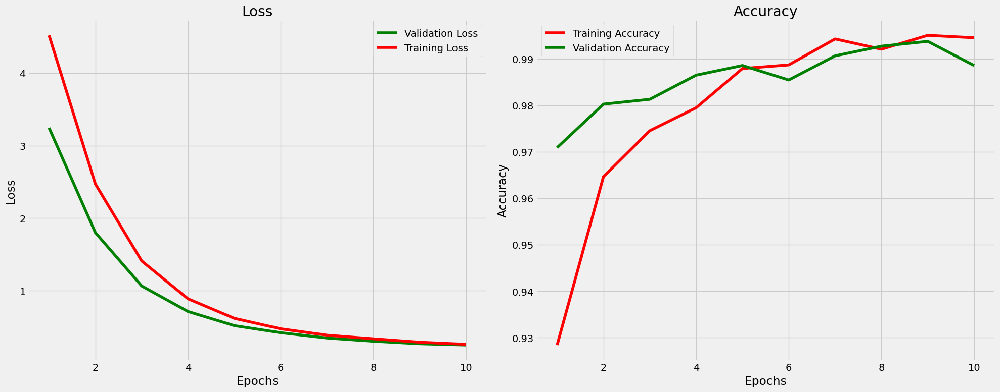

61/61 [==============================] - 2s 35ms/step - loss: 0.2491 - accuracy: 0.9896
Train Loss:  0.22455629706382751
Train Accuracy:  0.9996101260185242
--------------------
Valid Loss:  0.25017186999320984
Valid Accuracy:  0.9885655045509338
--------------------
Test Loss:  0.24912483990192413
Test Accuracy:  0.9895941615104675
61/61 [==============================] - 3s 32ms/step


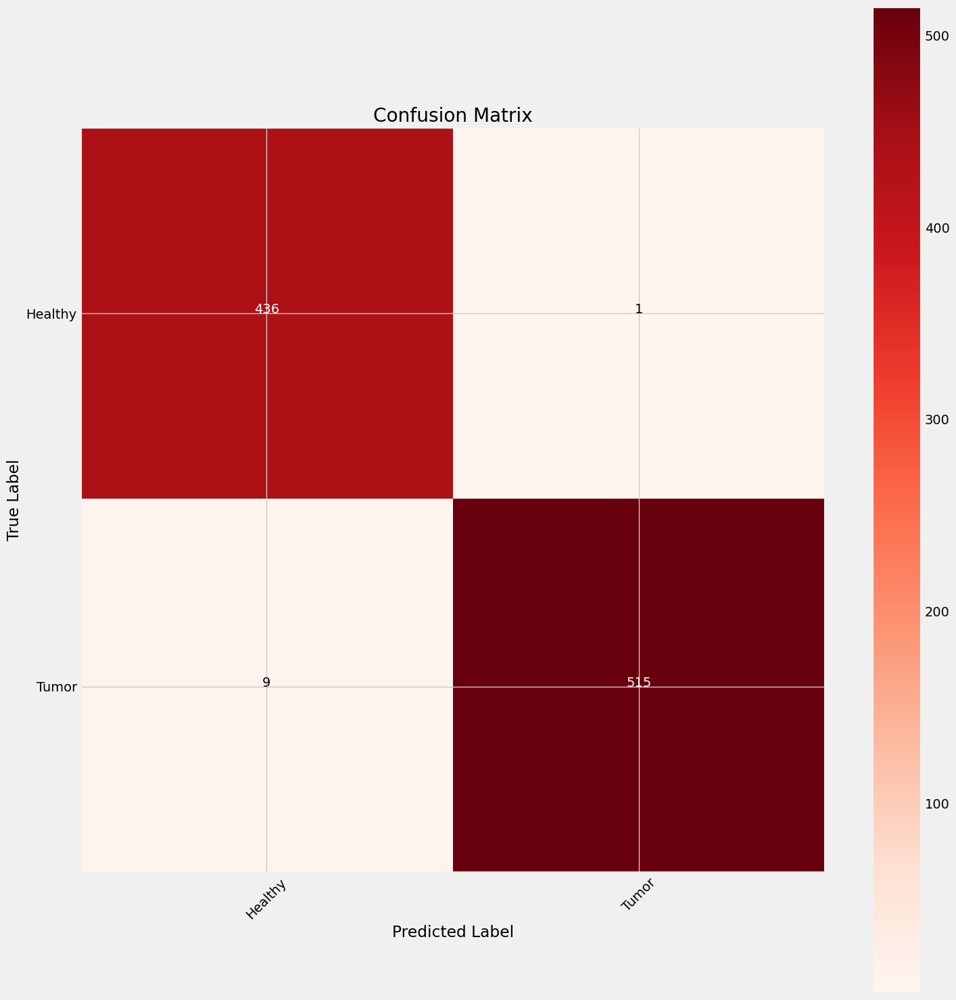

              precision    recall  f1-score   support

     Healthy       0.98      1.00      0.99       437
       Tumor       1.00      0.98      0.99       524

    accuracy                           0.99       961
   macro avg       0.99      0.99      0.99       961
weighted avg       0.99      0.99      0.99       961



In [38]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import KFold, train_test_split
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.applications import EfficientNetV2B0
from tensorflow.keras.models import Model
from tensorflow.keras.layers import (
    GlobalAveragePooling2D, Dense, Dropout,
    BatchNormalization, GaussianNoise, Input,
    MultiHeadAttention, Reshape
)
from tensorflow.keras.optimizers import Adamax
from sklearn.metrics import classification_report, confusion_matrix
import itertools

print('Modules loaded successfully.')

# Data preparation
data_dir = "/kaggle/working/cleaned_3"
paths = []
labels = []
folds = os.listdir(data_dir)
for fold in folds:
    condition_path = os.path.join(data_dir, fold)
    all_pic = os.listdir(condition_path)
    for each_pic in all_pic:
        each_pic_path = os.path.join(condition_path, each_pic)
        paths.append(each_pic_path)
        labels.append(fold.split(' ')[0])

# Create DataFrame
pseries = pd.Series(paths, name='Picture Path')
lseries = pd.Series(labels, name='Label')
df = pd.concat([pseries, lseries], axis=1)

# Image generator
batch_size = 16
img_size = (224, 224)
gen = ImageDataGenerator()

# Initialize variables to store results
val_accuracies = []
test_accuracies = []

# Set up KFold cross-validation
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Start KFold Cross-validation
for train_index, val_index in kf.split(df):
    train_df, val_df = df.iloc[train_index], df.iloc[val_index]

    # Further split val_df into validation and test sets
    test_df, valid_df = train_test_split(val_df, test_size=0.5, shuffle=True, random_state=42, stratify=val_df['Label'])

    # Create generators for train, validation, and test
    train_gen = gen.flow_from_dataframe(train_df, x_col='Picture Path', y_col='Label', target_size=img_size, 
                                       class_mode='categorical', color_mode='rgb', shuffle=True, batch_size=batch_size)

    valid_gen = gen.flow_from_dataframe(valid_df, x_col='Picture Path', y_col='Label', target_size=img_size, 
                                       class_mode='categorical', color_mode='rgb', shuffle=True, batch_size=batch_size)

    test_gen = gen.flow_from_dataframe(test_df, x_col='Picture Path', y_col='Label', target_size=img_size, 
                                      class_mode='categorical', color_mode='rgb', shuffle=False, batch_size=batch_size)

    # Define the model
    def create_model(input_shape, num_classes=2, learning_rate=0.0001):
        inputs = Input(shape=input_shape, name="Input_Layer")
        
        base_model = EfficientNetV2B0(weights='imagenet', input_tensor=inputs, include_top=False)
        
        x = base_model.output
        height, width, channels = x.shape[1], x.shape[2], x.shape[3]
        
        x = Reshape((height * width, channels), name="Reshape_to_Sequence")(x)
        
        attention_output = MultiHeadAttention(num_heads=8, key_dim=channels, name="Multi_Head_Attention")(x, x)
        
        attention_output = Reshape((height, width, channels), name="Reshape_to_Spatial")(attention_output)
        
        x = GlobalAveragePooling2D(name="Global_Avg_Pooling")(attention_output)
        x = Dense(512, activation='relu', name="FC_512")(x)
        x = BatchNormalization(axis=-1, momentum=0.99, epsilon=0.001, name="Batch_Normalization")(x)
        x = Dense(256, kernel_regularizer=tf.keras.regularizers.l2(0.016),
                  activity_regularizer=tf.keras.regularizers.l1(0.006),
                  bias_regularizer=tf.keras.regularizers.l1(0.006),
                  activation='relu', name="FC_256")(x)
        x = Dropout(0.45, seed=123, name="Dropout")(x)
        
        outputs = Dense(num_classes, activation='sigmoid', name="Output_Layer")(x)
        
        model = Model(inputs=inputs, outputs=outputs, name="Model_with_Attention")
        model.compile(optimizer=Adamax(learning_rate=learning_rate), loss='binary_crossentropy', metrics=['accuracy'])
        
        return model

    input_shape = (224, 224, 3)
    model = create_model(input_shape, num_classes=2, learning_rate=0.0001)

    # Early stopping callback
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

    # Train the model
    hist = model.fit(train_gen, epochs=10, callbacks=[early_stopping],
                     validation_data=valid_gen, verbose=1, shuffle=False)

    # Evaluate model
    val_score = model.evaluate(valid_gen)
    test_score = model.evaluate(test_gen)

    val_accuracies.append(val_score[1])  # validation accuracy
    test_accuracies.append(test_score[1])  # test accuracy

# Print average accuracies over all folds
print(f"Average validation accuracy: {np.mean(val_accuracies)}")
print(f"Average test accuracy: {np.mean(test_accuracies)}")

# Optionally, you can visualize the results of the last fold
# Training accuracy and loss
tr_acc = hist.history['accuracy']
tr_loss = hist.history['loss']
val_acc = hist.history['val_accuracy']
val_loss = hist.history['val_loss']

index_acc = np.argmax(val_acc)
index_loss = np.argmin(val_loss)

val_lowest = val_loss[index_loss]
acc_highest = val_acc[index_acc]

epochs = [i + 1 for i in range(len(tr_acc))]

plt.figure(figsize=(20, 8))
plt.style.use('fivethirtyeight')

plt.subplot(1, 2, 1)
plt.plot(epochs, val_loss, c='g', label='Validation Loss')
plt.plot(epochs, tr_loss, c='r', label='Training Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.title('Loss')

plt.subplot(1, 2, 2)
plt.plot(epochs, tr_acc, c='r', label='Training Accuracy')
plt.plot(epochs, val_acc, c='g', label='Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.title('Accuracy')

plt.tight_layout()
plt.show()

# Evaluate on train, validation, and test data
train_score = model.evaluate(train_gen)
valid_score = model.evaluate(valid_gen)
test_score = model.evaluate(test_gen)

print("Train Loss: ", train_score[0])
print("Train Accuracy: ", train_score[1])
print('-' * 20)
print("Valid Loss: ", valid_score[0])
print("Valid Accuracy: ", valid_score[1])
print('-' * 20)
print("Test Loss: ", test_score[0])
print("Test Accuracy: ", test_score[1])

# Predictions and Confusion Matrix
preds = model.predict(test_gen)
y_pred = np.argmax(preds, axis=1)

g_dict = test_gen.class_indices
classes = list(g_dict.keys())

# Confusion matrix
cm = confusion_matrix(test_gen.classes, y_pred)

plt.figure(figsize=(15, 15))
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Reds)
plt.title('Confusion Matrix')
plt.colorbar()

tick_marks = np.arange(len(classes))
plt.xticks(tick_marks, classes, rotation=45)
plt.yticks(tick_marks, classes)

thresh = cm.max() / 2.
for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
    plt.text(j, i, cm[i, j], horizontalalignment='center', color='white' if cm[i, j] > thresh else 'black')

plt.tight_layout()
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.show()

# Classification report
print(classification_report(test_gen.classes, y_pred, target_names=classes))

## Grad-CAM Analysis for Explainability of Proposed Model Framework

### Dataset 3 - Grad-CAM Analysis

1/1 [==============================] - 2s 2s/step


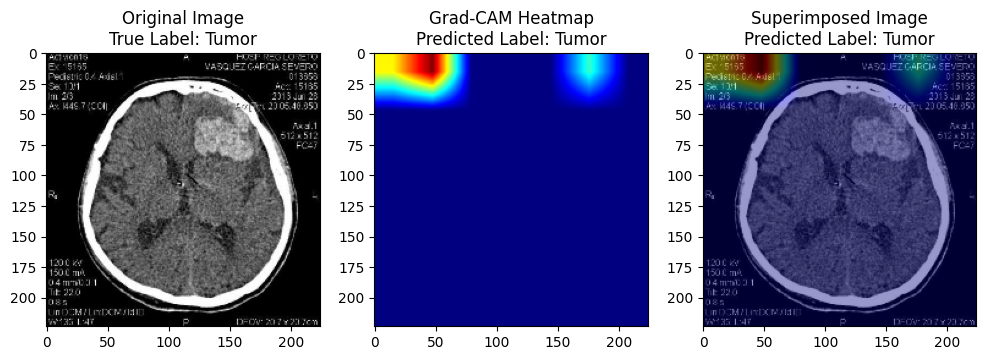

1/1 [==============================] - 0s 28ms/step


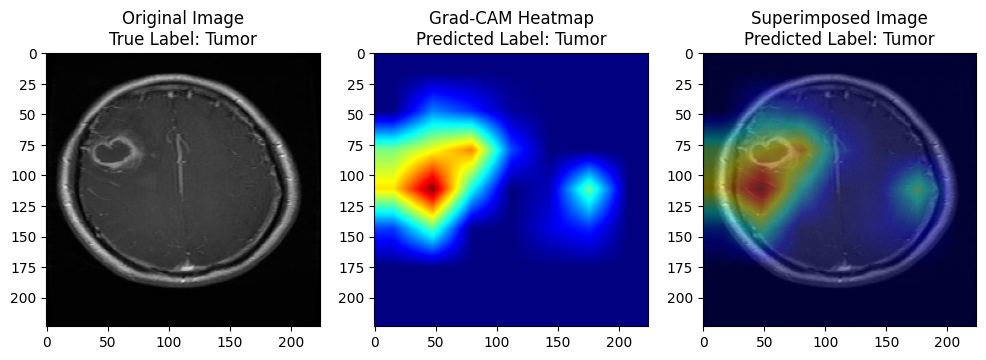

1/1 [==============================] - 0s 27ms/step


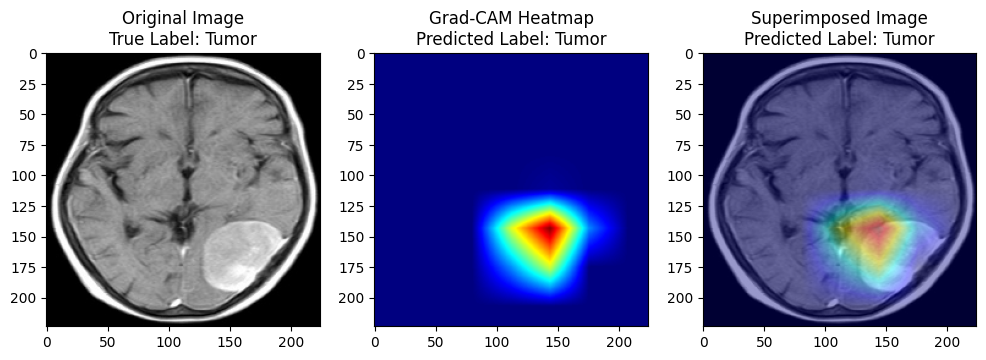

1/1 [==============================] - 0s 27ms/step


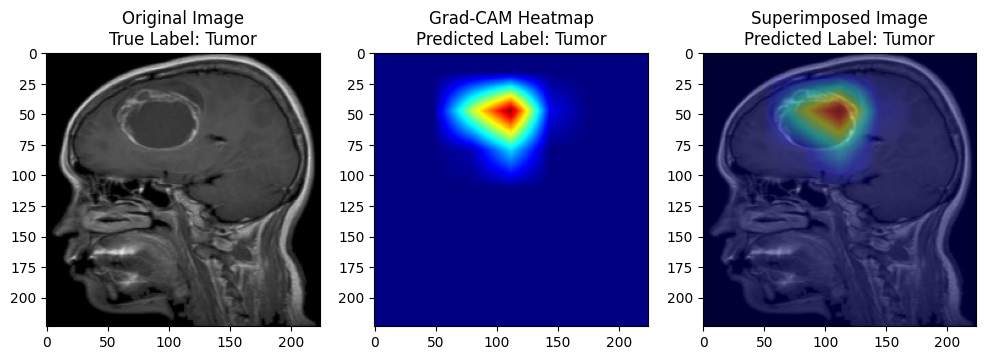

1/1 [==============================] - 0s 27ms/step


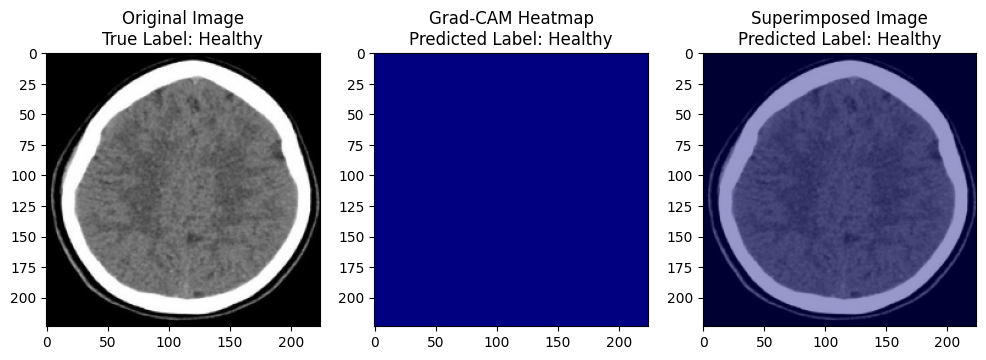

1/1 [==============================] - 0s 27ms/step


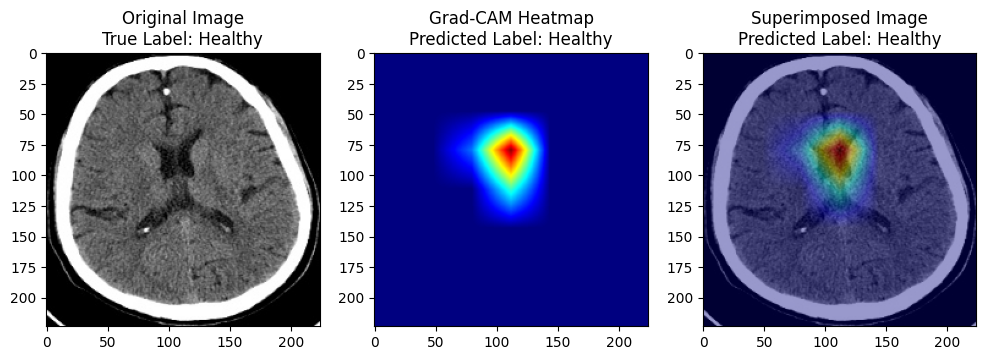

1/1 [==============================] - 0s 27ms/step


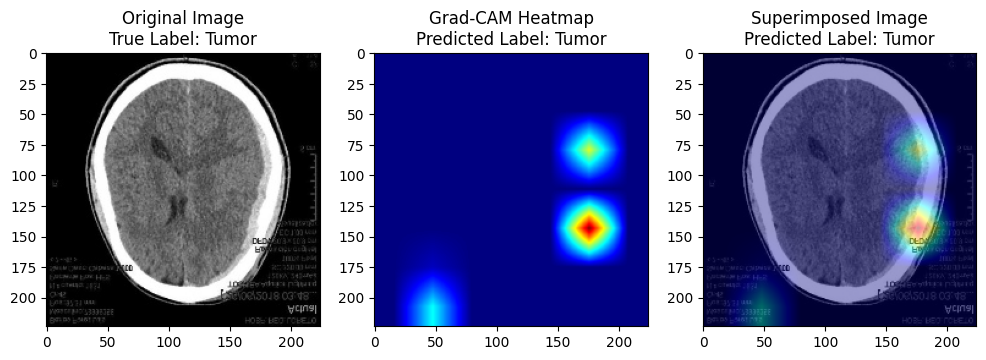

1/1 [==============================] - 0s 32ms/step


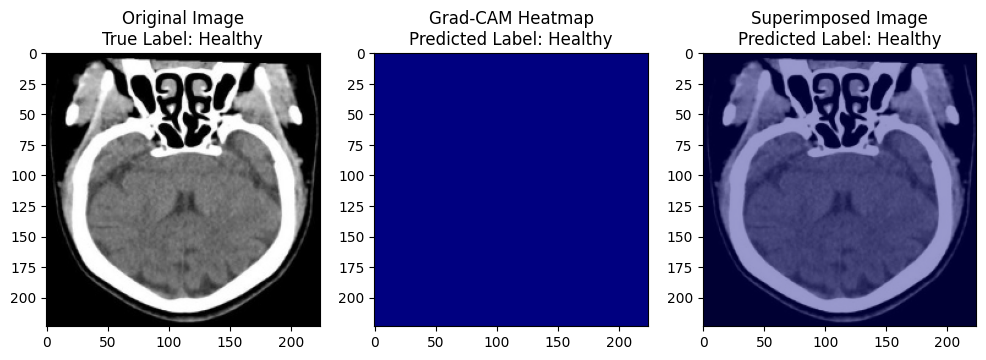

1/1 [==============================] - 0s 32ms/step


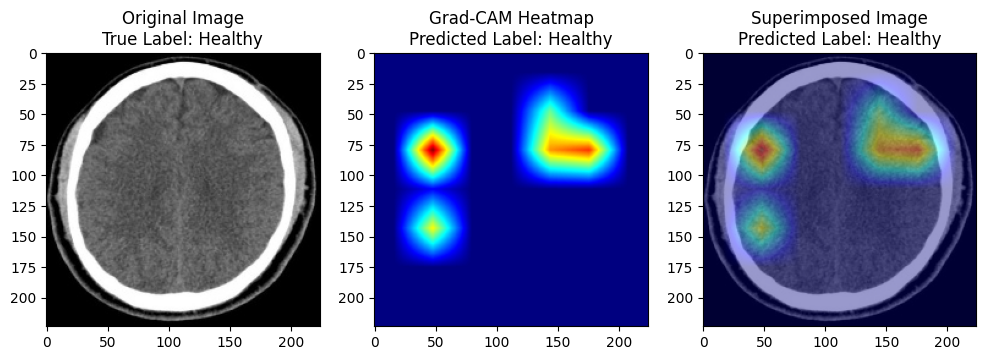

1/1 [==============================] - 0s 31ms/step


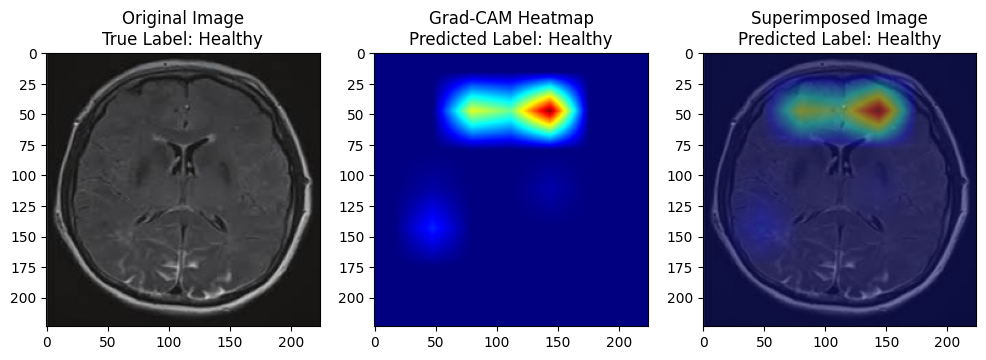

In [15]:
import cv2
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing import image
import matplotlib.pyplot as plt
import os
import random

# Load your pre-trained model
model_path = '/kaggle/working/effnetv2b0_multi_head_attention_dataset3.h5'
model = tf.keras.models.load_model(model_path, custom_objects={"Adamax": tf.keras.optimizers.Adamax})

# Function to load and preprocess an image
def load_and_preprocess_image(img_path):
    img = tf.keras.preprocessing.image.load_img(img_path, target_size=(224, 224))
    img = tf.keras.preprocessing.image.img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = tf.keras.applications.efficientnet_v2.preprocess_input(img)
    return img

# Load paths and labels from the directory
data_dir = "/kaggle/working/cleaned_3"
paths = []
labels = []
folds = os.listdir(data_dir)
for fold in folds:
    condition_path = os.path.join(data_dir, fold)
    all_pic = os.listdir(condition_path)
    for each_pic in all_pic:
        each_pic_path = os.path.join(condition_path, each_pic)
        paths.append(each_pic_path)
        labels.append(fold.split(' ')[0])

# Convert paths and labels to pandas Series
import pandas as pd
pseries = pd.Series(paths, name='Picture Path')
lseries = pd.Series(labels, name='Label')

# Filter and sample images for each label
all_imgs = []
for label in lseries.unique():
    label_imgs = pseries[lseries == label].tolist()
    sampled_imgs = random.sample(label_imgs, 5)
    all_imgs.extend(sampled_imgs)

random.shuffle(all_imgs)

# Function to generate Grad-CAM
def generate_gradcam(img_array, model, layer_name):
    grad_model = tf.keras.models.Model([model.inputs], [model.get_layer(layer_name).output, model.output])
    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        loss = predictions[:, np.argmax(predictions[0])]

    grads = tape.gradient(loss, conv_outputs)[0]
    weights = tf.reduce_mean(grads, axis=(0, 1))

    cam = np.zeros(conv_outputs.shape[1:3], dtype=np.float32)
    for i, w in enumerate(weights):
        cam += w * conv_outputs[0, :, :, i]

    cam = np.maximum(cam, 0)
    cam = cam / cam.max() if cam.max() != 0 else cam

    return cam

# Function to overlay Grad-CAM on image
def overlay_gradcam(img_path, cam):
    img = cv2.imread(img_path)
    img = cv2.resize(img, (224, 224))
    cam = cv2.resize(cam, (224, 224))  # Ensure the cam has the same size as the image
    heatmap = cv2.applyColorMap(np.uint8(255 * cam), cv2.COLORMAP_JET)
    heatmap = cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB)
    superimposed_img = cv2.addWeighted(img, 0.6, heatmap, 0.4, 0)
    return img, heatmap, superimposed_img

# Get unique labels
unique_labels = lseries.unique()

# Generate and plot Grad-CAM for each image
layer_name = 'top_conv'  # Adjust the layer name if necessary
for img_path in all_imgs:
    img_array = load_and_preprocess_image(img_path)
    cam = generate_gradcam(img_array, model, layer_name)
    img, heatmap, superimposed_img = overlay_gradcam(img_path, cam)
    
    # Get the true label for the image
    true_label = lseries[pseries == img_path].iloc[0]
    
    # Get the predicted label for the image
    preds = model.predict(img_array)
    predicted_class = np.argmax(preds[0])
    pred_class_name = unique_labels[predicted_class]
    
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 3, 1)
    plt.title(f'Original Image\nTrue Label: {true_label}')
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    
    plt.subplot(1, 3, 2)
    plt.title(f'Grad-CAM Heatmap\nPredicted Label: {pred_class_name}')
    plt.imshow(heatmap)
    
    plt.subplot(1, 3, 3)
    plt.title(f'Superimposed Image\nPredicted Label: {pred_class_name}')
    plt.imshow(superimposed_img)
    
    plt.show()

### Dataset 1 - Grad-CAM Analysis

1/1 [==============================] - 1s 1s/step


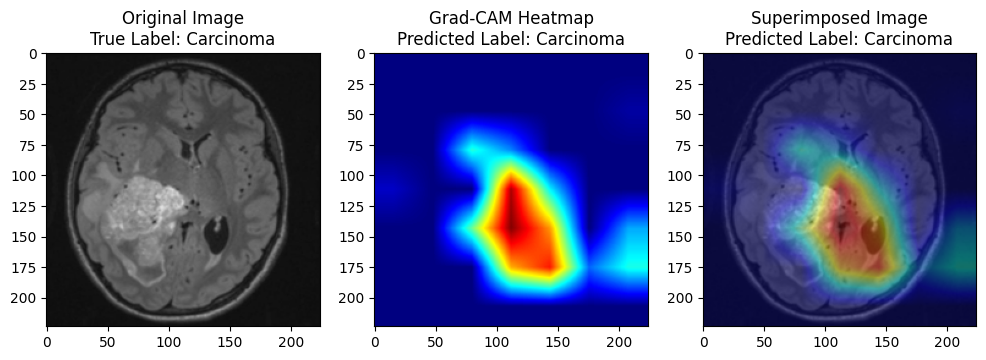

1/1 [==============================] - 0s 26ms/step


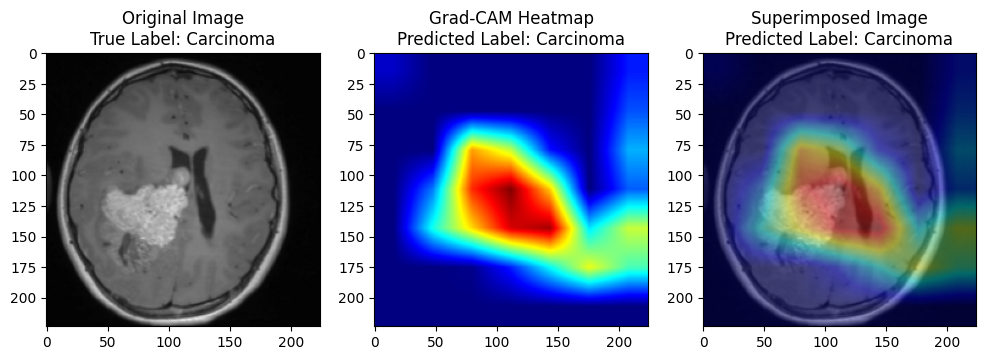

1/1 [==============================] - 0s 27ms/step


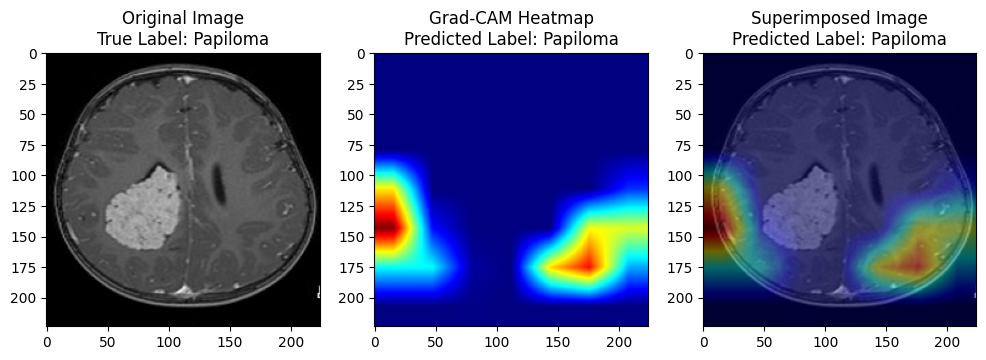

1/1 [==============================] - 0s 27ms/step


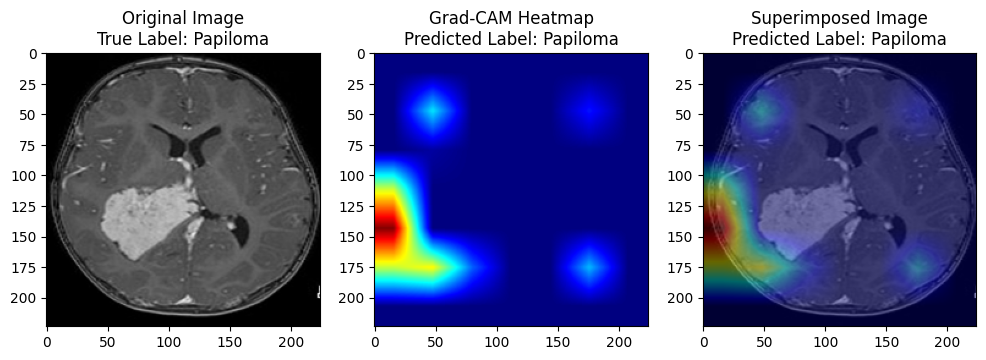

1/1 [==============================] - 0s 26ms/step


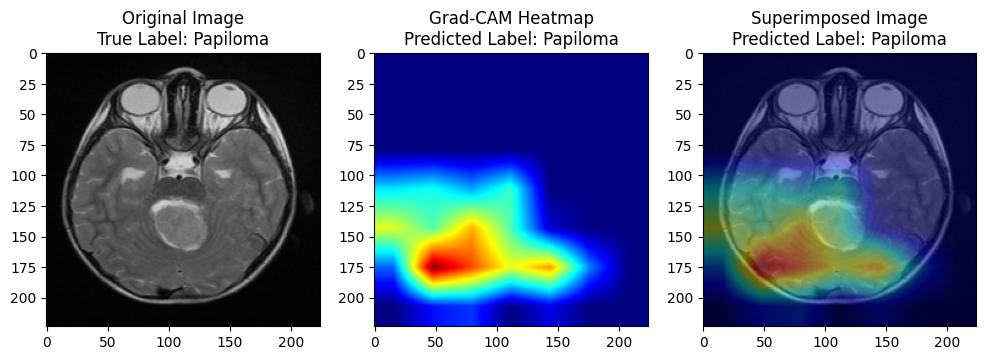

1/1 [==============================] - 0s 25ms/step


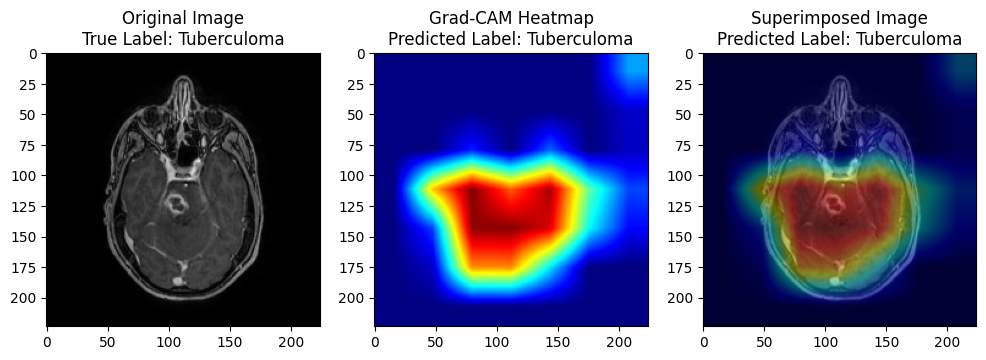

1/1 [==============================] - 0s 27ms/step


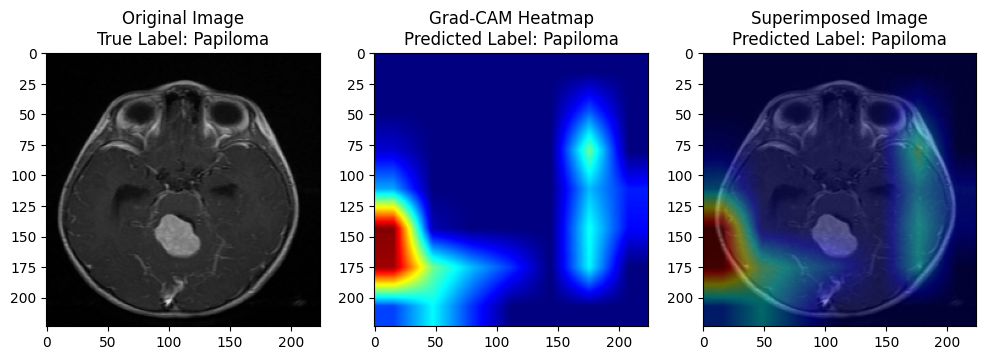

1/1 [==============================] - 0s 28ms/step


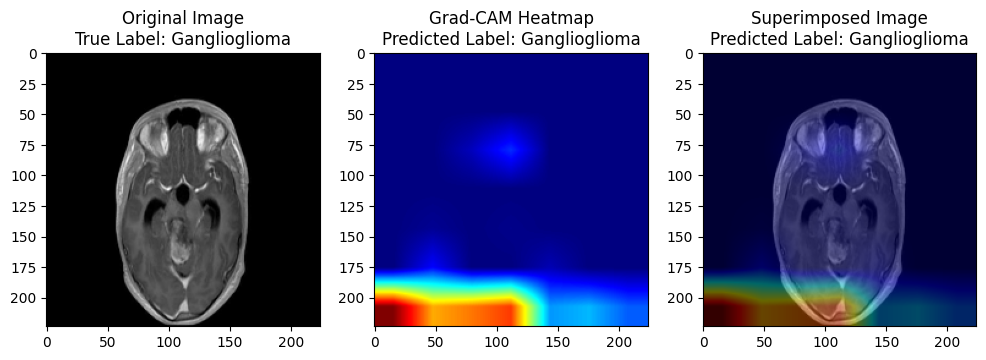

1/1 [==============================] - 0s 27ms/step


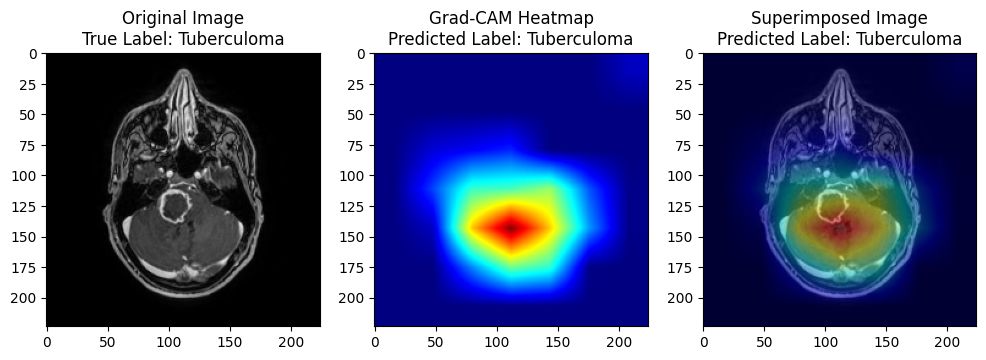

1/1 [==============================] - 0s 26ms/step


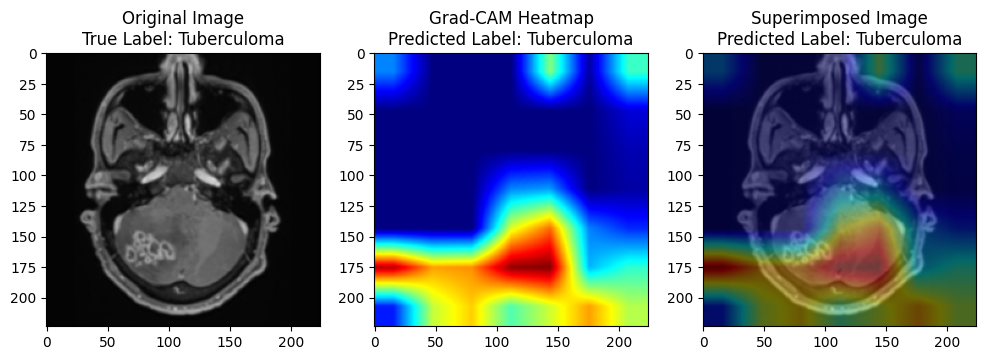

1/1 [==============================] - 0s 26ms/step


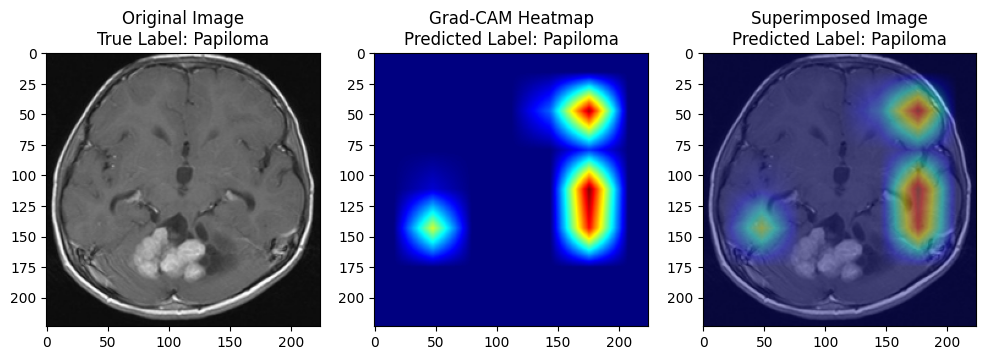

1/1 [==============================] - 0s 26ms/step


In [2]:
import cv2
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing import image
import matplotlib.pyplot as plt
import os
import random

# Load your pre-trained model
model_path = '/kaggle/working/effnetv2b0_multi_head_attention_dataset1.h5'
model = tf.keras.models.load_model(model_path, custom_objects={"Adamax": tf.keras.optimizers.Adamax})

# Function to load and preprocess an image
def load_and_preprocess_image(img_path):
    img = tf.keras.preprocessing.image.load_img(img_path, target_size=(224, 224))
    img = tf.keras.preprocessing.image.img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = tf.keras.applications.efficientnet_v2.preprocess_input(img)
    return img

# Load paths and labels from the directory
data_dir = "/kaggle/input/brain-tumor-mri-images-44c"
paths = []
labels = []
folds = os.listdir(data_dir)
for fold in folds:
    condition_path = os.path.join(data_dir, fold)
    all_pic = os.listdir(condition_path)
    for each_pic in all_pic:
        each_pic_path = os.path.join(condition_path, each_pic)
        paths.append(each_pic_path)
        labels.append(fold.split(' ')[0])

# Convert paths and labels to pandas Series
import pandas as pd
pseries = pd.Series(paths, name='Picture Path')
lseries = pd.Series(labels, name='Label')

# Filter and sample images for each label
all_imgs = []
for label in lseries.unique():
    label_imgs = pseries[lseries == label].tolist()
    sampled_imgs = random.sample(label_imgs, 10)
    all_imgs.extend(sampled_imgs)

random.shuffle(all_imgs)

# Function to generate Grad-CAM
def generate_gradcam(img_array, model, layer_name):
    grad_model = tf.keras.models.Model([model.inputs], [model.get_layer(layer_name).output, model.output])
    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        loss = predictions[:, np.argmax(predictions[0])]

    grads = tape.gradient(loss, conv_outputs)[0]
    weights = tf.reduce_mean(grads, axis=(0, 1))

    cam = np.zeros(conv_outputs.shape[1:3], dtype=np.float32)
    for i, w in enumerate(weights):
        cam += w * conv_outputs[0, :, :, i]

    cam = np.maximum(cam, 0)
    cam = cam / cam.max() if cam.max() != 0 else cam

    return cam

# Function to overlay Grad-CAM on image
def overlay_gradcam(img_path, cam):
    img = cv2.imread(img_path)
    img = cv2.resize(img, (224, 224))
    cam = cv2.resize(cam, (224, 224))  # Ensure the cam has the same size as the image
    heatmap = cv2.applyColorMap(np.uint8(255 * cam), cv2.COLORMAP_JET)
    heatmap = cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB)
    superimposed_img = cv2.addWeighted(img, 0.6, heatmap, 0.4, 0)
    return img, heatmap, superimposed_img

# Get unique labels
unique_labels = lseries.unique()

# Generate and plot Grad-CAM for each image
layer_name = 'top_conv'  # Adjust the layer name if necessary
for img_path in all_imgs:
    img_array = load_and_preprocess_image(img_path)
    cam = generate_gradcam(img_array, model, layer_name)
    img, heatmap, superimposed_img = overlay_gradcam(img_path, cam)
    
    # Get the true label for the image
    true_label = lseries[pseries == img_path].iloc[0]
    
    # Get the predicted label for the image
    preds = model.predict(img_array)
    predicted_class = np.argmax(preds[0])
    pred_class_name = unique_labels[predicted_class]
    
    # Only show images where predicted labels match true labels
    if true_label == pred_class_name:
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 3, 1)
        plt.title(f'Original Image\nTrue Label: {true_label}')
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        
        plt.subplot(1, 3, 2)
        plt.title(f'Grad-CAM Heatmap\nPredicted Label: {pred_class_name}')
        plt.imshow(heatmap)
        
        plt.subplot(1, 3, 3)
        plt.title(f'Superimposed Image\nPredicted Label: {pred_class_name}')
        plt.imshow(superimposed_img)
        
        plt.show()

### Dataset 2 - Grad-CAM Analysis

1/1 [==============================] - 0s 26ms/step


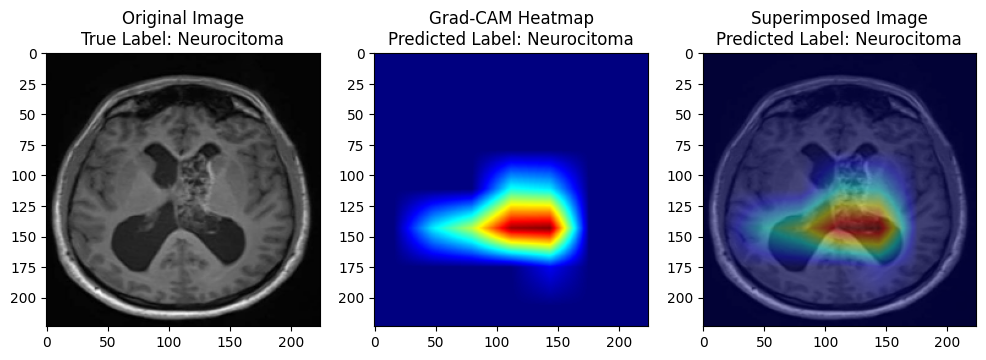

1/1 [==============================] - 0s 26ms/step


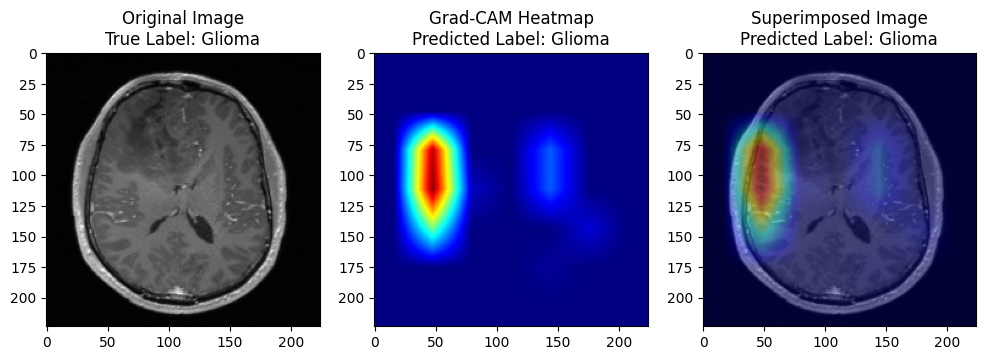

1/1 [==============================] - 0s 26ms/step


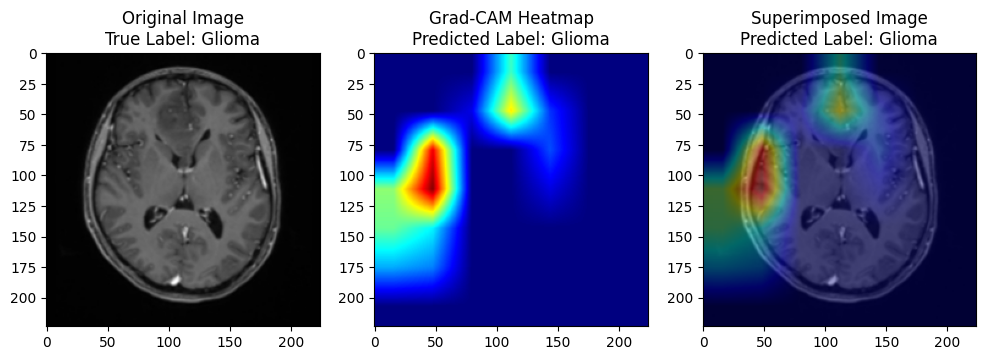

1/1 [==============================] - 0s 27ms/step


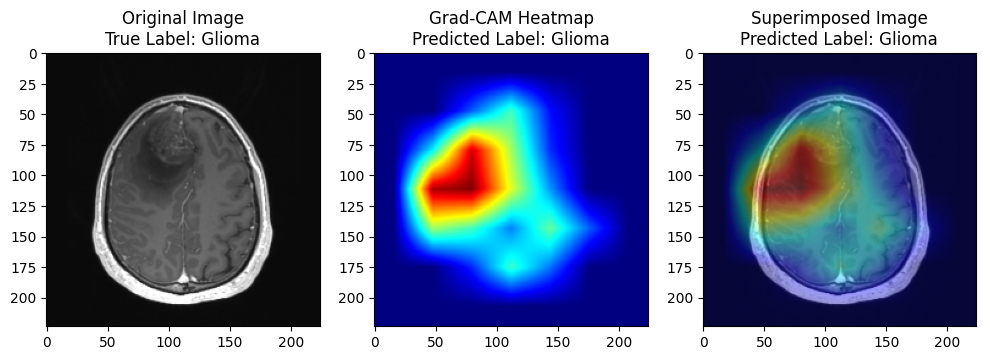

1/1 [==============================] - 0s 24ms/step


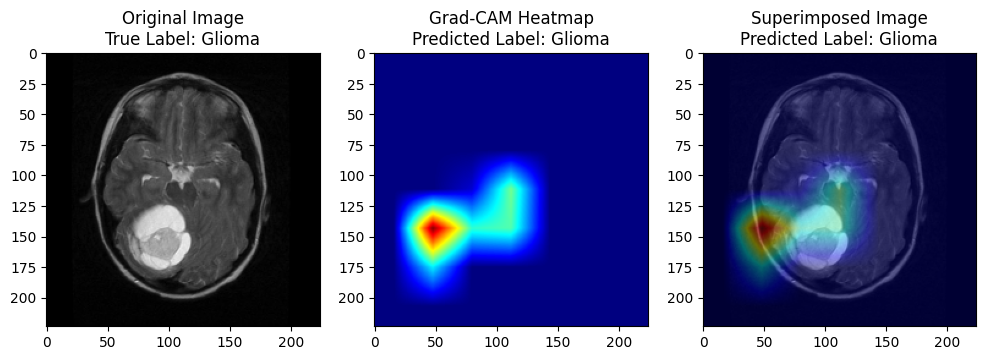

1/1 [==============================] - 0s 25ms/step


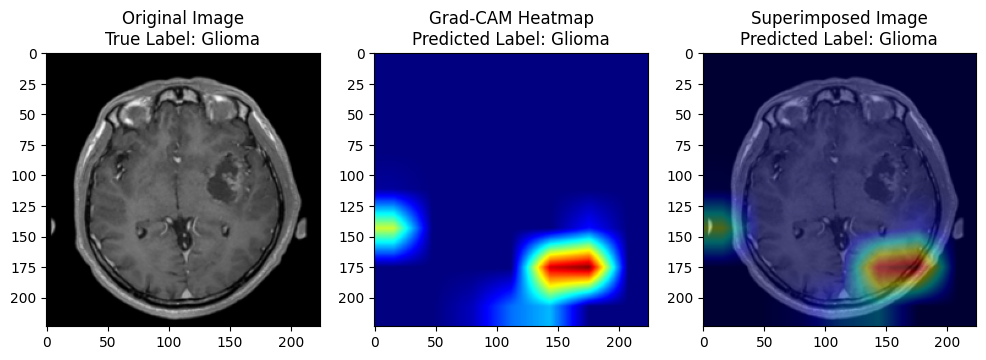

1/1 [==============================] - 0s 25ms/step


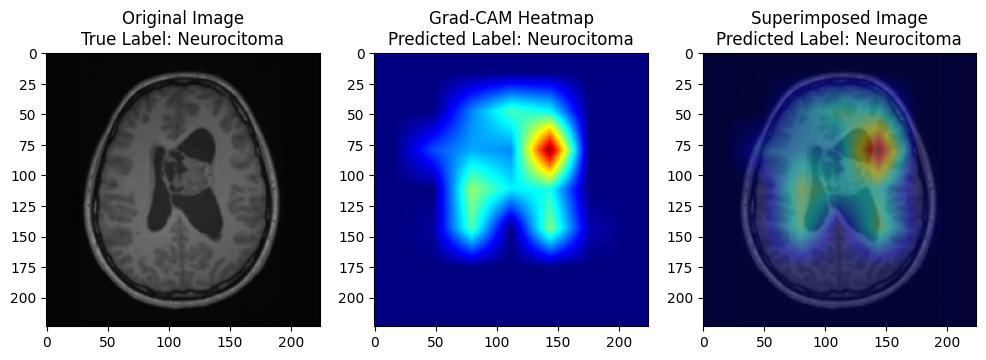

1/1 [==============================] - 0s 26ms/step


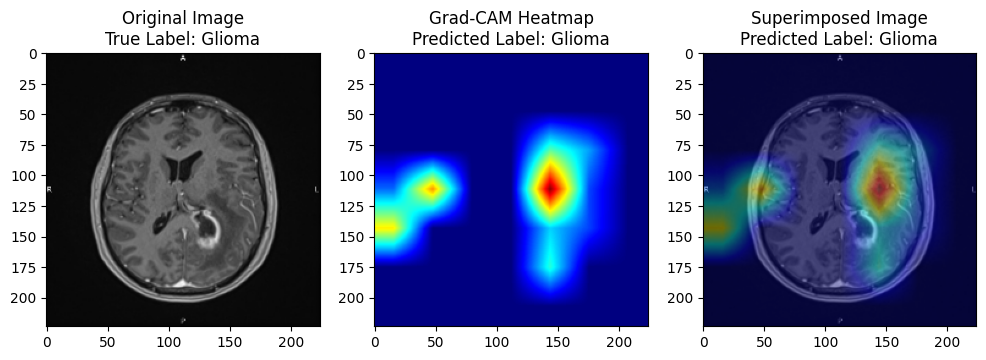

1/1 [==============================] - 0s 26ms/step


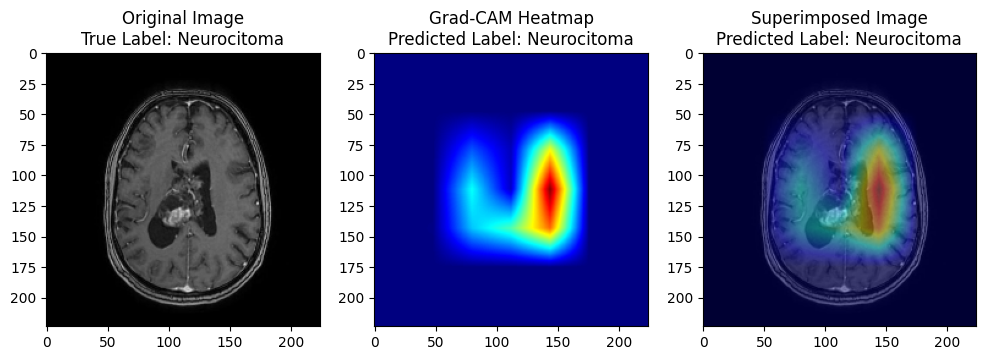

1/1 [==============================] - 0s 27ms/step


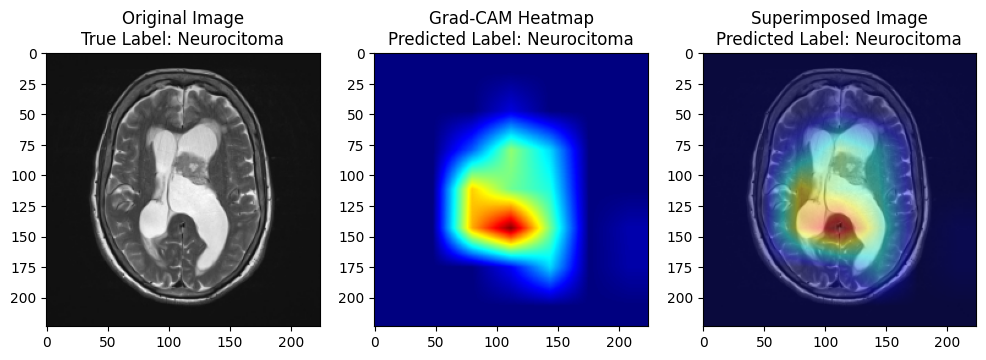

1/1 [==============================] - 0s 26ms/step


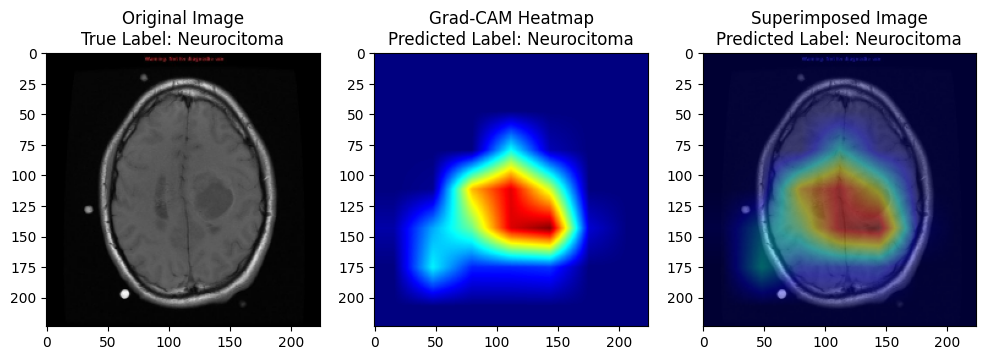

1/1 [==============================] - 0s 25ms/step


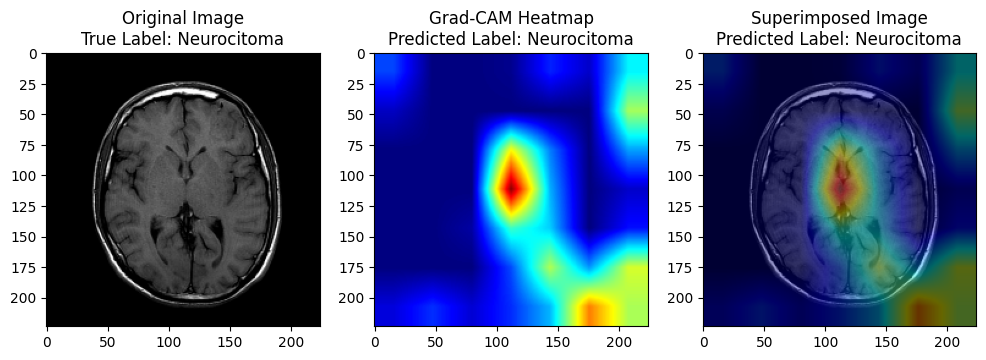

1/1 [==============================] - 0s 26ms/step


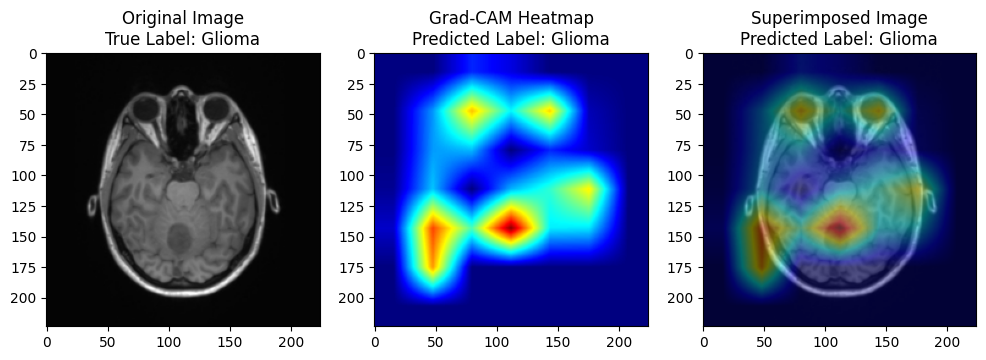

1/1 [==============================] - 0s 26ms/step


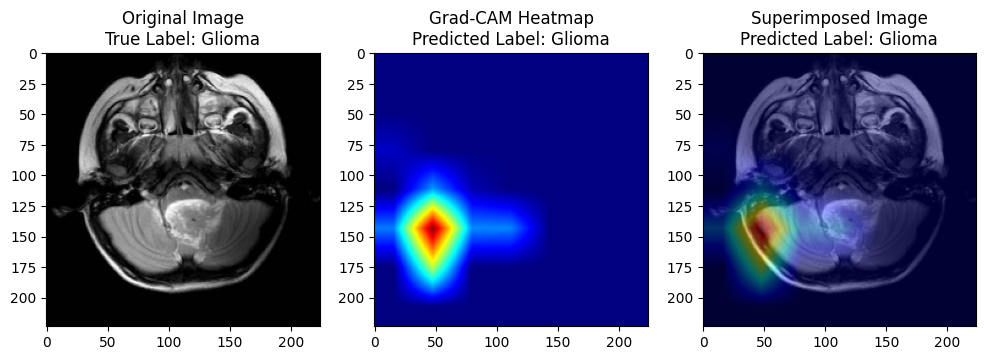

1/1 [==============================] - 0s 26ms/step


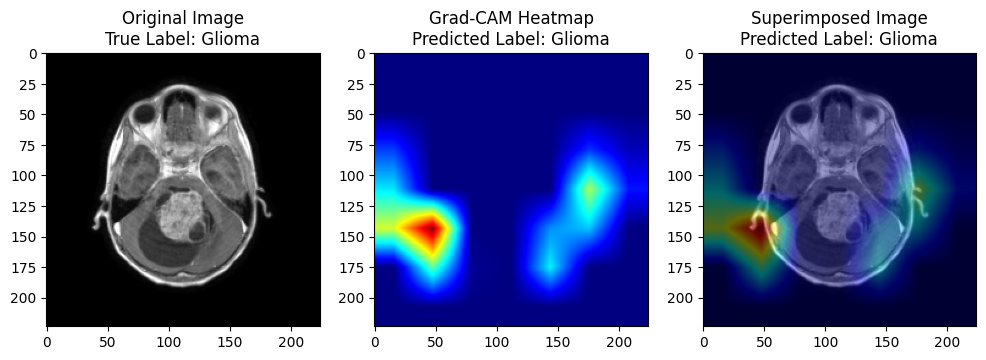

1/1 [==============================] - 0s 27ms/step


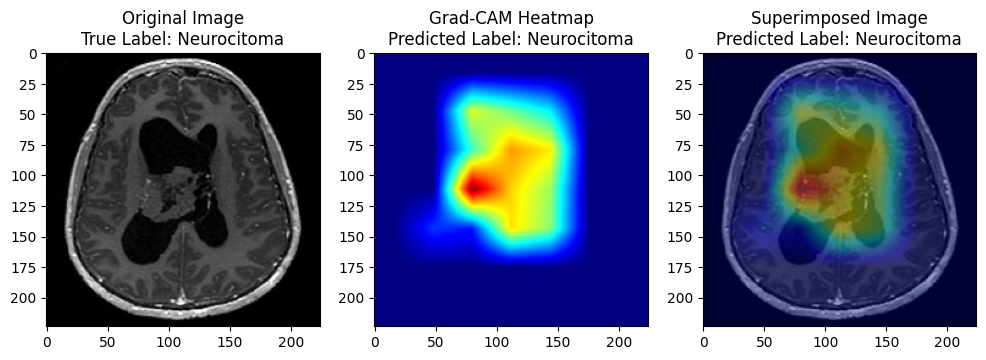

1/1 [==============================] - 0s 25ms/step


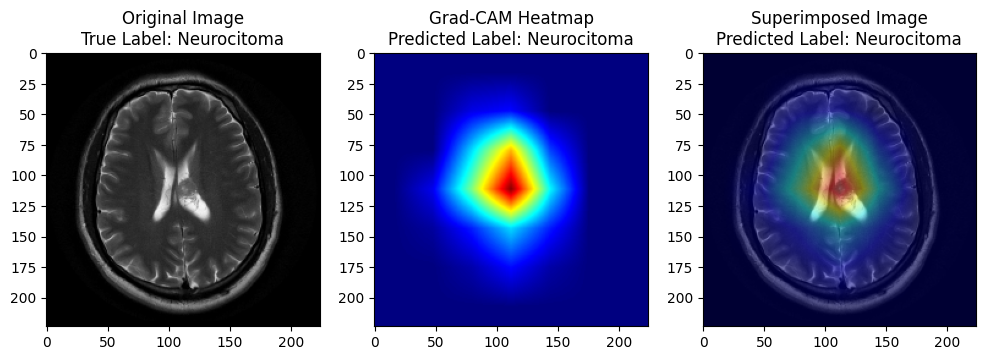

1/1 [==============================] - 0s 26ms/step


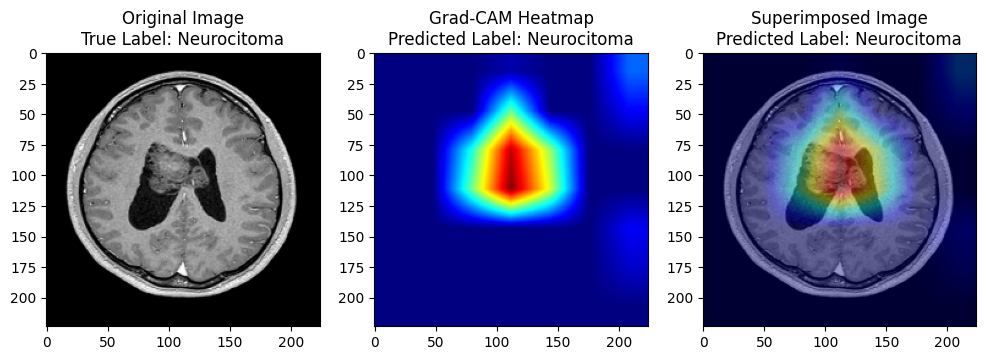

1/1 [==============================] - 0s 25ms/step


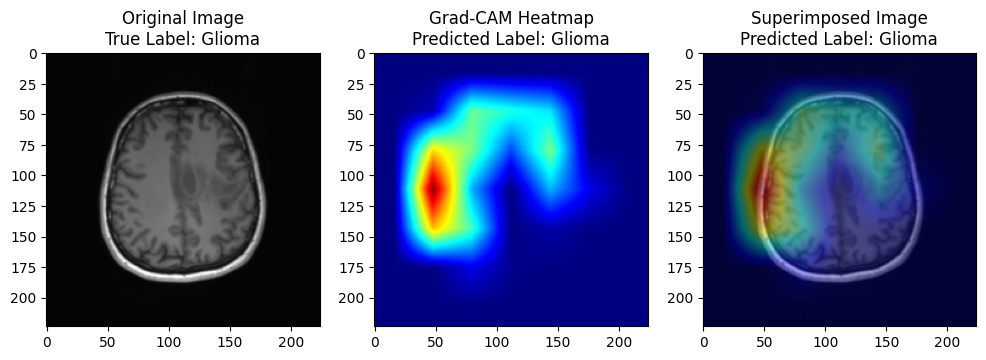

1/1 [==============================] - 0s 27ms/step


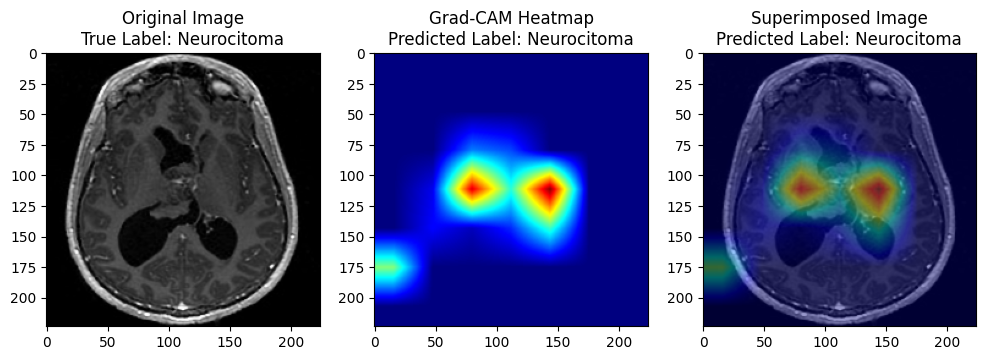

1/1 [==============================] - 0s 28ms/step


In [3]:
import cv2
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing import image
import matplotlib.pyplot as plt
import os
import random

# Load your pre-trained model
model_path = '/kaggle/working/effnetv2b0_multi_head_attention_dataset2.h5'
model = tf.keras.models.load_model(model_path, custom_objects={"Adamax": tf.keras.optimizers.Adamax})

# Function to load and preprocess an image
def load_and_preprocess_image(img_path):
    img = tf.keras.preprocessing.image.load_img(img_path, target_size=(224, 224))
    img = tf.keras.preprocessing.image.img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = tf.keras.applications.efficientnet_v2.preprocess_input(img)
    return img

# Load paths and labels from the directory
data_dir = "/kaggle/input/brain-tumor-mri-images-17-classes"
paths = []
labels = []
folds = os.listdir(data_dir)
for fold in folds:
    condition_path = os.path.join(data_dir, fold)
    all_pic = os.listdir(condition_path)
    for each_pic in all_pic:
        each_pic_path = os.path.join(condition_path, each_pic)
        paths.append(each_pic_path)
        labels.append(fold.split(' ')[0])

# Convert paths and labels to pandas Series
import pandas as pd
pseries = pd.Series(paths, name='Picture Path')
lseries = pd.Series(labels, name='Label')

# Filter and sample images for each label
all_imgs = []
for label in lseries.unique():
    label_imgs = pseries[lseries == label].tolist()
    sampled_imgs = random.sample(label_imgs, 10)
    all_imgs.extend(sampled_imgs)

random.shuffle(all_imgs)

# Function to generate Grad-CAM
def generate_gradcam(img_array, model, layer_name):
    grad_model = tf.keras.models.Model([model.inputs], [model.get_layer(layer_name).output, model.output])
    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        loss = predictions[:, np.argmax(predictions[0])]

    grads = tape.gradient(loss, conv_outputs)[0]
    weights = tf.reduce_mean(grads, axis=(0, 1))

    cam = np.zeros(conv_outputs.shape[1:3], dtype=np.float32)
    for i, w in enumerate(weights):
        cam += w * conv_outputs[0, :, :, i]

    cam = np.maximum(cam, 0)
    cam = cam / cam.max() if cam.max() != 0 else cam

    return cam

# Function to overlay Grad-CAM on image
def overlay_gradcam(img_path, cam):
    img = cv2.imread(img_path)
    img = cv2.resize(img, (224, 224))
    cam = cv2.resize(cam, (224, 224))  # Ensure the cam has the same size as the image
    heatmap = cv2.applyColorMap(np.uint8(255 * cam), cv2.COLORMAP_JET)
    heatmap = cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB)
    superimposed_img = cv2.addWeighted(img, 0.6, heatmap, 0.4, 0)
    return img, heatmap, superimposed_img

# Get unique labels
unique_labels = lseries.unique()

# Generate and plot Grad-CAM for each image
layer_name = 'top_conv'  # Adjust the layer name if necessary
for img_path in all_imgs:
    img_array = load_and_preprocess_image(img_path)
    cam = generate_gradcam(img_array, model, layer_name)
    img, heatmap, superimposed_img = overlay_gradcam(img_path, cam)
    
    # Get the true label for the image
    true_label = lseries[pseries == img_path].iloc[0]
    
    # Get the predicted label for the image
    preds = model.predict(img_array)
    predicted_class = np.argmax(preds[0])
    pred_class_name = unique_labels[predicted_class]
    
    # Only show images where predicted labels match true labels
    if true_label == pred_class_name:
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 3, 1)
        plt.title(f'Original Image\nTrue Label: {true_label}')
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        
        plt.subplot(1, 3, 2)
        plt.title(f'Grad-CAM Heatmap\nPredicted Label: {pred_class_name}')
        plt.imshow(heatmap)
        
        plt.subplot(1, 3, 3)
        plt.title(f'Superimposed Image\nPredicted Label: {pred_class_name}')
        plt.imshow(superimposed_img)
        
        plt.show()

## Dataset 3 - Only CT Scan

In [1]:
import os
import shutil

# Paths to the original folders
ct_healthy = "/kaggle/input/brain-tumor-multimodal-image-ct-and-mri/Dataset/Brain Tumor CT scan Images/Healthy"
ct_tumor = "/kaggle/input/brain-tumor-multimodal-image-ct-and-mri/Dataset/Brain Tumor CT scan Images/Tumor"

# New directories
base_dir = "/kaggle/working/CT_Dataset"
healthy_dir = os.path.join(base_dir, "Healthy")
tumor_dir = os.path.join(base_dir, "Tumor")

# Create directories
os.makedirs(healthy_dir, exist_ok=True)
os.makedirs(tumor_dir, exist_ok=True)

# Function to copy files
def copy_files(src_dir, dst_dir):
    for filename in os.listdir(src_dir):
        src_file = os.path.join(src_dir, filename)
        dst_file = os.path.join(dst_dir, filename)
        if os.path.isfile(src_file):
            shutil.copy(src_file, dst_file)

# Copy files to the new directories
copy_files(ct_healthy, healthy_dir)
copy_files(ct_tumor, tumor_dir)

print("Files have been organized into CT_Dataset/Healthy and CT_Dataset/Tumor directories successfully!")

Files have been organized into CT_Dataset/Healthy and CT_Dataset/Tumor directories successfully!


In [2]:
!pip install imutils

import numpy as np
from tqdm import tqdm
import cv2
import os
import imutils

def crop_img(img):
    """
    Finds the extreme points on the image and crops the rectangular out of them
    """
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    gray = cv2.GaussianBlur(gray, (3, 3), 0)

    # find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(gray.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)

    # find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    ADD_PIXELS = 0
    new_img = img[extTop[1]-ADD_PIXELS:extBot[1]+ADD_PIXELS, extLeft[0]-ADD_PIXELS:extRight[0]+ADD_PIXELS].copy()

    return new_img

if __name__ == "__main__":
    training = "/kaggle/working/CT_Dataset"
    training_dir = os.listdir(training)
    IMG_SIZE = 224

    for dir in training_dir:
        save_path = '/kaggle/working/cleaned_ct/'+ dir
        path = os.path.join(training,dir)
        image_dir = os.listdir(path)
        for img in image_dir:
            image = cv2.imread(os.path.join(path,img))
            new_img = crop_img(image)
            new_img = cv2.resize(new_img,(IMG_SIZE,IMG_SIZE))
            if not os.path.exists(save_path):
                os.makedirs(save_path)
            cv2.imwrite(save_path+'/'+img, new_img)

  Preparing metadata (setup.py) ... done
  Created wheel for imutils: filename=imutils-0.5.4-py3-none-any.whl size=25834 sha256=abca7d07230bd9c2a1e5ac71b4c471b9d1ff39019367679ed3ea8d41ef494c46
  Stored in directory: /root/.cache/pip/wheels/85/cf/3a/e265e975a1e7c7e54eb3692d6aa4e2e7d6a3945d29da46f2d7
Successfully built imutils


2025-02-06 06:04:40.054176: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-02-06 06:04:40.054290: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-02-06 06:04:40.176345: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


Modules Successfully Loaded


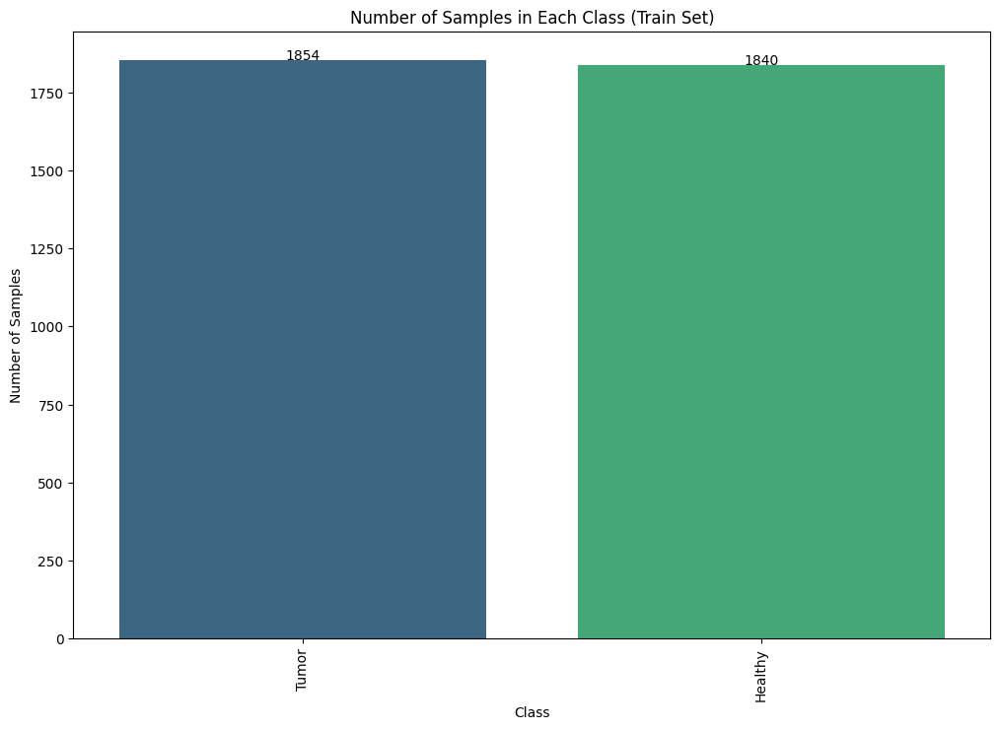

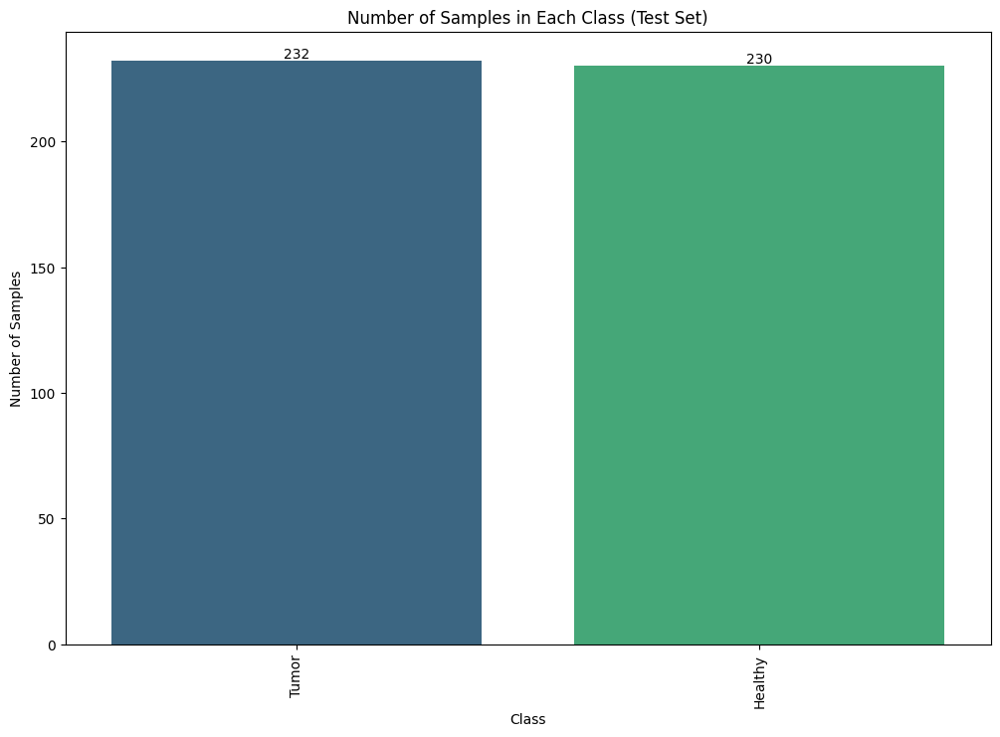

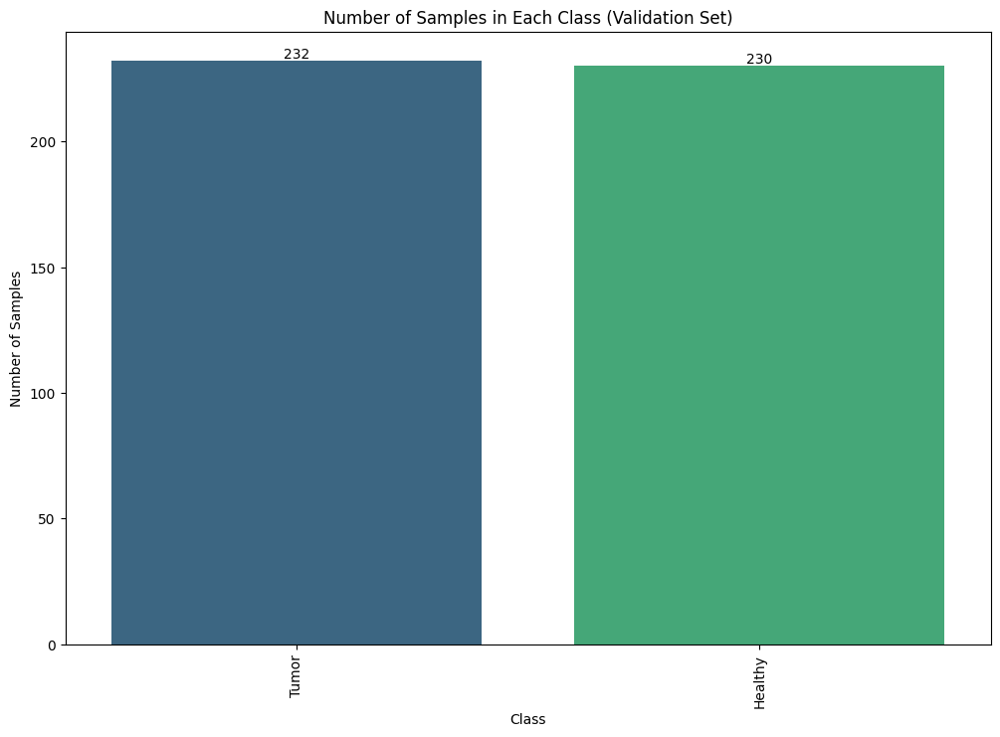

Found 3694 validated image filenames belonging to 2 classes.
Found 462 validated image filenames belonging to 2 classes.
Found 462 validated image filenames belonging to 2 classes.


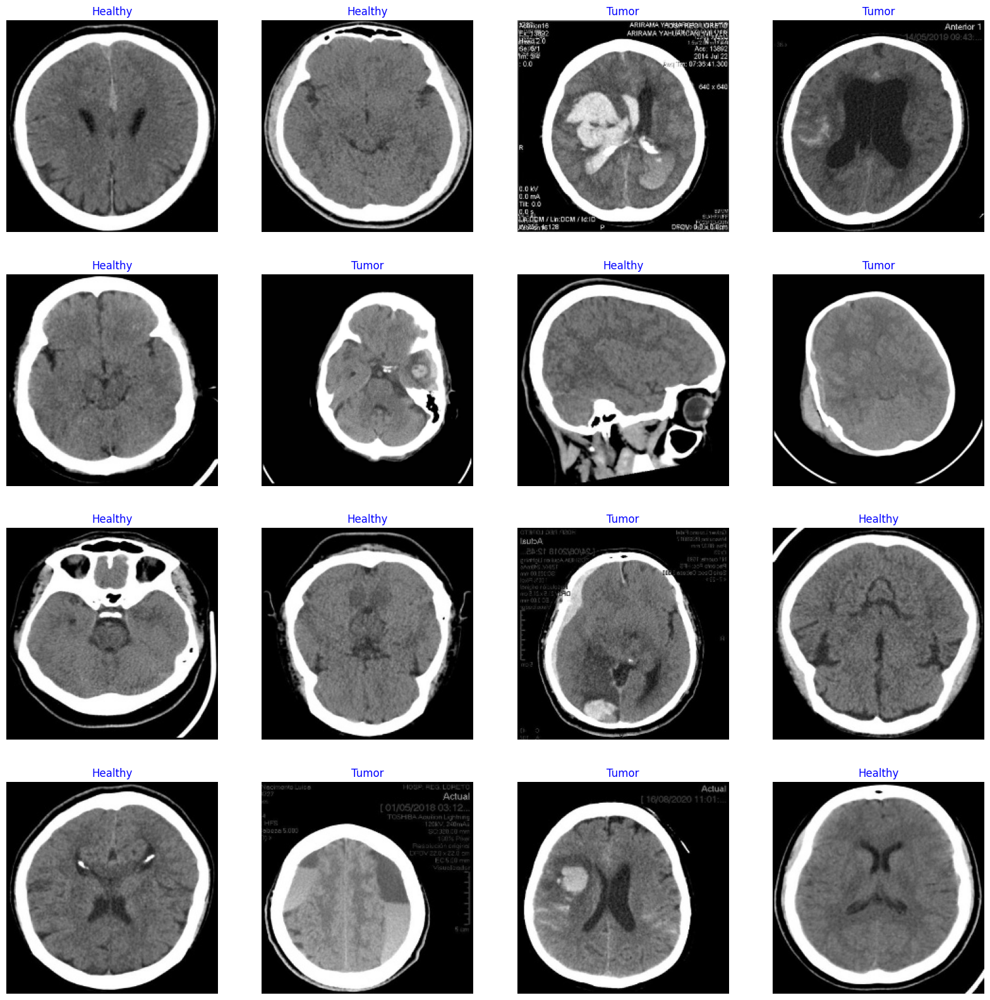

Using GPU
24274472/24274472 [==============================] - 0s 0us/step
Epoch 1/10


2025-02-06 06:05:11.618172: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inModel_with_Attention/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer
I0000 00:00:1738821917.803059     132 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


231/231 [==============================] - 70s 137ms/step - loss: 5.2020 - accuracy: 0.9153 - val_loss: 4.4951 - val_accuracy: 0.9329
Epoch 2/10
231/231 [==============================] - 28s 120ms/step - loss: 3.8470 - accuracy: 0.9567 - val_loss: 3.2938 - val_accuracy: 0.9784
Epoch 3/10
231/231 [==============================] - 28s 119ms/step - loss: 2.8793 - accuracy: 0.9716 - val_loss: 2.4512 - val_accuracy: 0.9827
Epoch 4/10
231/231 [==============================] - 27s 119ms/step - loss: 2.1374 - accuracy: 0.9794 - val_loss: 1.8283 - val_accuracy: 0.9784
Epoch 5/10
231/231 [==============================] - 28s 119ms/step - loss: 1.5992 - accuracy: 0.9808 - val_loss: 1.3685 - val_accuracy: 0.9762
Epoch 6/10
231/231 [==============================] - 28s 119ms/step - loss: 1.2006 - accuracy: 0.9862 - val_loss: 1.0387 - val_accuracy: 0.9870
Epoch 7/10
231/231 [==============================] - 27s 119ms/step - loss: 0.9247 - accuracy: 0.9881 - val_loss: 0.8223 - val_accuracy: 0.9

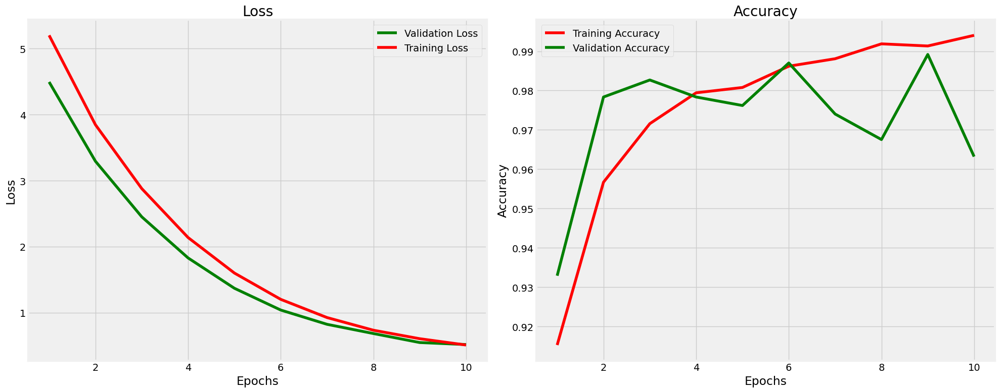

29/29 [==============================] - 1s 34ms/step - loss: 0.4954 - accuracy: 0.9762
Train Loss:  0.4668894112110138
Train Accuracy:  0.9870059490203857
--------------------
Valid Loss:  0.515789806842804
Valid Accuracy:  0.963203489780426
--------------------
Test Loss:  0.49536556005477905
Test Accuracy:  0.976190447807312


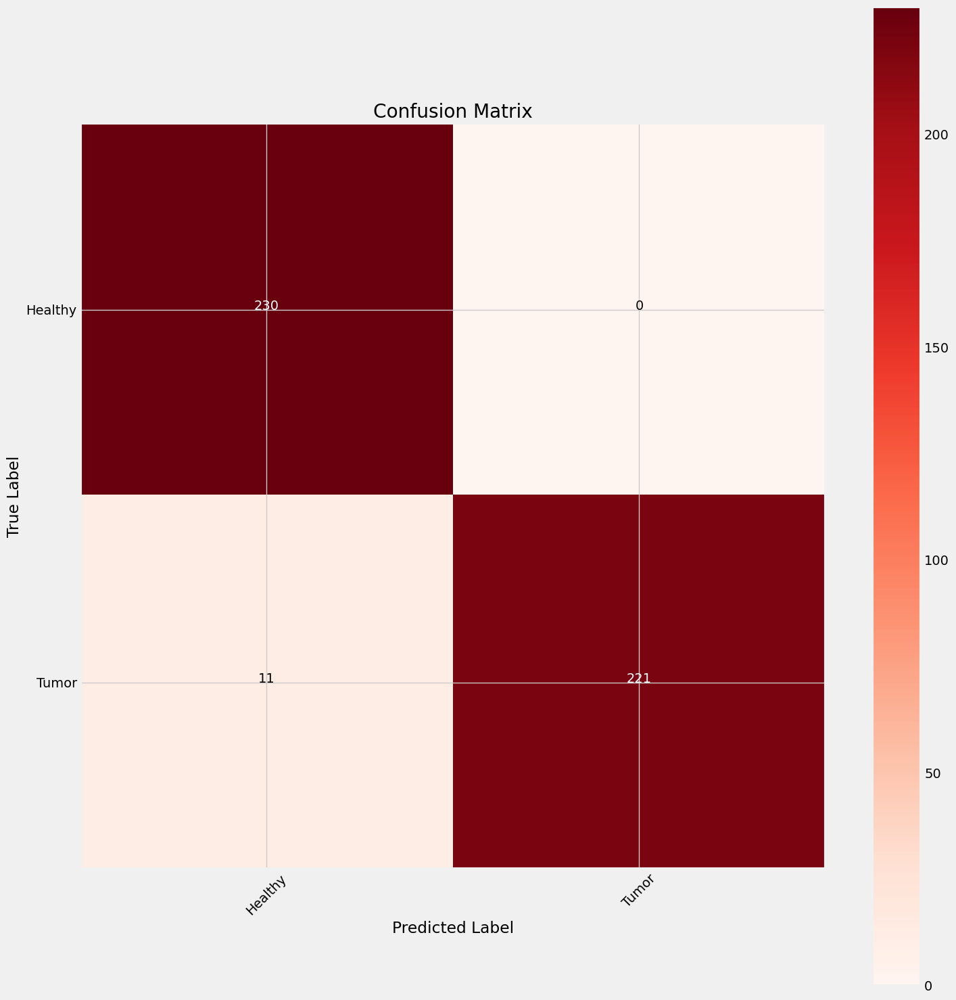

              precision    recall  f1-score   support

     Healthy       0.95      1.00      0.98       230
       Tumor       1.00      0.95      0.98       232

    accuracy                           0.98       462
   macro avg       0.98      0.98      0.98       462
weighted avg       0.98      0.98      0.98       462



In [5]:
import os
from PIL import Image
import itertools
from tqdm import tqdm
import cv2
import numpy as np 
import pandas as pd 
import seaborn as sn
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import regularizers
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam, Adamax
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import Dense, Flatten, Conv2D, MaxPooling2D, Activation, Dropout,BatchNormalization

import warnings
warnings.filterwarnings('ignore')

print('Modules Successfully Loaded')

data_dir ="/kaggle/working/cleaned_ct"
paths = []
labels = []
folds = os.listdir(data_dir)
for fold in folds :
    condition_path = os.path.join(data_dir,fold)
    all_pic = os.listdir(condition_path)
    for each_pic in all_pic:
        each_pic_path = os.path.join(condition_path,each_pic)
        paths.append(each_pic_path)
        labels.append(fold.split(' ')[0])
        
pseries = pd.Series(paths, name='Picture Path')
lseries = pd.Series(labels, name='Label')

df = pd.concat([pseries, lseries], axis =1)

train_df, ts_df = train_test_split(df,test_size= 0.2,shuffle=True,random_state=42,stratify= df['Label'])
test_df, valid_df = train_test_split(ts_df,test_size= 0.5,shuffle=True,random_state=42,
                                          stratify= ts_df['Label'])

import matplotlib.pyplot as plt
import seaborn as sns

# Function to plot class distribution with numbers on top of the bars and vertical labels
def plot_class_distribution(df, title):
    class_counts = df['Label'].value_counts()
    plt.figure(figsize=(12, 8))
    
    sns.barplot(x=class_counts.index, y=class_counts.values, palette="viridis")
    plt.title(title)
    plt.xlabel('Class')
    plt.ylabel('Number of Samples')
    
    # Rotate class labels vertically
    plt.xticks(rotation=90)
    
    # Add number labels on top of bars
    for i in range(len(class_counts)):
        plt.text(i, class_counts.values[i] + 1, str(class_counts.values[i]), ha='center')
    
    plt.show()

# Plot class distributions for train_df, test_df, and valid_df
plot_class_distribution(train_df, 'Number of Samples in Each Class (Train Set)')
plot_class_distribution(test_df, 'Number of Samples in Each Class (Test Set)')
plot_class_distribution(valid_df, 'Number of Samples in Each Class (Validation Set)')

batch_size = 16
img_size = (224,224)

gen = ImageDataGenerator()

train_gen = gen.flow_from_dataframe(train_df, x_col='Picture Path', y_col='Label',target_size= img_size, 
                                   class_mode= 'categorical', color_mode='rgb', shuffle = True,
                                   batch_size= batch_size)

valid_gen = gen.flow_from_dataframe(valid_df, x_col='Picture Path', y_col='Label',target_size= img_size, 
                                   class_mode= 'categorical', color_mode='rgb', shuffle = True,
                                   batch_size= batch_size)

test_gen = gen.flow_from_dataframe(test_df, x_col='Picture Path', y_col='Label',target_size= img_size, 
                                   class_mode= 'categorical', color_mode='rgb', shuffle = False,
                                   batch_size= batch_size)
g_dict = train_gen.class_indices
classes= list(g_dict.keys())

images, labels = next(train_gen)

plt.figure(figsize= (20,20))

for i in range (16):
    plt.subplot(4,4,i+1)
    image = images[i] / 255
    plt.imshow(image)
    index= np.argmax(labels[i]) #[0,0,0,1,0]
    class_name = classes[index]
    plt.title(class_name,c='b', fontsize=12)
    plt.axis('off')
plt.show()

import tensorflow as tf
from tensorflow.keras import layers, models, regularizers
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.applications import EfficientNetV2B0
from tensorflow.keras.models import Model
from tensorflow.keras.layers import (
    GlobalAveragePooling2D, Dense, Dropout,
    BatchNormalization, Input,
    MultiHeadAttention, Reshape
)
from tensorflow.keras.optimizers import Adamax

# Check if GPU is available
physical_devices = tf.config.list_physical_devices('GPU')
if physical_devices:
    print("Using GPU")
else:
    print("Using CPU")

# Early stopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

def create_model(input_shape, num_classes=2, learning_rate=0.0001):
    inputs = Input(shape=input_shape, name="Input_Layer")
    
    base_model = EfficientNetV2B0(weights='imagenet', input_tensor=inputs, include_top=False)
    
    x = base_model.output
    height, width, channels = x.shape[1], x.shape[2], x.shape[3]
    
    x = Reshape((height * width, channels), name="Reshape_to_Sequence")(x)
    
    attention_output = MultiHeadAttention(num_heads=8, key_dim=channels, name="Multi_Head_Attention")(x, x)
    
    attention_output = Reshape((height, width, channels), name="Reshape_to_Spatial")(attention_output)
    
    x = GlobalAveragePooling2D(name="Global_Avg_Pooling")(attention_output)
    x = Dense(512, activation='relu', name="FC_512")(x)
    x = BatchNormalization(axis=-1, momentum=0.99, epsilon=0.001, name="Batch_Normalization")(x)
    x = Dense(256, kernel_regularizer=regularizers.l2(0.016), activity_regularizer=regularizers.l1(0.006),
              bias_regularizer=regularizers.l1(0.006), activation='relu', name="FC_256")(x)
    x = Dropout(0.45, seed=123, name="Dropout")(x)
    
    outputs = Dense(num_classes, activation='sigmoid', name="Output_Layer")(x)
    
    model = Model(inputs=inputs, outputs=outputs, name="Model_with_Attention")
    model.compile(optimizer=Adamax(learning_rate=learning_rate), loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

input_shape = (224, 224, 3)
model = create_model(input_shape, num_classes=2, learning_rate=0.0001)

hist= model.fit(train_gen, epochs= 10, callbacks = [early_stopping],
                verbose= 1, validation_data= valid_gen, shuffle= False)

tr_acc = hist.history['accuracy']
tr_loss = hist.history['loss']
val_acc = hist.history['val_accuracy']
val_loss = hist.history['val_loss']

index_acc = np.argmax(val_acc)
index_loss = np.argmin(val_loss)

val_lowest=val_loss[index_loss]
acc_highest=val_acc[index_acc]

epochs = [i+1 for i in range(len(tr_acc))]

loss_label = f'best epoch = {str(index_loss+1)}'
acc_label =  f'best epoch = {str(index_acc+1)} '

plt.figure(figsize= (20,8))
plt.style.use('fivethirtyeight')

plt.subplot(1,2,1)
plt.plot(epochs,val_loss,c='g',label= 'Validation Loss')
plt.plot(epochs,tr_loss,c='r',label= 'Training Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.title('Loss')

plt.subplot(1,2,2)
plt.plot(epochs, tr_acc, c='r', label= 'Training Accuracy')
plt.plot(epochs, val_acc, c='g', label= 'Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.title('Accuracy')

plt.tight_layout()
plt.show()

train_score= model.evaluate(train_gen)
valid_score= model.evaluate(valid_gen)
test_score=  model.evaluate(test_gen)

print("Train Loss: ", train_score[0])
print("Train Accuracy: ", train_score[1])
print('-' * 20)
print("Valid Loss: ", valid_score[0])
print("Valid Accuracy: ", valid_score[1])
print('-' * 20)
print("Test Loss: ", test_score[0])
print("Test Accuracy: ", test_score[1])

preds = model.predict_generator(test_gen)
y_pred= np.argmax(preds,axis=1)

g_dict = test_gen.class_indices
classes = list(g_dict.keys())

# Confusion matrix
cm = confusion_matrix(test_gen.classes, y_pred)

plt.figure(figsize= (15, 15))
plt.imshow(cm, interpolation= 'nearest', cmap= plt.cm.Reds)
plt.title('Confusion Matrix')
plt.colorbar()

tick_marks = np.arange(len(classes))
plt.xticks(tick_marks, classes, rotation= 45)
plt.yticks(tick_marks, classes)


thresh = cm.max() / 2.
for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])): #(5,5)
    plt.text(j, i, cm[i, j], horizontalalignment= 'center', color= 'white' if cm[i, j] > thresh else 'black')
    
plt.tight_layout()
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.show()

from sklearn.metrics import classification_report
# Display classification report
print(classification_report(test_gen.classes, y_pred, target_names=classes))

## Dataset 3 - Only MRI

Files have been organized into MRI_Dataset/Healthy and MRI_Dataset/Tumor directories successfully!
Modules Successfully Loaded


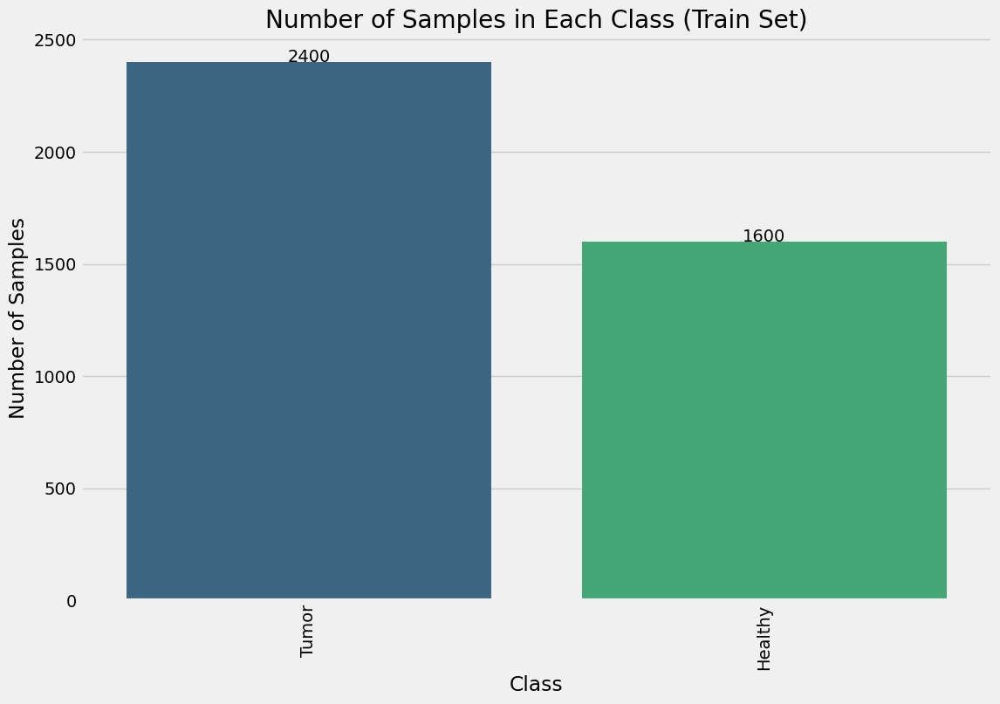

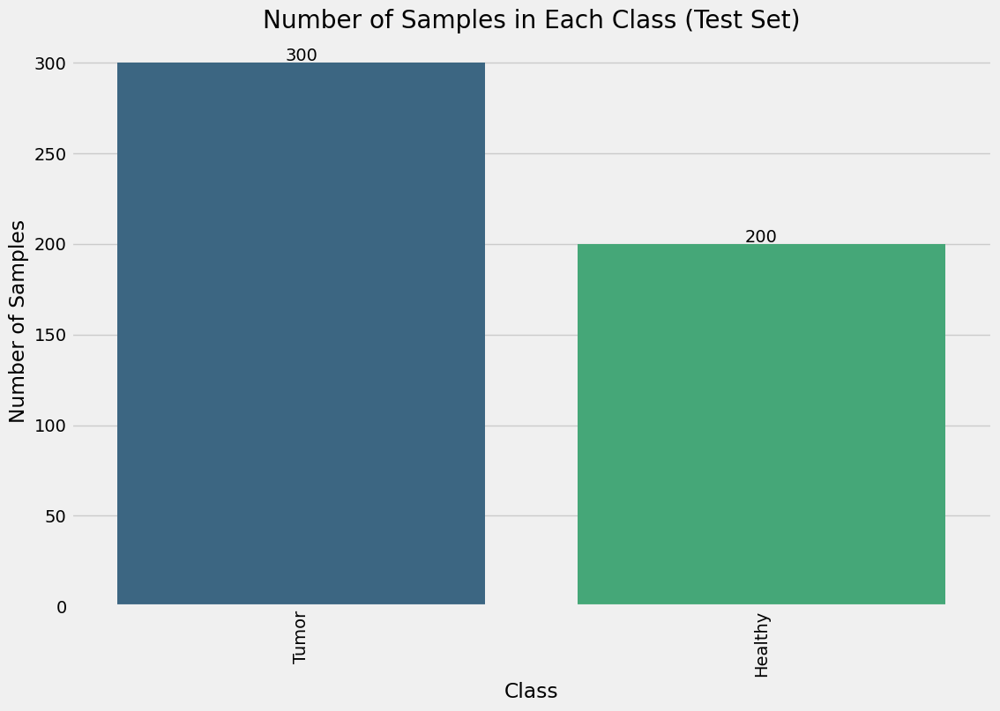

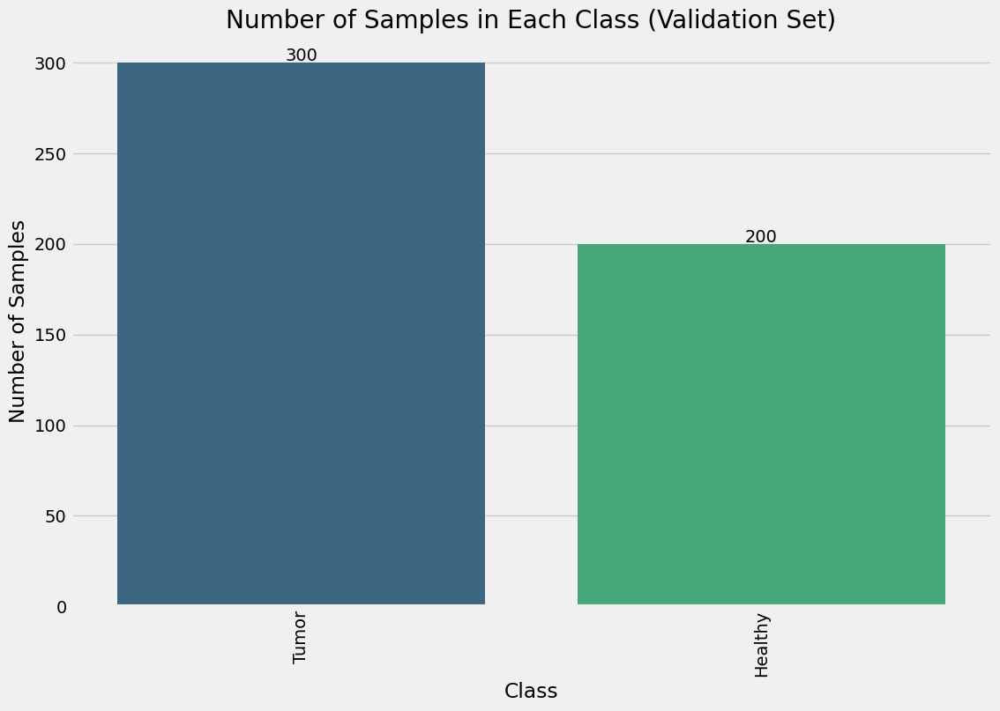

Found 4000 validated image filenames belonging to 2 classes.
Found 500 validated image filenames belonging to 2 classes.
Found 500 validated image filenames belonging to 2 classes.


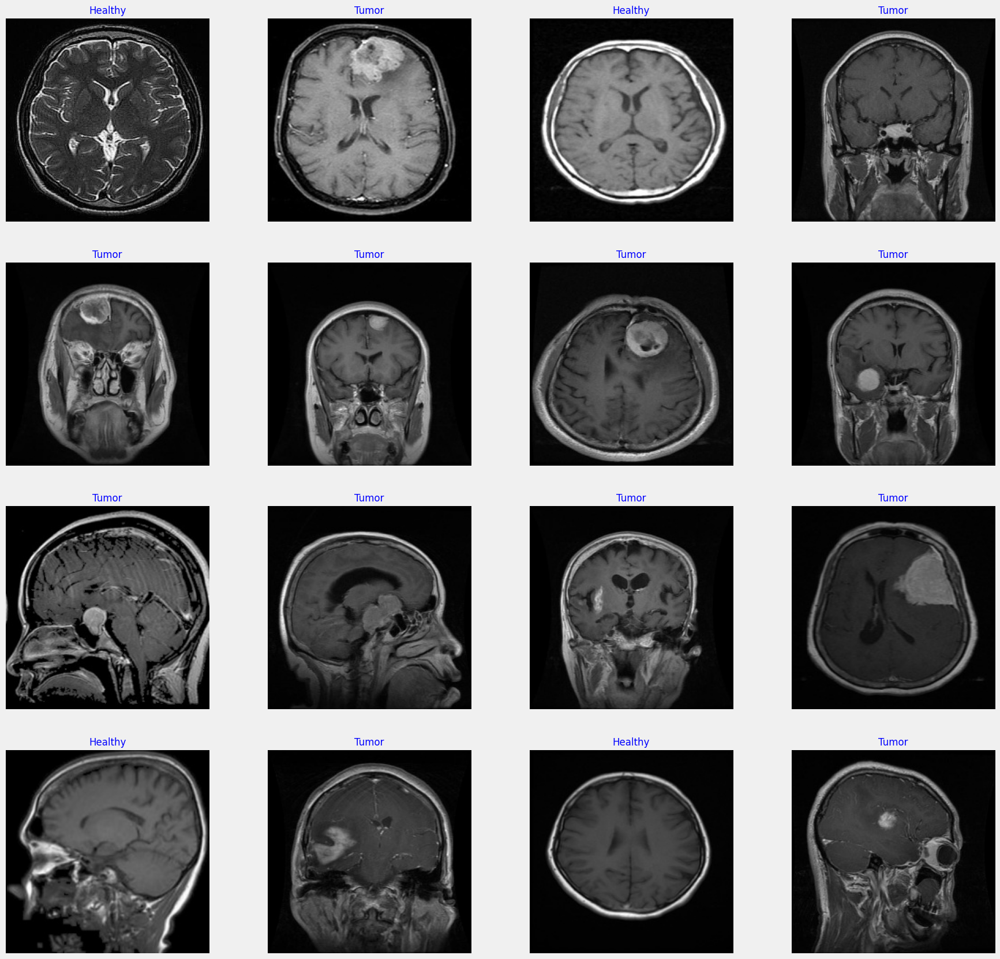

Using GPU
Epoch 1/10


2025-02-06 06:12:35.945785: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inModel_with_Attention/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


250/250 [==============================] - 62s 130ms/step - loss: 5.0983 - accuracy: 0.9430 - val_loss: 4.3613 - val_accuracy: 0.9840
Epoch 2/10
250/250 [==============================] - 30s 120ms/step - loss: 3.6675 - accuracy: 0.9772 - val_loss: 3.0875 - val_accuracy: 0.9920
Epoch 3/10
250/250 [==============================] - 30s 120ms/step - loss: 2.6448 - accuracy: 0.9865 - val_loss: 2.2137 - val_accuracy: 0.9940
Epoch 4/10
250/250 [==============================] - 30s 120ms/step - loss: 1.9088 - accuracy: 0.9860 - val_loss: 1.5948 - val_accuracy: 0.9920
Epoch 5/10
250/250 [==============================] - 30s 120ms/step - loss: 1.3825 - accuracy: 0.9877 - val_loss: 1.1565 - val_accuracy: 0.9920
Epoch 6/10
250/250 [==============================] - 30s 120ms/step - loss: 1.0099 - accuracy: 0.9942 - val_loss: 0.8441 - val_accuracy: 0.9960
Epoch 7/10
250/250 [==============================] - 30s 120ms/step - loss: 0.7541 - accuracy: 0.9925 - val_loss: 0.6409 - val_accuracy: 0.9

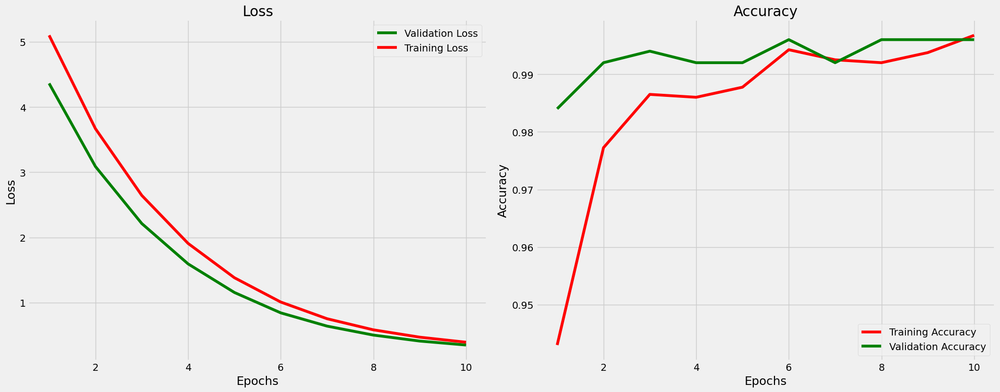

32/32 [==============================] - 1s 35ms/step - loss: 0.3447 - accuracy: 1.0000
Train Loss:  0.3457883298397064
Train Accuracy:  0.9987499713897705
--------------------
Valid Loss:  0.35097259283065796
Valid Accuracy:  0.9959999918937683
--------------------
Test Loss:  0.34472745656967163
Test Accuracy:  1.0


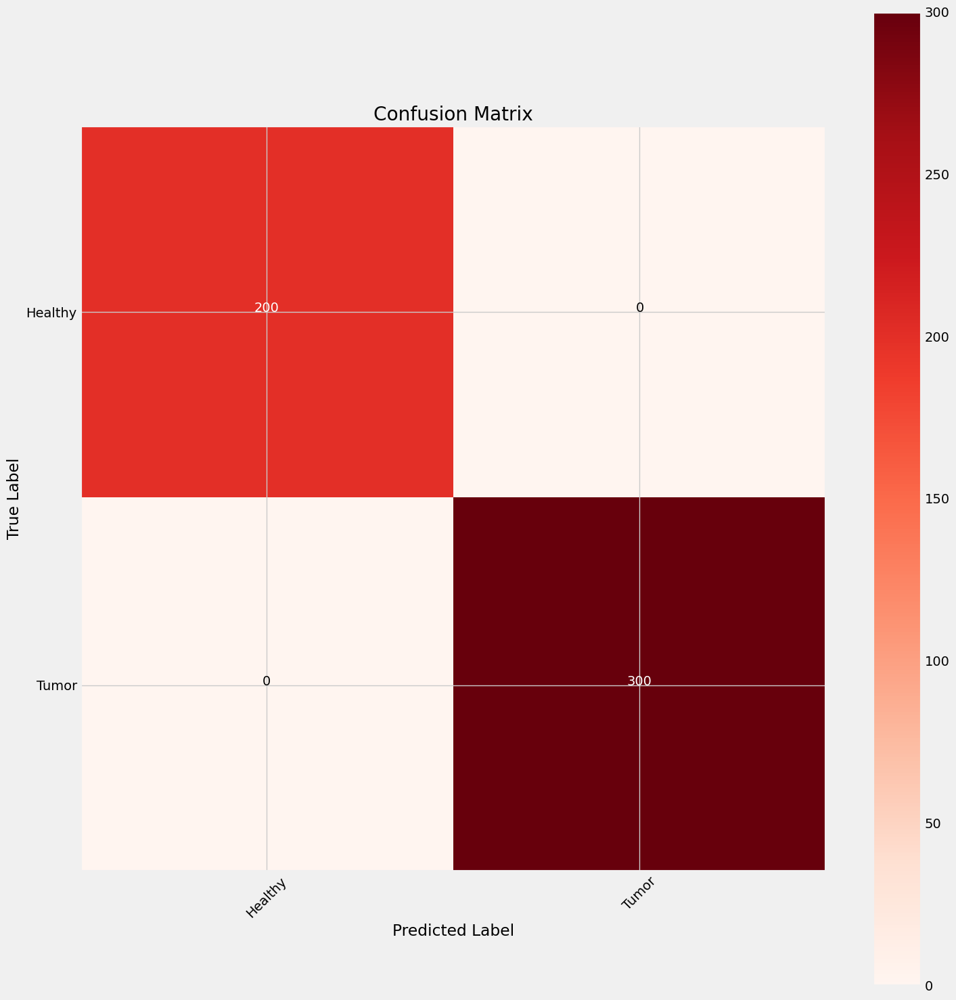

              precision    recall  f1-score   support

     Healthy       1.00      1.00      1.00       200
       Tumor       1.00      1.00      1.00       300

    accuracy                           1.00       500
   macro avg       1.00      1.00      1.00       500
weighted avg       1.00      1.00      1.00       500



In [6]:
import os
import shutil

# Paths to the original folders
mri_healthy = "/kaggle/input/brain-tumor-multimodal-image-ct-and-mri/Dataset/Brain Tumor MRI images/Healthy"
mri_tumor = "/kaggle/input/brain-tumor-multimodal-image-ct-and-mri/Dataset/Brain Tumor MRI images/Tumor"

# New directories
base_dir = "/kaggle/working/MRI_Dataset"
healthy_dir = os.path.join(base_dir, "Healthy")
tumor_dir = os.path.join(base_dir, "Tumor")

# Create directories
os.makedirs(healthy_dir, exist_ok=True)
os.makedirs(tumor_dir, exist_ok=True)

# Function to copy files
def copy_files(src_dir, dst_dir):
    for filename in os.listdir(src_dir):
        src_file = os.path.join(src_dir, filename)
        dst_file = os.path.join(dst_dir, filename)
        if os.path.isfile(src_file):
            shutil.copy(src_file, dst_file)

# Copy files to the new directories
copy_files(mri_healthy, healthy_dir)
copy_files(mri_tumor, tumor_dir)

print("Files have been organized into MRI_Dataset/Healthy and MRI_Dataset/Tumor directories successfully!")

!pip install imutils

import numpy as np
from tqdm import tqdm
import cv2
import os
import imutils

def crop_img(img):
    """
    Finds the extreme points on the image and crops the rectangular out of them
    """
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    gray = cv2.GaussianBlur(gray, (3, 3), 0)

    # find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(gray.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)

    # find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    ADD_PIXELS = 0
    new_img = img[extTop[1]-ADD_PIXELS:extBot[1]+ADD_PIXELS, extLeft[0]-ADD_PIXELS:extRight[0]+ADD_PIXELS].copy()

    return new_img

if __name__ == "__main__":
    training = "/kaggle/working/MRI_Dataset"
    training_dir = os.listdir(training)
    IMG_SIZE = 224

    for dir in training_dir:
        save_path = '/kaggle/working/cleaned_mri/'+ dir
        path = os.path.join(training,dir)
        image_dir = os.listdir(path)
        for img in image_dir:
            image = cv2.imread(os.path.join(path,img))
            new_img = crop_img(image)
            new_img = cv2.resize(new_img,(IMG_SIZE,IMG_SIZE))
            if not os.path.exists(save_path):
                os.makedirs(save_path)
            cv2.imwrite(save_path+'/'+img, new_img)

import os
from PIL import Image
import itertools
from tqdm import tqdm
import cv2
import numpy as np 
import pandas as pd 
import seaborn as sn
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import regularizers
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam, Adamax
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import Dense, Flatten, Conv2D, MaxPooling2D, Activation, Dropout,BatchNormalization

import warnings
warnings.filterwarnings('ignore')

print('Modules Successfully Loaded')

data_dir ="/kaggle/working/cleaned_mri"
paths = []
labels = []
folds = os.listdir(data_dir)
for fold in folds :
    condition_path = os.path.join(data_dir,fold)
    all_pic = os.listdir(condition_path)
    for each_pic in all_pic:
        each_pic_path = os.path.join(condition_path,each_pic)
        paths.append(each_pic_path)
        labels.append(fold.split(' ')[0])
        
pseries = pd.Series(paths, name='Picture Path')
lseries = pd.Series(labels, name='Label')

df = pd.concat([pseries, lseries], axis =1)

train_df, ts_df = train_test_split(df,test_size= 0.2,shuffle=True,random_state=42,stratify= df['Label'])
test_df, valid_df = train_test_split(ts_df,test_size= 0.5,shuffle=True,random_state=42,
                                          stratify= ts_df['Label'])

import matplotlib.pyplot as plt
import seaborn as sns

# Function to plot class distribution with numbers on top of the bars and vertical labels
def plot_class_distribution(df, title):
    class_counts = df['Label'].value_counts()
    plt.figure(figsize=(12, 8))
    
    sns.barplot(x=class_counts.index, y=class_counts.values, palette="viridis")
    plt.title(title)
    plt.xlabel('Class')
    plt.ylabel('Number of Samples')
    
    # Rotate class labels vertically
    plt.xticks(rotation=90)
    
    # Add number labels on top of bars
    for i in range(len(class_counts)):
        plt.text(i, class_counts.values[i] + 1, str(class_counts.values[i]), ha='center')
    
    plt.show()

# Plot class distributions for train_df, test_df, and valid_df
plot_class_distribution(train_df, 'Number of Samples in Each Class (Train Set)')
plot_class_distribution(test_df, 'Number of Samples in Each Class (Test Set)')
plot_class_distribution(valid_df, 'Number of Samples in Each Class (Validation Set)')

batch_size = 16
img_size = (224,224)

gen = ImageDataGenerator()

train_gen = gen.flow_from_dataframe(train_df, x_col='Picture Path', y_col='Label',target_size= img_size, 
                                   class_mode= 'categorical', color_mode='rgb', shuffle = True,
                                   batch_size= batch_size)

valid_gen = gen.flow_from_dataframe(valid_df, x_col='Picture Path', y_col='Label',target_size= img_size, 
                                   class_mode= 'categorical', color_mode='rgb', shuffle = True,
                                   batch_size= batch_size)

test_gen = gen.flow_from_dataframe(test_df, x_col='Picture Path', y_col='Label',target_size= img_size, 
                                   class_mode= 'categorical', color_mode='rgb', shuffle = False,
                                   batch_size= batch_size)
g_dict = train_gen.class_indices
classes= list(g_dict.keys())

images, labels = next(train_gen)

plt.figure(figsize= (20,20))

for i in range (16):
    plt.subplot(4,4,i+1)
    image = images[i] / 255
    plt.imshow(image)
    index= np.argmax(labels[i]) #[0,0,0,1,0]
    class_name = classes[index]
    plt.title(class_name,c='b', fontsize=12)
    plt.axis('off')
plt.show()

import tensorflow as tf
from tensorflow.keras import layers, models, regularizers
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.applications import EfficientNetV2B0
from tensorflow.keras.models import Model
from tensorflow.keras.layers import (
    GlobalAveragePooling2D, Dense, Dropout,
    BatchNormalization, Input,
    MultiHeadAttention, Reshape
)
from tensorflow.keras.optimizers import Adamax

# Check if GPU is available
physical_devices = tf.config.list_physical_devices('GPU')
if physical_devices:
    print("Using GPU")
else:
    print("Using CPU")

# Early stopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

def create_model(input_shape, num_classes=2, learning_rate=0.0001):
    inputs = Input(shape=input_shape, name="Input_Layer")
    
    base_model = EfficientNetV2B0(weights='imagenet', input_tensor=inputs, include_top=False)
    
    x = base_model.output
    height, width, channels = x.shape[1], x.shape[2], x.shape[3]
    
    x = Reshape((height * width, channels), name="Reshape_to_Sequence")(x)
    
    attention_output = MultiHeadAttention(num_heads=8, key_dim=channels, name="Multi_Head_Attention")(x, x)
    
    attention_output = Reshape((height, width, channels), name="Reshape_to_Spatial")(attention_output)
    
    x = GlobalAveragePooling2D(name="Global_Avg_Pooling")(attention_output)
    x = Dense(512, activation='relu', name="FC_512")(x)
    x = BatchNormalization(axis=-1, momentum=0.99, epsilon=0.001, name="Batch_Normalization")(x)
    x = Dense(256, kernel_regularizer=regularizers.l2(0.016), activity_regularizer=regularizers.l1(0.006),
              bias_regularizer=regularizers.l1(0.006), activation='relu', name="FC_256")(x)
    x = Dropout(0.45, seed=123, name="Dropout")(x)
    
    outputs = Dense(num_classes, activation='sigmoid', name="Output_Layer")(x)
    
    model = Model(inputs=inputs, outputs=outputs, name="Model_with_Attention")
    model.compile(optimizer=Adamax(learning_rate=learning_rate), loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

input_shape = (224, 224, 3)
model = create_model(input_shape, num_classes=2, learning_rate=0.0001)

hist= model.fit(train_gen, epochs= 10, callbacks = [early_stopping],
                verbose= 1, validation_data= valid_gen, shuffle= False)

tr_acc = hist.history['accuracy']
tr_loss = hist.history['loss']
val_acc = hist.history['val_accuracy']
val_loss = hist.history['val_loss']

index_acc = np.argmax(val_acc)
index_loss = np.argmin(val_loss)

val_lowest=val_loss[index_loss]
acc_highest=val_acc[index_acc]

epochs = [i+1 for i in range(len(tr_acc))]

loss_label = f'best epoch = {str(index_loss+1)}'
acc_label =  f'best epoch = {str(index_acc+1)} '

plt.figure(figsize= (20,8))
plt.style.use('fivethirtyeight')

plt.subplot(1,2,1)
plt.plot(epochs,val_loss,c='g',label= 'Validation Loss')
plt.plot(epochs,tr_loss,c='r',label= 'Training Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.title('Loss')

plt.subplot(1,2,2)
plt.plot(epochs, tr_acc, c='r', label= 'Training Accuracy')
plt.plot(epochs, val_acc, c='g', label= 'Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.title('Accuracy')

plt.tight_layout()
plt.show()

train_score= model.evaluate(train_gen)
valid_score= model.evaluate(valid_gen)
test_score=  model.evaluate(test_gen)

print("Train Loss: ", train_score[0])
print("Train Accuracy: ", train_score[1])
print('-' * 20)
print("Valid Loss: ", valid_score[0])
print("Valid Accuracy: ", valid_score[1])
print('-' * 20)
print("Test Loss: ", test_score[0])
print("Test Accuracy: ", test_score[1])

preds = model.predict_generator(test_gen)
y_pred= np.argmax(preds,axis=1)

g_dict = test_gen.class_indices
classes = list(g_dict.keys())

# Confusion matrix
cm = confusion_matrix(test_gen.classes, y_pred)

plt.figure(figsize= (15, 15))
plt.imshow(cm, interpolation= 'nearest', cmap= plt.cm.Reds)
plt.title('Confusion Matrix')
plt.colorbar()

tick_marks = np.arange(len(classes))
plt.xticks(tick_marks, classes, rotation= 45)
plt.yticks(tick_marks, classes)


thresh = cm.max() / 2.
for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])): #(5,5)
    plt.text(j, i, cm[i, j], horizontalalignment= 'center', color= 'white' if cm[i, j] > thresh else 'black')
    
plt.tight_layout()
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.show()

from sklearn.metrics import classification_report
# Display classification report
print(classification_report(test_gen.classes, y_pred, target_names=classes))